# Approximate Graph Propagation for single pollutant species in the LAQN

# Imports

In [338]:
import numpy as np
import scipy
import pandas as pd
import requests
from os import makedirs, path, listdir, remove
from bs4 import BeautifulSoup, SoupStrainer
import zipfile as zpf
from shutil import rmtree
import matplotlib.pyplot as plt
from scipy.spatial.distance import squareform, pdist, cosine
from sklearn.metrics.pairwise import cosine_similarity
from scipy.optimize import minimize
import matplotlib
from matplotlib import cm
from datetime import datetime

import httplib2
import geopandas as gpd
from tqdm import tqdm
from typing import Tuple, List, Optional, Union

from graph_utils import *


## Load LAQN Data

In [579]:
species = "NO2"
region = "London"
start_date = "1996-01-01"
end_date = "2021-01-01"
data_folder = "/Users/michellewan/Library/CloudStorage/OneDrive-UniversityofCambridge/Documents/PhD/MEng_Kevin/Data and code"
data_filename = f"LAQN_{species}_{start_date}_{end_date}.csv"

In [399]:
# # Load LAQN data
# laqn_df = pd.read_csv(path.join(data_folder, data_filename), index_col="date", infer_datetime_format=True)
# print(laqn_df.shape)

In [400]:
# # Load map file
# folder = "/Users/michellewan/Library/CloudStorage/OneDrive-UniversityofCambridge/Documents/PhD/MEng_Kevin/Data and code/Andrea_data/shape_files/london_boroughs"
# london_boroughs_gdf = gpd.read_file(path.join(folder, "london_boroughs_coordinates.shp"))
# #london_gdf = london_boroughs_gdf.dissolve()
# print(london_boroughs_gdf.shape)
# # london_boroughs_gdf.plot()
# # plt.show()

In [401]:
# # Load LAQN metadata
# folder = "/Users/michellewan/Library/CloudStorage/OneDrive-UniversityofCambridge/Documents/PhD/MEng_Kevin/Data and code/Andrea_data/shape_files/LAQN_sites"
# london_sites_gdf = gpd.read_file(path.join(folder, "LAQN_sites.shp"))
# print(london_sites_gdf.shape)
# # london_sites_gdf.plot()
# # plt.show() 
# # print(london_sites_gdf.head())

# Imputation of missing data

## Testing on a complete subset

In [580]:
data = Dataset(path.join(data_folder, data_filename))
grouped = data.group('D')
print("Daily data shape:", grouped.shape)

Daily data shape: (9133, 201)


Cut off date at the end of 2019 – to avoid the COVID-19 pandemic:

In [581]:
# Splitting the dataframe
df_before_2020 = grouped.loc[grouped.index < '2020-01-01']
df_from_2020_onwards = grouped.loc[grouped.index >= '2020-01-01']

In [582]:
complete_subset, column_names = get_complete_subset(df_before_2020, num_valid_values=500)
print("Complete subset shape:", complete_subset.shape)
print("Stations:", column_names)
print(complete_subset.index.min(), complete_subset.index.max())

Complete subset shape: (500, 22)
Stations: Index(['BG3', 'BX2', 'BX4', 'CT3', 'CT6', 'CR5', 'EN4', 'GN0', 'GR7', 'GB6',
       'GN2', 'GR5', 'HR2', 'KC4', 'LB1', 'LB3', 'RI2', 'ST6', 'TH4', 'TH2',
       'WM0', 'MY1'],
      dtype='object')
2008-12-03 00:00:00 2010-04-16 00:00:00


Create a test set from a different time window, with the same stations as the training set:

In [428]:
# # Try a separate test set

# complete_subset_test = get_custom_subset(df_before_2020, column_names, num_valid_values=100)
# print("Complete test subset shape:", complete_subset_test.shape)
# print(complete_subset_test.index.min(), complete_subset_test.index.max())

Create a train/test split of 80:20:

In [583]:
training_proportion = 0.8
train_set = complete_subset.iloc[:int(complete_subset.shape[0] * training_proportion), :]
test_set = complete_subset.iloc[int(complete_subset.shape[0] * training_proportion):, :]
print("Train set shape:", train_set.shape)
print("Test set shape:", test_set.shape)

Train set shape: (400, 22)
Test set shape: (100, 22)


Introduce missing values into the training and testing subsets:

In [430]:
gap_proportion = 0.2 # Proportion of missing entries

gap_indices_train, true_values_train, subset_train = introduce_gaps(train_set, num_missing_entries=int((train_set.shape[0]*train_set.shape[1])*gap_proportion), seed=0)
gap_indices_test, true_values_test, subset_test = introduce_gaps(test_set, num_missing_entries=int((test_set.shape[0]*test_set.shape[1])*gap_proportion), seed=0)

## Baseline methods

Filling with station annual mean values:

In [431]:
# Group by year and fill NaN values with the mean of each group
filled_data = subset_test.groupby(subset_test.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

# Drop the additional "year" index created by groupby
filled_data.reset_index(level='year', drop=True, inplace=True)

# Extract only the estimated values for NaN indices
estimated_values = [filled_data.iloc[idx[0], idx[1]] for idx in gap_indices_test]

# Compute error
print(f"RMSE test set error after filling {species} with station annual means:", rmse_error(true_values_test, estimated_values))
print(f"SMAPE test set error after filling {species} with station annual means:", smape_error(true_values_test, estimated_values))

RMSE test set error after filling PM10 with station annual means: 10.703000602739074
SMAPE test set error after filling PM10 with station annual means: 0.27196324010599177


Filling by interpolation:

In [432]:
print("Test set errors after filling with polynomial interpolation:")

for order in range(1, 4):
    filled_data = subset_test.interpolate(method='polynomial', order=order, axis=0)

    # Check if there are still NaN values after interpolation
    remaining_gaps = filled_data.isna().sum().sum()

    if remaining_gaps > 0:
        print(f"Applying fill with annual mean concentrations for {remaining_gaps} remaining NaN values.")
        
        # Group by year and fill NaN values with the mean of each group
        filled_data = filled_data.groupby(filled_data.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

        # Drop the additional "year" index created by groupby
        filled_data.reset_index(level='year', drop=True, inplace=True)

    # Extract only the estimated values for NaN indices
    estimated_values = [filled_data.iloc[idx[0], idx[1]] for idx in gap_indices_test]

    # Compute error for each method and print the results
    print(f"Order {order} RMSE: {rmse_error(true_values_test, estimated_values)}")
    print(f"Order {order} SMAPE: {smape_error(true_values_test, estimated_values)}")

    # # Set the figure size before creating the plot
    # plt.figure(figsize=(12, 6))

    # # Plot each column of the DataFrame
    # for column in filled_data.columns:
    #     plt.plot(filled_data.index, filled_data[column], label=column)

    # # Add labels and legend
    # plt.xlabel('Date')
    # plt.ylabel('NO2 concentration (ug/m3)')
    # plt.title(f'Filled data time series with polynomial interpolation order {order}')
    # plt.legend()
    # plt.show()

# print("Original data:")

# plt.figure(figsize=(12, 6))

# # Plot each column of the DataFrame
# for column in complete_subset.columns:
#     plt.plot(complete_subset.index, complete_subset[column], label=column)

# # Add labels and legend
# plt.xlabel('Date')
# plt.ylabel('NO2 concentration (ug/m3)')
# plt.title(f'Complete data time series')
# plt.legend()
# plt.show()


# print("Original data vs filled data:")
# olumn = column_names[0]

# plt.figure(figsize=(12, 6))

# plt.plot(test_set.index, test_set[column], label=f"{column} true values", alpha=0.75)
# plt.plot(filled_data.index, filled_data[column], label=f"{column} filled values", alpha=0.75)

# # Add labels and legend
# plt.xlabel('Date')
# plt.ylabel(f'{species} concentration (ug/m3)')
# plt.title(f'{column} original data vs filled data (polynomial interpolation order {order})')
# plt.legend()
# plt.show()


Test set errors after filling with polynomial interpolation:
Applying fill with annual mean concentrations for 17 remaining NaN values.
Order 1 RMSE: 7.19061136125407
Order 1 SMAPE: 0.18681847202679638
Applying fill with annual mean concentrations for 17 remaining NaN values.
Order 2 RMSE: 7.691525906799501
Order 2 SMAPE: 0.2218395326229877
Applying fill with annual mean concentrations for 17 remaining NaN values.
Order 3 RMSE: 8.69315785460806
Order 3 SMAPE: 0.2391142285186468


## Graph propagation method

### Optimise hyperparameters on complete subset using RMSE metric

Use the training set to optimise the hyperparameters of the graph propagation algorithm:

In [433]:
# Initialise training dataset with estimated interpolated values
order = 3
filled_data = subset_train.interpolate(method='polynomial', order=order, axis=0)

# Check if there are still NaN values after interpolation
remaining_gaps = filled_data.isna().sum().sum()

if remaining_gaps > 0:
    print(f"Applying fill with annual mean concentrations for {remaining_gaps} remaining NaN values.")
    
    # Group by year and fill NaN values with the mean of each group
    filled_data = filled_data.groupby(filled_data.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

    # Drop the additional "year" index created by groupby
    filled_data.reset_index(level='year', drop=True, inplace=True)

euclidean = euclidean_AM(filled_data)
# print(euclidean)

Applying fill with annual mean concentrations for 12 remaining NaN values.


/Users/michellewan/Repos/AQ-graph-prop/graph_utils.py:256: RuntimeWarning: invalid value encountered in double_scalars
  q = (w[i]/Y_i) * r
/Users/michellewan/Repos/AQ-graph-prop/graph_utils.py:260: RuntimeWarning: invalid value encountered in double_scalars
  r = (Y_i/Y_iplus) * prop_matrix.dot(r.T).T
/Users/michellewan/Repos/AQ-graph-prop/graph_utils.py:262: RuntimeWarning: invalid value encountered in double_scalars
  q = w[L]/w[L:].sum() * r


Minimum alpha error:  12.320460966065408 Tuned alpha:  0.20400000000000001
Minimum L-hops error:  12.621846826747618 Tuned L-hops:  2
Minimum threshold error:  12.367493786360063 Tuned threshold:  1.52


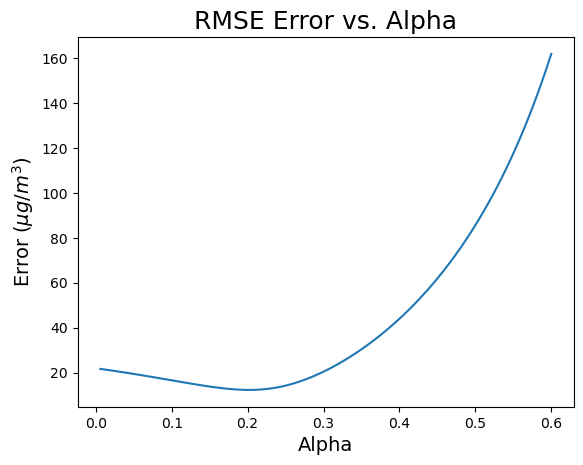

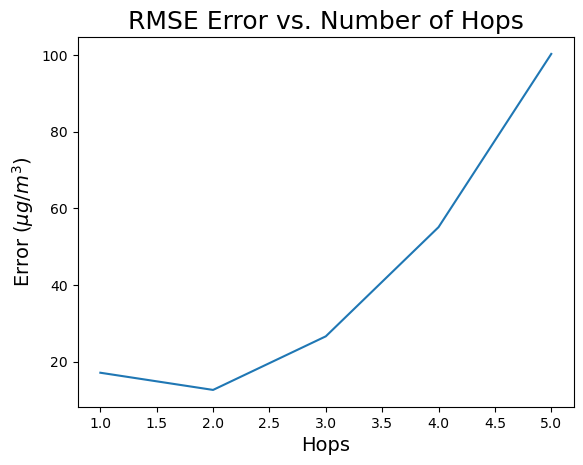

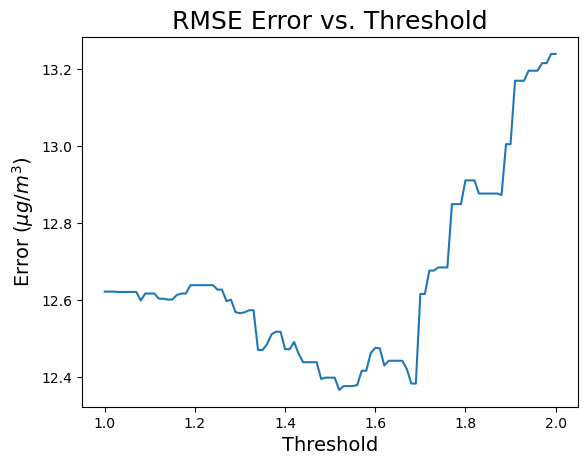

In [434]:
initialise_alpha = 0.2218
initialise_hop = 2
initialise_threshold = 1.06

# Plotting for different parameters

# Plotting for different alpha values
plt.figure(1)
alpha_err = []
alpha_range = np.linspace(0.0, 0.6, 101)
for alpha in alpha_range:
    # Compute error for each alpha value
    err = compute_error(alpha, initialise_threshold, initialise_hop, true_values_train, gap_indices_train, filled_data, euclidean)
    alpha_err.append(err)
plt.plot(alpha_range, alpha_err)
plt.title('RMSE Error vs. Alpha', fontsize=18)
plt.xlabel('Alpha', fontsize=14)
plt.ylabel('Error ($\mu g/m^3$)', fontsize=14)

# Plotting for different hop values
plt.figure(2)
hop_err = []
hop_range = np.arange(1, 6)
for L in hop_range:
    # Compute error for each number of hops
    err = compute_error(initialise_alpha, initialise_threshold, L, true_values_train, gap_indices_train, filled_data, euclidean)
    hop_err.append(err)
plt.plot(hop_range, hop_err)
plt.title('RMSE Error vs. Number of Hops', fontsize=18)
plt.xlabel('Hops', fontsize=14)
plt.ylabel('Error ($\mu g/m^3$)', fontsize=14)

# Plotting for different threshold values
plt.figure(3)
threshold_err = []
threshold_range = np.linspace(1.0, 2.0, 101)
for threshold in threshold_range:
    # Compute error for each threshold value
    err = compute_error(initialise_alpha, threshold, initialise_hop, true_values_train, gap_indices_train, filled_data, euclidean)
    threshold_err.append(err)
plt.plot(threshold_range, threshold_err)
plt.title('RMSE Error vs. Threshold', fontsize=18)
plt.xlabel('Threshold', fontsize=14)
plt.ylabel('Error ($\mu g/m^3$)', fontsize=14)

# Assign tuned hyperparameters
alpha_err = np.nan_to_num(alpha_err, nan=np.inf)
hop_err = np.nan_to_num(hop_err, nan=np.inf)
threshold_err = np.nan_to_num(threshold_err, nan=np.inf)

tuned_alpha = alpha_range[np.argmin(alpha_err)]
tuned_hop = hop_range[np.argmin(hop_err)]
tuned_threshold = threshold_range[np.argmin(threshold_err)]

# Additional code to print minimum errors
print('Minimum alpha error: ', min(alpha_err), 'Tuned alpha: ', tuned_alpha)
print('Minimum L-hops error: ', min(hop_err), 'Tuned L-hops: ', tuned_hop)
print('Minimum threshold error: ', min(threshold_err), 'Tuned threshold: ', tuned_threshold)

tuned_alpha_daily, tuned_hop_daily, tuned_threshold_daily = tuned_alpha, tuned_hop, tuned_threshold


RMSE error: 12.063402292519859
SMAPE error: 0.20136446912379596


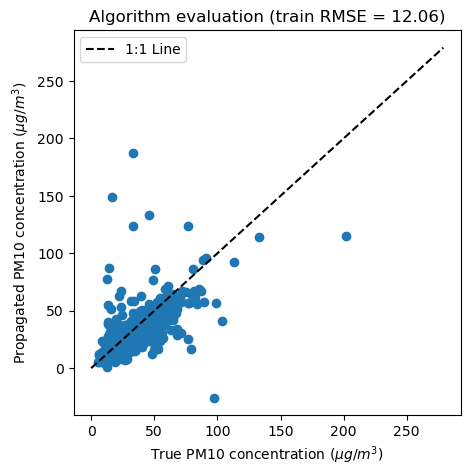

In [435]:
# Plot propagated training values against true training values

Z, A = compute_propagation_matrix(filled_data, euclidean, threshold=tuned_threshold, L=tuned_hop, alpha=tuned_alpha)
propagated_values = [Z[entry] for entry in gap_indices_train]

x = np.arange(filled_data.max().max())
plt.figure(figsize=(5, 5))
plt.scatter(true_values_train, propagated_values)
plt.plot(x, x, color='black', linestyle='--', label='1:1 Line')  # Adding a label for the 1:1 line
plt.title(f'Algorithm evaluation (train RMSE = {compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_train, gap_indices_train, filled_data, euclidean):.2f})')
plt.xlabel(rf'True {species} concentration ($\mu g/m^3$)')  
plt.ylabel(rf'Propagated {species} concentration ($\mu g/m^3$)')  
plt.legend()  # Displaying the legend

print("RMSE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_train, gap_indices_train, filled_data, euclidean))
print("SMAPE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_train, gap_indices_train, filled_data, euclidean, error_type='smape'))

RMSE error: 7.601801099067338
SMAPE error: 0.18634727574861346


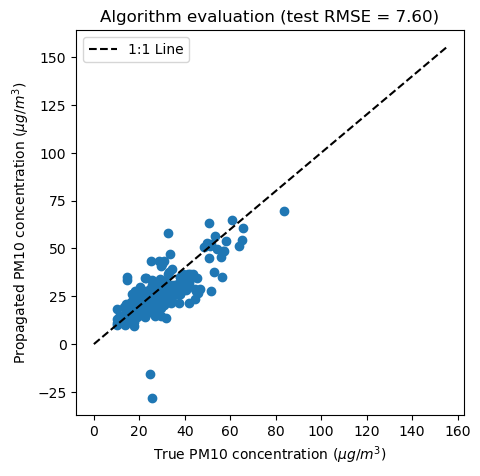

In [436]:
# Initialise test dataset with estimated interpolated values
order = 3
filled_data = subset_test.interpolate(method='polynomial', order=order, axis=0)

# Check if there are still NaN values after interpolation
remaining_gaps = filled_data.isna().sum().sum()

if remaining_gaps > 0:
    
    # Group by year and fill NaN values with the mean of each group
    filled_data = filled_data.groupby(filled_data.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

    # Drop the additional "year" index created by groupby
    filled_data.reset_index(level='year', drop=True, inplace=True)

# Compute euclidean distance matrix
euclidean = euclidean_AM(filled_data)
# print(euclidean)

# Plot propagated test values against true test values

Z, A = compute_propagation_matrix(filled_data, euclidean, threshold=tuned_threshold, L=tuned_hop, alpha=tuned_alpha)
propagated_values = [Z[entry] for entry in gap_indices_test]


x = np.arange(filled_data.max().max())
plt.figure(figsize=(5, 5))
plt.scatter(true_values_test, propagated_values)
plt.plot(x, x, color='black', linestyle='--', label='1:1 Line')  # Adding a label for the 1:1 line
plt.title(f'Algorithm evaluation (test RMSE = {compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean):.2f})')
plt.xlabel(rf'True {species} concentration ($\mu g/m^3$)')  
plt.ylabel(rf'Propagated {species} concentration ($\mu g/m^3$)')  
plt.legend()  # Displaying the legend

print("RMSE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean))
print("SMAPE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean, error_type='smape'))

In [437]:
# for i in range(len(propagated_values)):
#     print(f'{true_values_test[i]} -> {propagated_values[i]}')

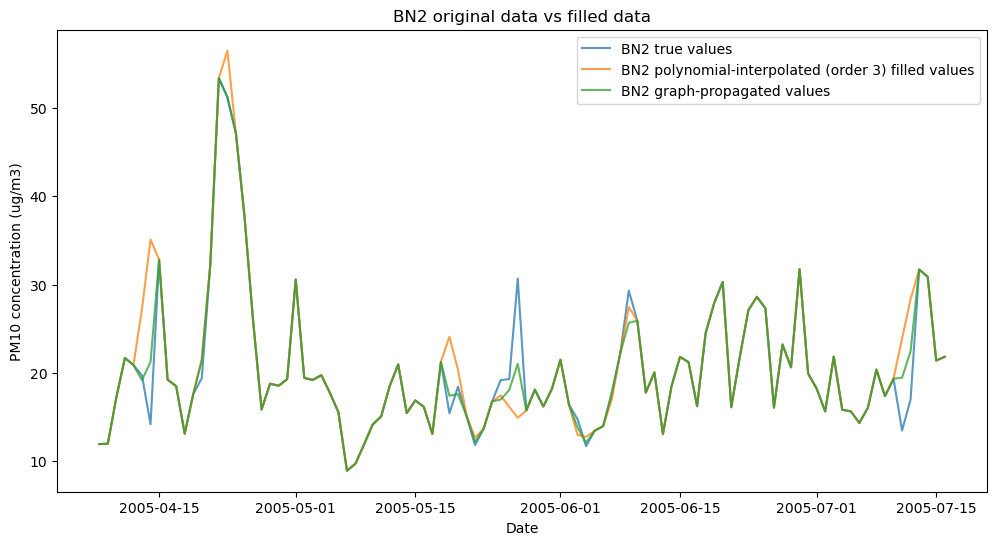

In [438]:
column = column_names[0]

plt.figure(figsize=(12, 6))

plt.plot(test_set.index, test_set[column], label=f"{column} true values", alpha=0.75)
plt.plot(filled_data.index, filled_data[column], label=f"{column} polynomial-interpolated (order {order}) filled values", alpha=0.75)

# Replace graph-propagated values into the filled data from polynomial interpolation
for index, value in zip(gap_indices_test, propagated_values):
    filled_data.iloc[index[0], index[1]] = value

plt.plot(filled_data.index, filled_data[column], label=f"{column} graph-propagated values", alpha=0.75)

# Add labels and legend
plt.xlabel('Date')
plt.ylabel(f'{species} concentration (ug/m3)')
plt.title(f'{column} original data vs filled data')
plt.legend()
plt.show()

## Hourly case study

In [584]:
hourly_df = data.df.set_index('date', inplace=False)
print(hourly_df.shape)

(219169, 201)


In [585]:
# Splitting the dataframe
hourly_df_before_2020 = hourly_df.loc[hourly_df.index < '2020-01-01']
hourly_df_from_2020_onwards = hourly_df.loc[hourly_df.index >= '2020-01-01']

In [361]:
# complete_subset_500 = complete_subset.copy() # Store the complete subset with 500 valid values for later use

In [362]:
# complete_subset_1000 = complete_subset.copy() # Store the complete subset with 1000 valid values for later use

In [586]:
hourly_df_2011_2020 = hourly_df_before_2020.loc[hourly_df_before_2020.index >= '2011-01-01'] # Trim the dataset so it doesn't take as long to search for a complete subset
print(hourly_df_2011_2020.shape)

(78888, 201)


In [587]:
complete_subset, column_names = get_complete_subset(hourly_df_2011_2020, num_valid_values=500)
print("Complete subset shape:", complete_subset.shape)
print("Stations:", column_names)
print(complete_subset.index.min(), complete_subset.index.max())

Complete subset shape: (500, 47)
Stations: Index(['BG2', 'BT8', 'BT4', 'BT6', 'IM1', 'CT4', 'CR9', 'CR7', 'EI3', 'EA6',
       'EA8', 'EI1', 'EN4', 'EN7', 'GR7', 'GB6', 'GN3', 'GN5', 'HK6', 'HG4',
       'LH0', 'IS2', 'LW1', 'HP1', 'LW4', 'LW2', 'ME9', 'NM2', 'NM3', 'RB4',
       'RB7', 'RI2', 'RI1', 'SK5', 'SK6', 'TH4', 'TH2', 'WAC', 'WA7', 'WA8',
       'WAB', 'WMA', 'WM5', 'WM0', 'WM6', 'WMB', 'NB1'],
      dtype='object')
2018-12-17 17:00:00 2019-01-07 12:00:00


In [588]:
training_proportion = 0.8
train_set = complete_subset.iloc[:int(complete_subset.shape[0] * training_proportion), :]
test_set = complete_subset.iloc[int(complete_subset.shape[0] * training_proportion):, :]
print("Train set shape:", train_set.shape)
print("Test set shape:", test_set.shape)

Train set shape: (400, 47)
Test set shape: (100, 47)


In [589]:
# Introduce gaps of varying length

def introduce_gaps(complete_subset: pd.DataFrame, num_missing_periods: int = 100, max_period_length: int = 10, seed: int = 0) -> Tuple[List[List[Tuple[int, int]]], List[pd.Series], pd.DataFrame]:
    """
    Introduce gaps (replace consecutive entries with NaNs) in a complete subset DataFrame.

    Parameters:
    - complete_subset: DataFrame representing the complete subset.
    - num_missing_periods: Number of missing data periods to be introduced (default is 100).
    - max_period_length: Maximum length of missing data periods (default is 10).
    - seed: Seed for NumPy random number generator (default is 0).

    Returns:
    - Tuple containing:
        - List of lists, where each sublist contains tuples representing the indices of the introduced gaps within a period.
        - List of Series representing the initial true values before introducing gaps.
        - DataFrame with introduced gaps.
    """
    np.random.seed(seed)
    subset = complete_subset.copy()

    # Replace consecutive entries with NaNs and store indices for each period
    num_rows, num_cols = complete_subset.shape
    missing_periods_indices = []

    for _ in range(num_missing_periods):
        start_row = np.random.randint(0, num_rows - max_period_length + 1)
        start_col = np.random.randint(0, num_cols)
        period_length = np.random.randint(1, max_period_length + 1)

        missing_indices_period = [(start_row + i, start_col) for i in range(period_length)]
        missing_periods_indices.append(missing_indices_period)

        for row, col in missing_indices_period:
            subset.iloc[row, col] = np.nan

    # Store initial true values before introducing gaps
    true_values = [complete_subset.iloc[row, col] for period in missing_periods_indices for row, col in period]

    # Return information about introduced gaps, initial true values, and the modified subset
    return missing_periods_indices, true_values, subset


In [590]:
gap_proportion = 0.2 # Proportion of missing entries
max_gap_length = 20 # Maximum length of missing data periods

# Calculate the total number of missing data points needed to achieve the desired proportion
# Divide the total number of missing data points by the maximum length of missing data periods
# Empirical scaling
num_missing_periods_train = int(train_set.size * gap_proportion) // max_gap_length
num_missing_periods_test = int(test_set.size * gap_proportion) // max_gap_length

# Call the introduce_gaps function with the adjusted num_missing_periods parameter
gap_indices_train, true_values_train, subset_train = introduce_gaps(train_set, num_missing_periods=num_missing_periods_train, max_period_length=max_gap_length, seed=0)
gap_indices_test, true_values_test, subset_test = introduce_gaps(test_set, num_missing_periods=num_missing_periods_test, max_period_length=max_gap_length, seed=0)


In [591]:
print(f"Proportion of missing data (training): ", subset_train.isna().sum().sum()/(subset_train.size))
print(f"Proportion of missing data (test): ", subset_test.isna().sum().sum()/(subset_test.size))


Proportion of missing data (training):  0.1001595744680851
Proportion of missing data (test):  0.09297872340425532


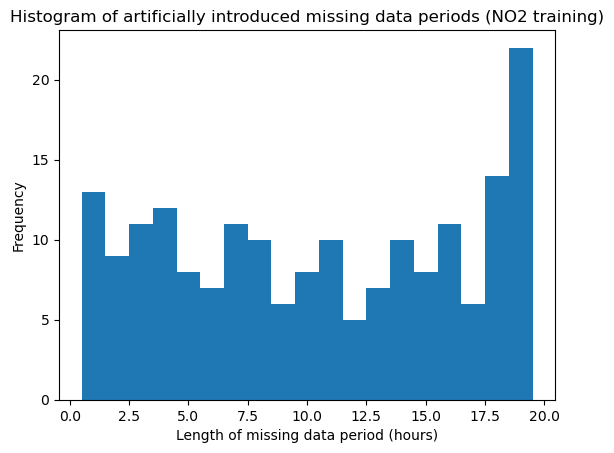

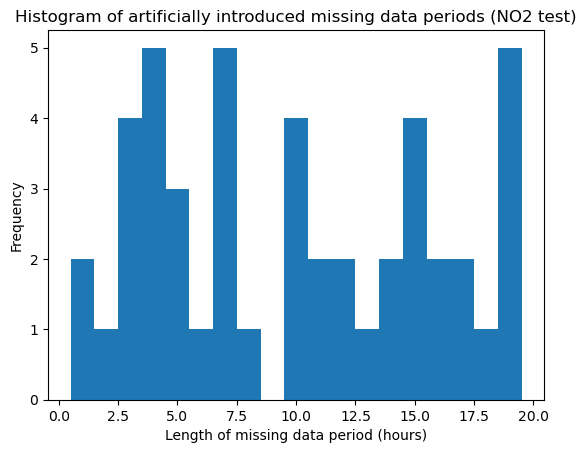

In [592]:
# Calculate lengths of missing data periods
missing_periods_lengths = [len(period) for period in gap_indices_train]

# Plot histogram
plt.hist(missing_periods_lengths, bins=range(1, max(missing_periods_lengths) + 1), align='left')
plt.xlabel('Length of missing data period (hours)')
plt.ylabel('Frequency')
plt.title(f'Histogram of artificially introduced missing data periods ({species} training)')
plt.show()

# Calculate lengths of missing data periods
missing_periods_lengths = [len(period) for period in gap_indices_test]

# Plot histogram
plt.hist(missing_periods_lengths, bins=range(1, max(missing_periods_lengths) + 1), align='left')
plt.xlabel('Length of missing data period (hours)')
plt.ylabel('Frequency')
plt.title(f'Histogram of artificially introduced missing data periods ({species} test)')
plt.show()

In [593]:
# Flatten the gap_indices list of lists into a single list of tuples (this is necessary for downstream code)
gap_indices_train = [index for sublist in gap_indices_train for index in sublist]
gap_indices_test = [index for sublist in gap_indices_test for index in sublist]

In [594]:
# Group by year and fill NaN values with the mean of each group
filled_data = subset_test.groupby(subset_test.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

# Drop the additional "year" index created by groupby
filled_data.reset_index(level='year', drop=True, inplace=True)

# Extract only the estimated values for NaN indices
estimated_values = [filled_data.iloc[idx[0], idx[1]] for idx in gap_indices_test]
# estimated_values = []
# for idx in gap_indices_test:
#     for index in idx:
#         estimated_values.append(filled_data.iloc[index[0], index[1]])

# Compute error
print(f"RMSE test set error after filling {species} with station annual means:", rmse_error(true_values_test, estimated_values))
print(f"SMAPE test set error after filling {species} with station annual means:", smape_error(true_values_test, estimated_values))

RMSE test set error after filling NO2 with station annual means: 15.250697825143389
SMAPE test set error after filling NO2 with station annual means: 0.2551734861061466


In [595]:
print("RMSE test set errors after filling with polynomial interpolation:")

for order in range(1, 4):
    filled_data = subset_test.interpolate(method='polynomial', order=order, axis=0)

    # Check if there are still NaN values after interpolation
    remaining_gaps = filled_data.isna().sum().sum()

    if remaining_gaps > 0:
        print(f"Applying fill with annual mean concentrations for {remaining_gaps} remaining NaN values.")
        
        # Group by year and fill NaN values with the mean of each group
        filled_data = filled_data.groupby(filled_data.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

        # Drop the additional "year" index created by groupby
        filled_data.reset_index(level='year', drop=True, inplace=True)

    # Extract only the estimated values for NaN indices
    estimated_values = [filled_data.iloc[idx[0], idx[1]] for idx in gap_indices_test]

    # Compute error for each method and print the results
    print(f"Order {order} RMSE: {rmse_error(true_values_test, estimated_values)}")
    print(f"Order {order} SMAPE: {smape_error(true_values_test, estimated_values)}")

    # # Set the figure size before creating the plot
    # plt.figure(figsize=(12, 6))

    # # Plot each column of the DataFrame
    # for column in filled_data.columns:
    #     plt.plot(filled_data.index, filled_data[column], label=column)

    # # Add labels and legend
    # plt.xlabel('Date')
    # plt.ylabel('NO2 concentration (ug/m3)')
    # plt.title(f'Filled data time series with polynomial interpolation order {order}')
    # plt.legend()
    # plt.show()

# print("Original data:")

# plt.figure(figsize=(12, 6))

# # Plot each column of the DataFrame
# for column in complete_subset.columns:
#     plt.plot(complete_subset.index, complete_subset[column], label=column)

# # Add labels and legend
# plt.xlabel('Date')
# plt.ylabel('NO2 concentration (ug/m3)')
# plt.title(f'Complete data time series')
# plt.legend()
# plt.show()


# print("Original data vs filled data:")
# column = column_names[0]

# plt.figure(figsize=(12, 6))

# plt.plot(test_set.index, test_set[column], label=f"{column} true values", alpha=0.75)
# plt.plot(filled_data.index, filled_data[column], label=f"{column} filled values", alpha=0.75)

# # Add labels and legend
# plt.xlabel('Date')
# plt.ylabel('NO2 concentration (ug/m3)')
# plt.title(f'{column} original data vs filled data (polynomial interpolation order {order})')
# plt.legend()
# plt.show()


RMSE test set errors after filling with polynomial interpolation:
Applying fill with annual mean concentrations for 12 remaining NaN values.
Order 1 RMSE: 14.348729917870907
Order 1 SMAPE: 0.23091328114174509
Applying fill with annual mean concentrations for 12 remaining NaN values.
Order 2 RMSE: 26.83249385621356
Order 2 SMAPE: 0.42986933242682845
Applying fill with annual mean concentrations for 12 remaining NaN values.
Order 3 RMSE: 27.40574611724122
Order 3 SMAPE: 0.4315961588079587


In [596]:
# Initialise training dataset with estimated interpolated values
order = 3
filled_data = subset_train.interpolate(method='polynomial', order=order, axis=0)

# Check if there are still NaN values after interpolation
remaining_gaps = filled_data.isna().sum().sum()

if remaining_gaps > 0:
    print(f"Applying fill with annual mean concentrations for {remaining_gaps} remaining NaN values.")
    
    # Group by year and fill NaN values with the mean of each group
    filled_data = filled_data.groupby(filled_data.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

    # Drop the additional "year" index created by groupby
    filled_data.reset_index(level='year', drop=True, inplace=True)

euclidean = euclidean_AM(filled_data)
# print(euclidean)

Applying fill with annual mean concentrations for 19 remaining NaN values.


/Users/michellewan/Repos/AQ-graph-prop/graph_utils.py:256: RuntimeWarning: invalid value encountered in double_scalars
  q = (w[i]/Y_i) * r
/Users/michellewan/Repos/AQ-graph-prop/graph_utils.py:260: RuntimeWarning: invalid value encountered in double_scalars
  r = (Y_i/Y_iplus) * prop_matrix.dot(r.T).T
/Users/michellewan/Repos/AQ-graph-prop/graph_utils.py:262: RuntimeWarning: invalid value encountered in double_scalars
  q = w[L]/w[L:].sum() * r


Minimum alpha error:  15.820777081640056 Tuned alpha:  0.228
Minimum L-hops error:  15.828019376139702 Tuned L-hops:  2
Minimum threshold error:  15.54843745444647 Tuned threshold:  1.0


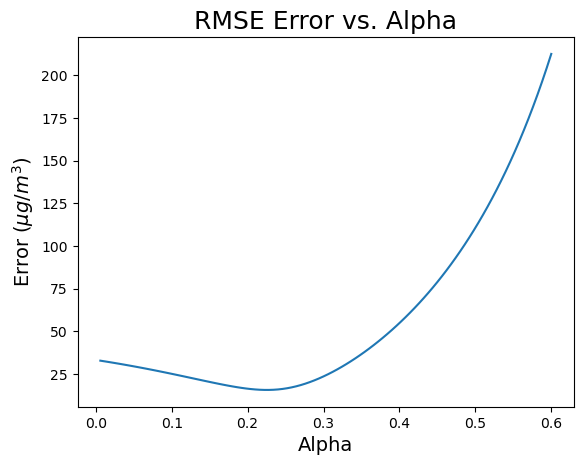

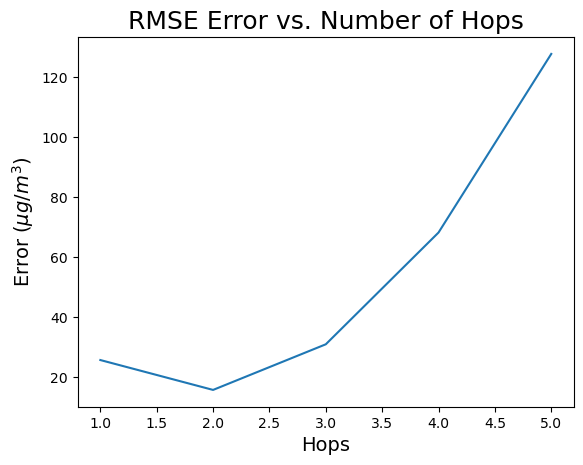

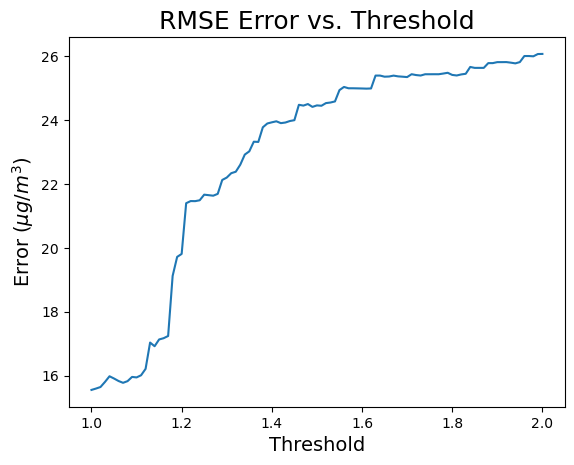

In [597]:
initialise_alpha = 0.2218
initialise_hop = 2
initialise_threshold = 1.06

# Plotting for different parameters

# Plotting for different alpha values
plt.figure(1)
alpha_err = []
alpha_range = np.linspace(0.0, 0.6, 101)
for alpha in alpha_range:
    # Compute error for each alpha value
    err = compute_error(alpha, initialise_threshold, initialise_hop, true_values_train, gap_indices_train, filled_data, euclidean)
    alpha_err.append(err)
plt.plot(alpha_range, alpha_err)
plt.title('RMSE Error vs. Alpha', fontsize=18)
plt.xlabel('Alpha', fontsize=14)
plt.ylabel('Error ($\mu g/m^3$)', fontsize=14)

# Plotting for different hop values
plt.figure(2)
hop_err = []
hop_range = np.arange(1, 6)
for L in hop_range:
    # Compute error for each number of hops
    err = compute_error(initialise_alpha, initialise_threshold, L, true_values_train, gap_indices_train, filled_data, euclidean)
    hop_err.append(err)
plt.plot(hop_range, hop_err)
plt.title('RMSE Error vs. Number of Hops', fontsize=18)
plt.xlabel('Hops', fontsize=14)
plt.ylabel('Error ($\mu g/m^3$)', fontsize=14)

# Plotting for different threshold values
plt.figure(3)
threshold_err = []
threshold_range = np.linspace(1.0, 2.0, 101)
for threshold in threshold_range:
    # Compute error for each threshold value
    err = compute_error(initialise_alpha, threshold, initialise_hop, true_values_train, gap_indices_train, filled_data, euclidean)
    threshold_err.append(err)
plt.plot(threshold_range, threshold_err)
plt.title('RMSE Error vs. Threshold', fontsize=18)
plt.xlabel('Threshold', fontsize=14)
plt.ylabel('Error ($\mu g/m^3$)', fontsize=14)

# Assign tuned hyperparameters
alpha_err = np.nan_to_num(alpha_err, nan=np.inf)
hop_err = np.nan_to_num(hop_err, nan=np.inf)
threshold_err = np.nan_to_num(threshold_err, nan=np.inf)

tuned_alpha = alpha_range[np.argmin(alpha_err)]
tuned_hop = hop_range[np.argmin(hop_err)]
tuned_threshold = threshold_range[np.argmin(threshold_err)]

# Additional code to print minimum errors
print('Minimum alpha error: ', min(alpha_err), 'Tuned alpha: ', tuned_alpha)
print('Minimum L-hops error: ', min(hop_err), 'Tuned L-hops: ', tuned_hop)
print('Minimum threshold error: ', min(threshold_err), 'Tuned threshold: ', tuned_threshold)

tuned_alpha_hourly, tuned_hop_hourly, tuned_threshold_hourly = tuned_alpha, tuned_hop, tuned_threshold

RMSE error: 15.53641831601029
SMAPE error: 0.32099230518464


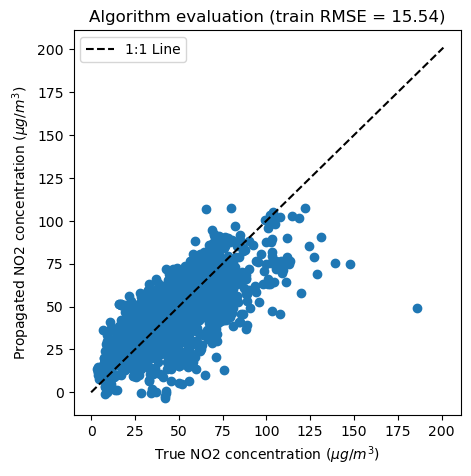

In [598]:
# Plot propagated training values against true training values

Z, A = compute_propagation_matrix(filled_data, euclidean, threshold=tuned_threshold, L=tuned_hop, alpha=tuned_alpha)
propagated_values = [Z[entry] for entry in gap_indices_train]

x = np.arange(filled_data.max().max())
plt.figure(figsize=(5, 5))
plt.scatter(true_values_train, propagated_values)
plt.plot(x, x, color='black', linestyle='--', label='1:1 Line')  # Adding a label for the 1:1 line
plt.title(f'Algorithm evaluation (train RMSE = {compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_train, gap_indices_train, filled_data, euclidean):.2f})')
plt.xlabel(rf'True {species} concentration ($\mu g/m^3$)')  
plt.ylabel(rf'Propagated {species} concentration ($\mu g/m^3$)')  
plt.legend()  # Displaying the legend

print("RMSE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_train, gap_indices_train, filled_data, euclidean))
print("SMAPE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_train, gap_indices_train, filled_data, euclidean, error_type='smape'))

RMSE error: 19.481943822640222
SMAPE error: 0.24520552453722402


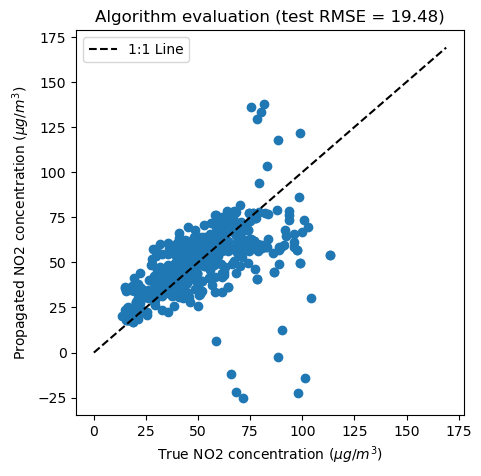

In [599]:
# Initialise test dataset with estimated interpolated values
order = 3
filled_data = subset_test.interpolate(method='polynomial', order=order, axis=0)

# Check if there are still NaN values after interpolation
remaining_gaps = filled_data.isna().sum().sum()

if remaining_gaps > 0:
    
    # Group by year and fill NaN values with the mean of each group
    filled_data = filled_data.groupby(filled_data.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

    # Drop the additional "year" index created by groupby
    filled_data.reset_index(level='year', drop=True, inplace=True)

# Compute euclidean distance matrix
euclidean = euclidean_AM(filled_data)
# print(euclidean)

# Plot propagated test values against true test values

Z, A = compute_propagation_matrix(filled_data, euclidean, threshold=tuned_threshold, L=tuned_hop, alpha=tuned_alpha)
propagated_values = [Z[entry] for entry in gap_indices_test]


x = np.arange(filled_data.max().max())
plt.figure(figsize=(5, 5))
plt.scatter(true_values_test, propagated_values)
plt.plot(x, x, color='black', linestyle='--', label='1:1 Line')  # Adding a label for the 1:1 line
plt.title(f'Algorithm evaluation (test RMSE = {compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean):.2f})')
plt.xlabel(rf'True {species} concentration ($\mu g/m^3$)')  
plt.ylabel(rf'Propagated {species} concentration ($\mu g/m^3$)')  
plt.legend()  # Displaying the legend

print("RMSE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean))
print("SMAPE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean, error_type='smape'))

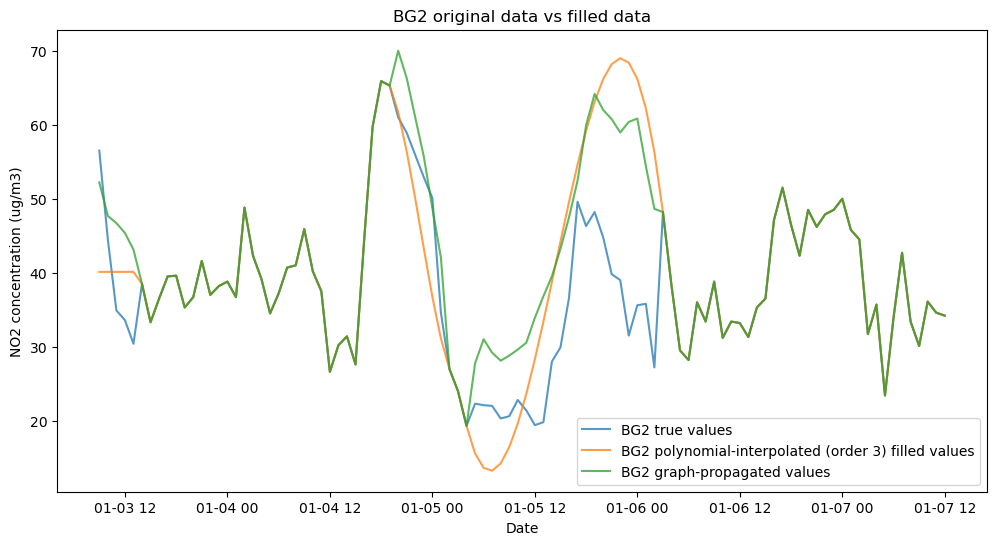

In [600]:
column = column_names[0]

plt.figure(figsize=(12, 6))

plt.plot(test_set.index, test_set[column], label=f"{column} true values", alpha=0.75)
plt.plot(filled_data.index, filled_data[column], label=f"{column} polynomial-interpolated (order {order}) filled values", alpha=0.75)

# Replace graph-propagated values into the filled data from polynomial interpolation
for index, value in zip(gap_indices_test, propagated_values):
    filled_data.iloc[index[0], index[1]] = value

plt.plot(filled_data.index, filled_data[column], label=f"{column} graph-propagated values", alpha=0.75)

# Add labels and legend
plt.xlabel('Date')
plt.ylabel(f'{species} concentration (ug/m3)')
plt.title(f'{column} original data vs filled data')
plt.legend()
plt.show()

## COVID study

In [374]:
print(species)
print(hourly_df.shape)
print(tuned_alpha_hourly, tuned_hop_hourly, tuned_threshold_hourly)

NO2
(219169, 201)
0.228 2 1.85


In [375]:
# Get dataset - if not previously run in the Hourly data section of the notebook

species = "NO2"
data_filename = f"LAQN_{species}_{start_date}_{end_date}.csv"
data = Dataset(path.join(data_folder, data_filename))
hourly_df = data.df.set_index('date', inplace=False)
print(hourly_df.shape)

(219169, 201)


In [376]:
# Training set on pre-COVID data - if not previously run in the Hourly data section of the notebook

pre_COVID_df = hourly_df.loc[(hourly_df.index < '2020-01-01') & (hourly_df.index >= '2011-01-01')]
print(pre_COVID_df.shape)

complete_subset, column_names = get_complete_subset(pre_COVID_df, num_valid_values=500)
print("Complete subset shape:", complete_subset.shape)
print("Stations:", column_names)
print(complete_subset.index.min(), complete_subset.index.max())

training_proportion = 0.8
train_set = complete_subset.iloc[:int(complete_subset.shape[0] * training_proportion), :] # Keep the same training set as in the Hourly data analysis
# test_set = complete_subset.iloc[int(complete_subset.shape[0] * training_proportion):, :]
# train_set = complete_subset.copy() # OR Use all of the pre-COVID data as the training set
print("Train set shape:", train_set.shape)
# print("Test set shape:", test_set.shape)

gap_proportion = 0.2 # Proportion of missing entries

gap_indices_train, true_values_train, subset_train = introduce_gaps(train_set, num_missing_entries=int((train_set.shape[0]*train_set.shape[1])*gap_proportion), seed=0)
# gap_indices_test, true_values_test, subset_test = introduce_gaps(test_set, num_missing_entries=int((test_set.shape[0]*test_set.shape[1])*gap_proportion), seed=0)

# Graph propagation

# Initialise training dataset with estimated interpolated values
print("Initialise training dataset with estimated interpolated values")
order = 3
filled_data = subset_train.interpolate(method='polynomial', order=order, axis=0)

# Check if there are still NaN values after interpolation
remaining_gaps = filled_data.isna().sum().sum()

if remaining_gaps > 0:
    print(f"Applying fill with annual mean concentrations for {remaining_gaps} remaining NaN values.")
    
    # Group by year and fill NaN values with the mean of each group
    filled_data = filled_data.groupby(filled_data.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

    # Drop the additional "year" index created by groupby
    filled_data.reset_index(level='year', drop=True, inplace=True)

euclidean = euclidean_AM(filled_data)
# print(euclidean)


initialise_alpha = 0.2218
initialise_hop = 2
initialise_threshold = 1.06

# Plotting for different parameters
print("Hyperparameter tuning")

# Plotting for different alpha values
# plt.figure(1)
alpha_err = []
alpha_range = np.linspace(0.0, 0.6, 101)
for alpha in alpha_range:
    # Compute error for each alpha value
    err = compute_error(alpha, initialise_threshold, initialise_hop, true_values_train, gap_indices_train, filled_data, euclidean)
    alpha_err.append(err)
# plt.plot(alpha_range, alpha_err)
# plt.title('RMSE Error vs. Alpha', fontsize=18)
# plt.xlabel('Alpha', fontsize=14)
# plt.ylabel('Error ($\mu g/m^3$)', fontsize=14)

# Plotting for different hop values
# plt.figure(2)
hop_err = []
hop_range = np.arange(1, 6)
for L in hop_range:
    # Compute error for each number of hops
    err = compute_error(initialise_alpha, initialise_threshold, L, true_values_train, gap_indices_train, filled_data, euclidean)
    hop_err.append(err)
# plt.plot(hop_range, hop_err)
# plt.title('RMSE Error vs. Number of Hops', fontsize=18)
# plt.xlabel('Hops', fontsize=14)
# plt.ylabel('Error ($\mu g/m^3$)', fontsize=14)

# Plotting for different threshold values
# plt.figure(3)
threshold_err = []
threshold_range = np.linspace(1.0, 2.0, 101)
for threshold in threshold_range:
    # Compute error for each threshold value
    err = compute_error(initialise_alpha, threshold, initialise_hop, true_values_train, gap_indices_train, filled_data, euclidean)
    threshold_err.append(err)
# plt.plot(threshold_range, threshold_err)
# plt.title('RMSE Error vs. Threshold', fontsize=18)
# plt.xlabel('Threshold', fontsize=14)
# plt.ylabel('Error ($\mu g/m^3$)', fontsize=14)

# Assign tuned hyperparameters
alpha_err = np.nan_to_num(alpha_err, nan=np.inf)
hop_err = np.nan_to_num(hop_err, nan=np.inf)
threshold_err = np.nan_to_num(threshold_err, nan=np.inf)

tuned_alpha = alpha_range[np.argmin(alpha_err)]
tuned_hop = hop_range[np.argmin(hop_err)]
tuned_threshold = threshold_range[np.argmin(threshold_err)]

# Additional code to print minimum errors
print('Minimum alpha error: ', min(alpha_err), 'Tuned alpha: ', tuned_alpha)
print('Minimum L-hops error: ', min(hop_err), 'Tuned L-hops: ', tuned_hop)
print('Minimum threshold error: ', min(threshold_err), 'Tuned threshold: ', tuned_threshold)


# Plot propagated training values against true training values
print("Training errors")
Z, A = compute_propagation_matrix(filled_data, euclidean, threshold=tuned_threshold, L=tuned_hop, alpha=tuned_alpha)
propagated_values = [Z[entry] for entry in gap_indices_train]

# x = np.arange(filled_data.max().max())
# plt.figure(figsize=(5, 5))
# plt.scatter(true_values_train, propagated_values)
# plt.plot(x, x, color='black', linestyle='--', label='1:1 Line')  # Adding a label for the 1:1 line
# plt.title(f'Algorithm evaluation (train RMSE = {compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_train, gap_indices_train, filled_data, euclidean):.2f})')
# plt.xlabel(rf'True {species} concentration ($\mu g/m^3$)')  
# plt.ylabel(rf'Propagated {species} concentration ($\mu g/m^3$)')  
# plt.legend()  # Displaying the legend

print("RMSE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_train, gap_indices_train, filled_data, euclidean))
print("SMAPE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_train, gap_indices_train, filled_data, euclidean, error_type='smape'))

(78888, 201)
Complete subset shape: (500, 47)
Stations: Index(['BG2', 'BT8', 'BT4', 'BT6', 'IM1', 'CT4', 'CR9', 'CR7', 'EI3', 'EA6',
       'EA8', 'EI1', 'EN4', 'EN7', 'GR7', 'GB6', 'GN3', 'GN5', 'HK6', 'HG4',
       'LH0', 'IS2', 'LW1', 'HP1', 'LW4', 'LW2', 'ME9', 'NM2', 'NM3', 'RB4',
       'RB7', 'RI2', 'RI1', 'SK5', 'SK6', 'TH4', 'TH2', 'WAC', 'WA7', 'WA8',
       'WAB', 'WMA', 'WM5', 'WM0', 'WM6', 'WMB', 'NB1'],
      dtype='object')
2018-12-17 17:00:00 2019-01-07 12:00:00
Train set shape: (400, 47)
Initialise training dataset with estimated interpolated values
Applying fill with annual mean concentrations for 23 remaining NaN values.
Hyperparameter tuning


/Users/michellewan/Repos/AQ-graph-prop/graph_utils.py:256: RuntimeWarning: invalid value encountered in double_scalars
  q = (w[i]/Y_i) * r
/Users/michellewan/Repos/AQ-graph-prop/graph_utils.py:260: RuntimeWarning: invalid value encountered in double_scalars
  r = (Y_i/Y_iplus) * prop_matrix.dot(r.T).T
/Users/michellewan/Repos/AQ-graph-prop/graph_utils.py:262: RuntimeWarning: invalid value encountered in double_scalars
  q = w[L]/w[L:].sum() * r


Minimum alpha error:  10.990760845265429 Tuned alpha:  0.228
Minimum L-hops error:  11.113590856449251 Tuned L-hops:  2
Minimum threshold error:  8.61015451155546 Tuned threshold:  1.85
Training errors
RMSE error: 8.809110979062426
SMAPE error: 0.15972208991061784


In [377]:
# # Initialise test dataset with estimated interpolated values
# order = 3
# filled_data = subset_test.interpolate(method='polynomial', order=order, axis=0)

# # Check if there are still NaN values after interpolation
# remaining_gaps = filled_data.isna().sum().sum()

# if remaining_gaps > 0:
    
#     # Group by year and fill NaN values with the mean of each group
#     filled_data = filled_data.groupby(filled_data.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

#     # Drop the additional "year" index created by groupby
#     filled_data.reset_index(level='year', drop=True, inplace=True)

# # Compute euclidean distance matrix 
# euclidean = euclidean_AM(filled_data)
# # print(euclidean)

# # Plot propagated test values against true test values
# print("Test errors")
# Z, A = compute_propagation_matrix(filled_data, euclidean, threshold=tuned_threshold, L=tuned_hop, alpha=tuned_alpha)
# propagated_values = [Z[entry] for entry in gap_indices_test]


# # x = np.arange(filled_data.max().max())
# # plt.figure(figsize=(5, 5))
# # plt.scatter(true_values_test, propagated_values)
# # plt.plot(x, x, color='black', linestyle='--', label='1:1 Line')  # Adding a label for the 1:1 line
# # plt.title(f'Algorithm evaluation (test RMSE = {compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean):.2f})')
# # plt.xlabel(rf'True {species} concentration ($\mu g/m^3$)')  
# # plt.ylabel(rf'Propagated {species} concentration ($\mu g/m^3$)')  
# # plt.legend()  # Displaying the legend

# print("RMSE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean))
# print("SMAPE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean, error_type='smape'))

# # column = column_names[0]

# # plt.figure(figsize=(12, 6))

# # plt.plot(test_set.index, test_set[column], label=f"{column} true values", alpha=0.75)
# # plt.plot(filled_data.index, filled_data[column], label=f"{column} polynomial-interpolated (order {order}) filled values", alpha=0.75)

# # # Replace graph-propagated values into the filled data from polynomial interpolation
# # for index, value in zip(gap_indices_test, propagated_values):
# #     filled_data.iloc[index[0], index[1]] = value

# # plt.plot(filled_data.index, filled_data[column], label=f"{column} graph-propagated values", alpha=0.75)

# # # Add labels and legend
# # plt.xlabel('Date')
# # plt.ylabel(f'{species} concentration (ug/m3)')
# # plt.title(f'{column} original data vs filled data')
# # plt.legend()
# # plt.show()

(1609, 201)


Complete subset shape: (500, 40)
Stations: Index(['BX2', 'BQ7', 'BT6', 'BT5', 'BL0', 'CD9', 'CT4', 'CR5', 'EI3', 'EI1',
       'EN7', 'GN3', 'HG4', 'HR1', 'HV3', 'IS6', 'KT5', 'KT6', 'LB5', 'LB4',
       'LW1', 'HP1', 'LW4', 'LW2', 'ME9', 'NM3', 'RB4', 'RB7', 'RI2', 'RI1',
       'RHG', 'SK5', 'SK6', 'WAA', 'WAC', 'WA9', 'WA7', 'WAB', 'WA2', 'WMA'],
      dtype='object')
2020-03-26 05:00:00 2020-04-16 00:00:00
Test set shape: (500, 40)
Tuned hyperparameters from the pre-COVID training set: alpha = 0.228, L-hops = 2, threshold = 1.85
Test errors
RMSE error: 7.031786456942957
SMAPE error: 0.20195658272981148


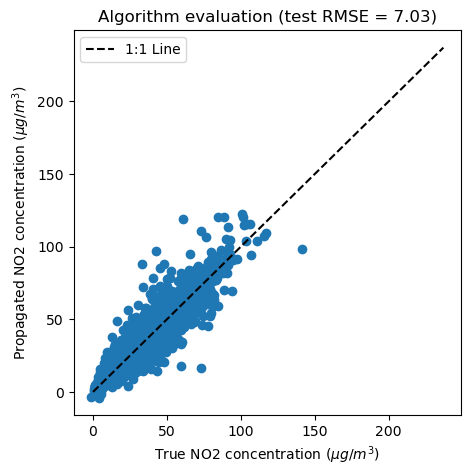

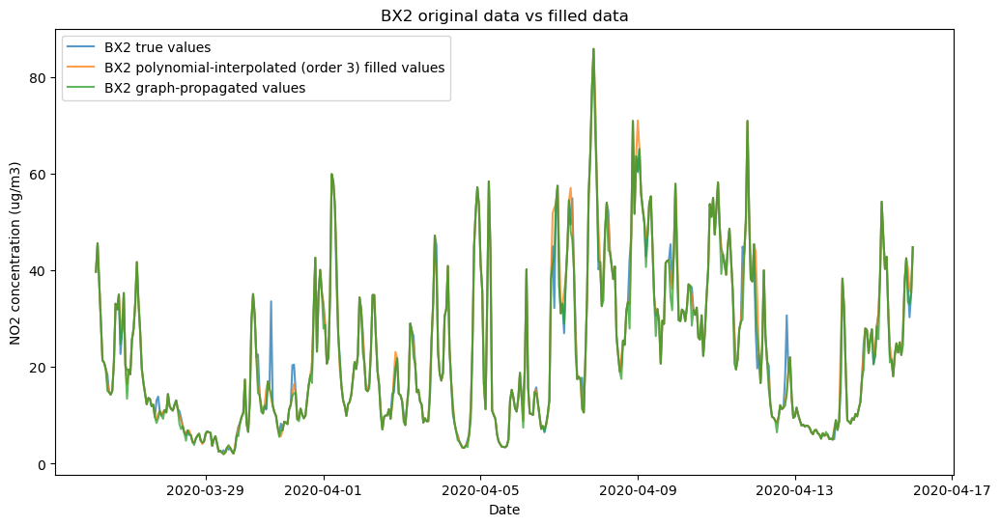

In [378]:
# COVID lockdown test set

# Filter the dataframe between 26 March 2020 and 1 June 2020
lockdown_df = hourly_df.loc[(hourly_df.index >= '2020-03-26') & (hourly_df.index <= '2020-06-01')]
print(lockdown_df.shape)

complete_subset, column_names = get_complete_subset(lockdown_df, num_valid_values=500)
print("Complete subset shape:", complete_subset.shape)
print("Stations:", column_names)
print(complete_subset.index.min(), complete_subset.index.max())

# training_proportion = 0.8
# train_set = complete_subset.iloc[:int(complete_subset.shape[0] * training_proportion), :]
# test_set = complete_subset.iloc[int(complete_subset.shape[0] * training_proportion):, :]
test_set = complete_subset.copy() # Use all of the lockdown data as the test set
# print("Train set shape:", train_set.shape)
print("Test set shape:", test_set.shape)

gap_proportion = 0.2 # Proportion of missing entries

# gap_indices_train, true_values_train, subset_train = introduce_gaps(train_set, num_missing_entries=int((train_set.shape[0]*train_set.shape[1])*gap_proportion), seed=0)
gap_indices_test, true_values_test, subset_test = introduce_gaps(test_set, num_missing_entries=int((test_set.shape[0]*test_set.shape[1])*gap_proportion), seed=0)

# Initialise test dataset with estimated interpolated values
order = 3
filled_data = subset_test.interpolate(method='polynomial', order=order, axis=0)

# Check if there are still NaN values after interpolation
remaining_gaps = filled_data.isna().sum().sum()

if remaining_gaps > 0:
    
    # Group by year and fill NaN values with the mean of each group
    filled_data = filled_data.groupby(filled_data.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

    # Drop the additional "year" index created by groupby
    filled_data.reset_index(level='year', drop=True, inplace=True)

# Use the tuned hyperparameters from the pre-COVID training set

print(f"Tuned hyperparameters from the pre-COVID training set: alpha = {tuned_alpha}, L-hops = {tuned_hop}, threshold = {tuned_threshold}")

# Compute euclidean distance matrix    
euclidean = euclidean_AM(filled_data)
# print(euclidean)

# Plot propagated test values against true test values
print("Test errors")
Z, A = compute_propagation_matrix(filled_data, euclidean, threshold=tuned_threshold, L=tuned_hop, alpha=tuned_alpha)
propagated_values = [Z[entry] for entry in gap_indices_test]


x = np.arange(filled_data.max().max())
plt.figure(figsize=(5, 5))
plt.scatter(true_values_test, propagated_values)
plt.plot(x, x, color='black', linestyle='--', label='1:1 Line')  # Adding a label for the 1:1 line
plt.title(f'Algorithm evaluation (test RMSE = {compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean):.2f})')
plt.xlabel(rf'True {species} concentration ($\mu g/m^3$)')  
plt.ylabel(rf'Propagated {species} concentration ($\mu g/m^3$)')  
plt.legend()  # Displaying the legend

print("RMSE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean))
print("SMAPE error:", compute_error(tuned_alpha, tuned_threshold, tuned_hop, true_values_test, gap_indices_test, filled_data, euclidean, error_type='smape'))

column = column_names[0]

plt.figure(figsize=(12, 6))

plt.plot(test_set.index, test_set[column], label=f"{column} true values", alpha=0.75)
plt.plot(filled_data.index, filled_data[column], label=f"{column} polynomial-interpolated (order {order}) filled values", alpha=0.75)

# Replace graph-propagated values into the filled data from polynomial interpolation
for index, value in zip(gap_indices_test, propagated_values):
    filled_data.iloc[index[0], index[1]] = value

plt.plot(filled_data.index, filled_data[column], label=f"{column} graph-propagated values", alpha=0.75)

# Add labels and legend
plt.xlabel('Date')
plt.ylabel(f'{species} concentration (ug/m3)')
plt.title(f'{column} original data vs filled data')
plt.legend()
plt.show()

## Hyperparameter plots

Threshold: 1.9000000000000001
Alpha: 0.10816326530612246
Minimum RMSE Error: 16.73259535310504


<Figure size 640x480 with 0 Axes>

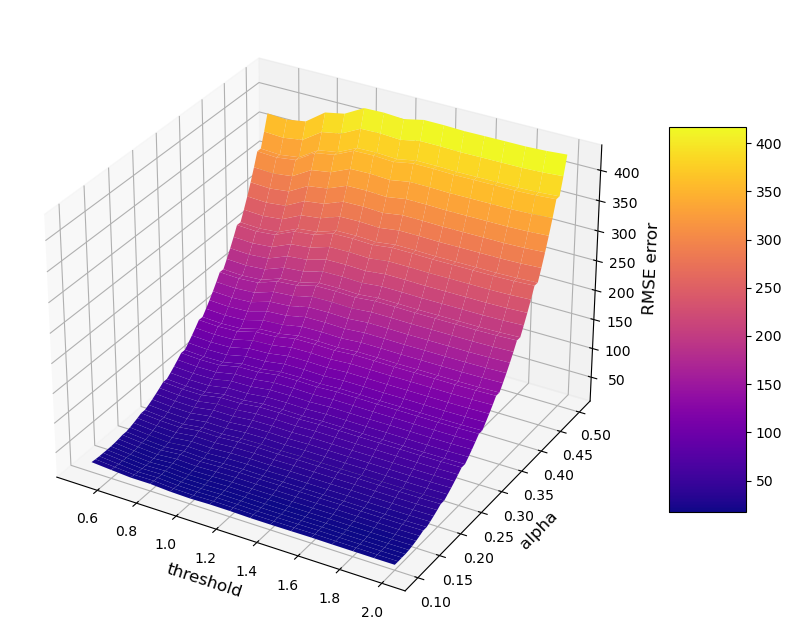

In [152]:
# # Plot error against alpha and threshold
# error_metric = 'rmse'

# plt.figure(1)

# # Define the ranges for alpha, threshold, and L (number of hops)
# alpha_range = np.linspace(0.1, 0.5, 50)
# threshold_range = np.linspace(0.5, 2.0, 16)
# L_range = np.arange(1, 6)

# # Initialize a 2D array to store error values
# loss = np.zeros((len(alpha_range), len(threshold_range)))

# # Loop through alpha and threshold combinations
# for i, val1 in enumerate(alpha_range): 
#     for j, val2 in enumerate(threshold_range):
#         val1 = round(val1, 2)
#         val2 = round(val2, 2)
        
#         # Set a constant value for the number of hops (L)
#         t_hop = 3
        
#         # Use compute_error function to calculate error for the given parameters
#         loss[i][j] = compute_error(val1, val2, t_hop, true_values, gap_indices, filled_data, euclidean, error_type=error_metric)
        
# # Create meshgrid for 3D plotting
# X, Y = np.meshgrid(threshold_range, alpha_range)

# # Create a 3D plot
# fig = plt.figure(figsize=(10, 10))
# ax = fig.add_subplot(111, projection='3d')

# # Plot the surface using the computed error values
# surf = ax.plot_surface(X[:50], Y[:50], loss[:50], cmap='plasma', linewidth=2)
# fig.colorbar(surf, shrink=0.5, aspect=5)

# # Set labels for the axes
# ax.set_xlabel('threshold', fontsize=12)
# ax.set_ylabel('alpha', fontsize=12)
# ax.set_zlabel(f'{error_metric.upper()} error', fontsize=12)

# # Find the indices of minimum error
# shape = np.unravel_index(loss.argmin(), loss.shape)

# # Print the parameters corresponding to the minimum error
# print(f'Threshold: {X[shape]}')
# print(f'Alpha: {Y[shape]}')
# print(f'Minimum {error_metric.upper()} Error: {np.min(loss)}')


Hops: 1
Alpha: 0.3693877551020408
Minimum RMSE Error: 16.266836211758847


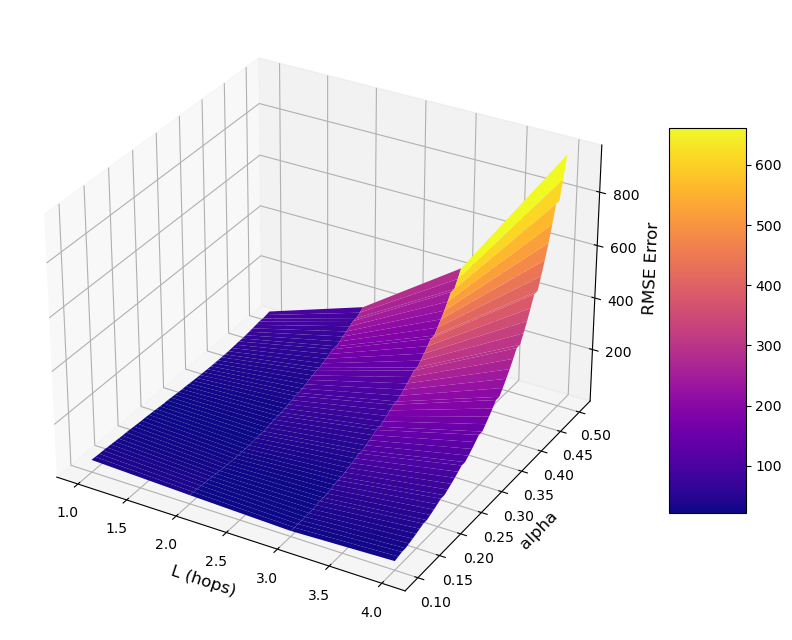

In [153]:
# # Plot loss against alpha and L (hops)
# error_metric = 'rmse'

# alpha_range = np.linspace(0.1, 0.5, 50)
# threshold_range = np.linspace(0.5, 2.0, 16)
# L_range = np.arange(1, 6)

# loss = np.zeros((len(alpha_range), len(L_range)))
# for i, val1 in enumerate(alpha_range): 
#     for j, val2 in enumerate(L_range):
#         val1 = round(val1, 2)
#         val2 = round(val2, 2)
        
#         t_threshold = 1.1
#         # Use compute_error function to calculate error for the given parameters
#         loss[i][j] = compute_error(val1, t_threshold, val2, true_values, gap_indices, filled_data, euclidean, error_type=error_metric)
        
# X, Y = np.meshgrid(L_range, alpha_range)

# fig = plt.figure(figsize=(10, 10))
# ax = fig.add_subplot(111, projection='3d')

# lim1 = 50
# lim2 = 4
# surf = ax.plot_surface(X[:lim1, :lim2], Y[:lim1, :lim2], loss[:lim1, :lim2], cmap='plasma', linewidth=2)
# fig.colorbar(surf, shrink=0.5, aspect=5)
# ax.set_xlabel('L (hops)', fontsize=12)
# ax.set_ylabel('alpha', fontsize=12)
# ax.set_zlabel(f'{error_metric.upper()} Error', fontsize=12)  # Display the error metric in uppercase

# shape = np.unravel_index(loss.argmin(), loss.shape)
# print(f'Hops: {X[shape]}')
# print(f'Alpha: {Y[shape]}')
# print(f'Minimum {error_metric.upper()} Error: {np.min(loss)}')


Hops: 2
Threshold: 0.7641509433962264
Minimum RMSE Error: 16.058332695402065


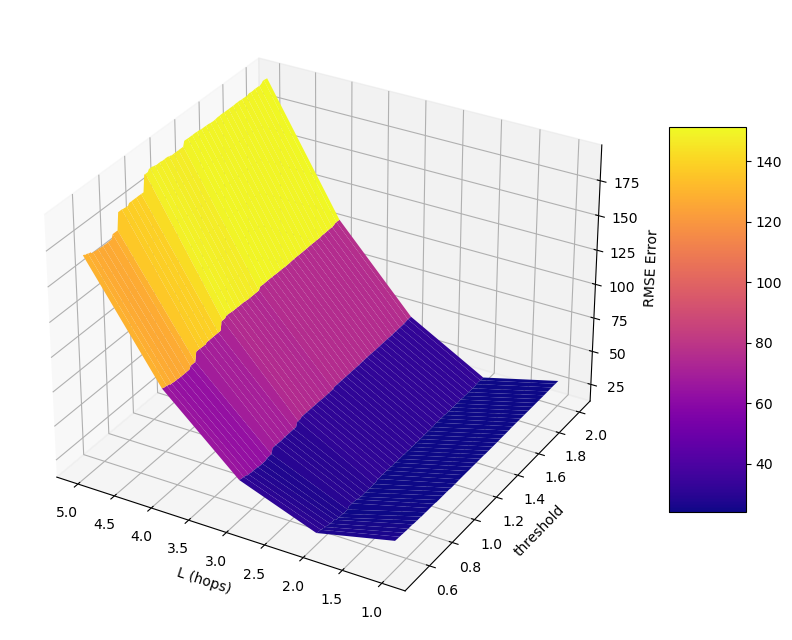

In [154]:
# # Plot loss against threshold and L (hops)
# error_metric = 'rmse'

# alpha_range = np.linspace(0.1, 1.0, 10)
# threshold_range = np.linspace(0.5, 2.0, 160)
# L_range = np.arange(1, 6)

# loss = np.zeros((len(threshold_range), len(L_range)))
# for i, val1 in enumerate(threshold_range): 
#     for j, val2 in enumerate(L_range):
#         val1 = round(val1, 2)
#         val2 = round(val2, 2)
        
#         t_alpha = 0.222
#         # Use compute_error function to calculate error for the given parameters
#         loss[i][j] = compute_error(t_alpha, val1, val2, true_values, gap_indices, filled_data, euclidean, error_type=error_metric)
        
# X, Y = np.meshgrid(L_range, threshold_range)

# fig = plt.figure(figsize=(10, 10))
# ax = fig.add_subplot(111, projection='3d')

# lim1 = len(threshold_range)
# lim2 = len(L_range)
# surf = ax.plot_surface(X[:lim1, :lim2], Y[:lim1, :lim2], loss[:lim1, :lim2], cmap='plasma', linewidth=2)
# fig.colorbar(surf, shrink=0.5, aspect=5)
# ax.invert_xaxis()
# ax.set_xlabel('L (hops)')
# ax.set_ylabel('threshold')
# ax.set_zlabel(f'{error_metric.upper()} Error')  # Display the error metric in uppercase

# shape = np.unravel_index(loss.argmin(), loss.shape)
# print(f'Hops: {X[shape]}')
# print(f'Threshold: {Y[shape]}')
# print(f'Minimum {error_metric.upper()} Error: {np.min(loss)}')


In [155]:
# print(compute_error(0.12, 1.3, 3, true_values, gap_indices, filled_data, euclidean, error_type='rmse'))
# print(compute_error(0.22, 1.3, 2, true_values, gap_indices, filled_data, euclidean, error_type='rmse'))
# print(compute_error(0.22, 1.1, 2, true_values, gap_indices, filled_data, euclidean, error_type='rmse'))

17.003856734982527
16.552428401905107
17.060026537198766


In [156]:
# rmse_err = compute_error(0.2218, 1.06, 2, true_values, gap_indices, filled_data, euclidean, error_type='rmse')
# smape_err = compute_error(0.2218, 1.06, 2, true_values, gap_indices, filled_data, euclidean, error_type='smape')
# print(f'RMSE Error: {rmse_err}')
# print(f'SMAPE Error: {smape_err}')

RMSE Error: 17.209843451166996
SMAPE Error: 0.24550502400329907


## Scale to full dataset

In [439]:
print(species)
print(grouped.shape)

PM10
(9133, 174)


In [440]:
# Initialise dataset with estimated interpolated values
order = 3
filled_data = grouped.interpolate(method='polynomial', order=order, axis=0)

# Check if there are still NaN values after interpolation
remaining_gaps = filled_data.isna().sum().sum()

if remaining_gaps > 0:
    print(f"Applying fill with annual mean concentrations for {remaining_gaps} remaining NaN values.")
    
    # Group by year and fill NaN values with the mean of each group
    filled_data = filled_data.groupby(filled_data.index.year.rename('year')).apply(lambda group: group.fillna(group.mean()))

    # Check if there are still NaN values after filling with the annual means
    remaining_gaps = filled_data.isna().sum().sum()

    if remaining_gaps > 0:
        print(f"Applying second interpolation to fill {remaining_gaps} remaining NaN values.")

        # Interpolate NaN values along the "year" index
        filled_data = filled_data.interpolate(method='linear', axis=0)

        # Check if there are still NaN values after interpolation
        remaining_gaps = filled_data.isna().sum().sum()

        if remaining_gaps > 0:
            print(f"Applying fill with station mean concentrations for {remaining_gaps} remaining NaN values.")
            
            # Fill NaN values with the mean of each station
            filled_data = filled_data.fillna(filled_data.mean())


    # Drop the additional "year" index created by groupby
    filled_data.reset_index(level='year', drop=True, inplace=True)

    print(f"Remaining NaN values after filling: {filled_data.isna().sum().sum()}")

# Compute euclidean distance matrix
euclidean = euclidean_AM(filled_data)

Applying fill with annual mean concentrations for 945472 remaining NaN values.
Applying second interpolation to fill 897315 remaining NaN values.
Applying fill with station mean concentrations for 588472 remaining NaN values.
Remaining NaN values after filling: 0


In [441]:
print(tuned_alpha_daily)
print(tuned_hop_daily)
print(tuned_threshold_daily)

# DAILY
Z, A = compute_propagation_matrix(filled_data, euclidean, threshold=tuned_threshold_daily, L=tuned_hop_daily, alpha=tuned_alpha_daily)

# HOURLY
# Z, A = compute_propagation_matrix(filled_data, euclidean, threshold=1.66, L=2, alpha=0.216)

0.20400000000000001
2
1.52


In [442]:
# Pass the true values to the propagated array

# Make a copy of array 'Z'
propagated_result: np.ndarray = np.copy(Z)

# Iterate over each column in the original 'grouped' DataFrame along with its index
for (i, column) in enumerate(grouped):
    # Iterate over each entry in the current column of the 'grouped' DataFrame along with its index
    for (j, entry) in enumerate(np.asarray(grouped[column])):
        # Check if the entry is not NaN i.e. it's an original observation 
        if not np.isnan(entry):
            # If the entry is not NaN, update the corresponding element in the 'corrected' array with the entry value
            propagated_result[j][i] = entry


In [443]:
#Get adjacency matrix from propagated data
propagated_df = pd.DataFrame(propagated_result, columns = grouped.columns.unique(), index = grouped.index.unique())
adjacency_matrix = euclidean_AM(propagated_df)

In [444]:
data_filename

'LAQN_PM10_1996-01-01_2021-01-01.csv'

In [445]:
# Save the completed dataset to a new CSV file
propagated_df.to_csv(f'complete_{data_filename}')

# Plotting

In [41]:
def group_dataframe(df, freq='M'):
    grouped_df = df.copy() 
    grouped_df = grouped_df.reset_index(level=0)
    grouped_df['date'] = pd.to_datetime(grouped_df.date)
    grouped_df = grouped_df.groupby(pd.Grouper(key="date", freq=freq)).mean()
    return grouped_df

In [43]:
inds = [0, 25, 50, 75, 100, 125, 150, 175, 200]
vals = [np.array(similarity.columns)[i] for i in inds] 
vals

['TD0', 'BL0', 'EA7', 'HF2', 'IS6', 'HP1', 'SK2', 'WAC', 'CE2']

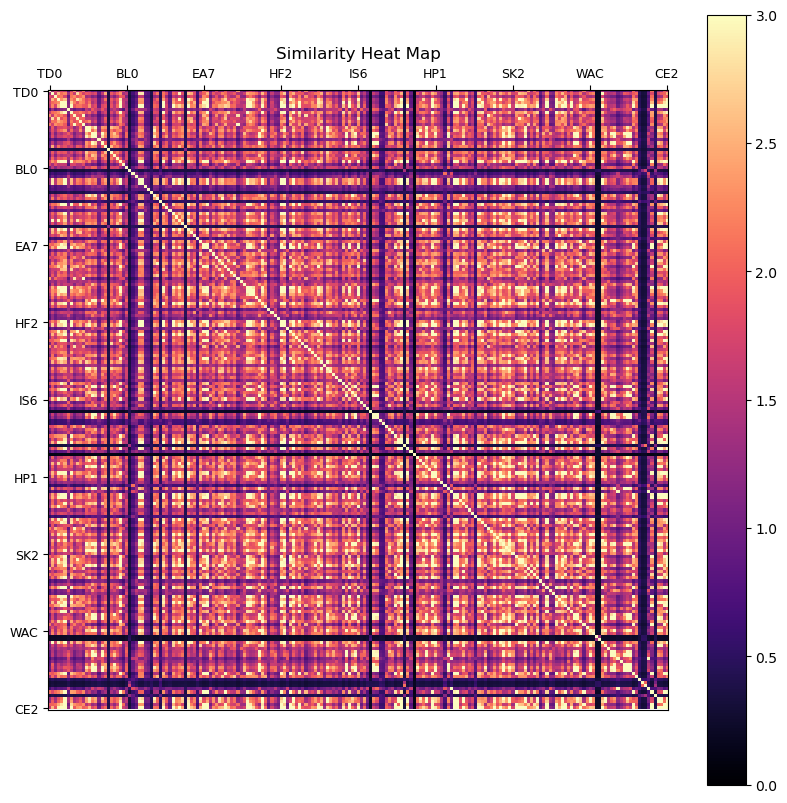

In [44]:
plt.figure(figsize=(10, 10))
sim_heat = np.fill_diagonal(similarity.values, 3)
plt.imshow(similarity, cmap='magma', interpolation='nearest', vmin=0, vmax=3)
plt.title('Similarity Heat Map')
plt.xticks(plt.xticks()[0][1:10], labels=vals[:9], fontsize=9)
plt.yticks(plt.yticks()[0][1:10], labels=vals[:9], fontsize=9)
# print(plt.xticks()[0].size)
plt.tick_params(top=True, labeltop=True)
plt.tick_params(bottom=False, labelbottom=False)
plt.colorbar()
plt.show()

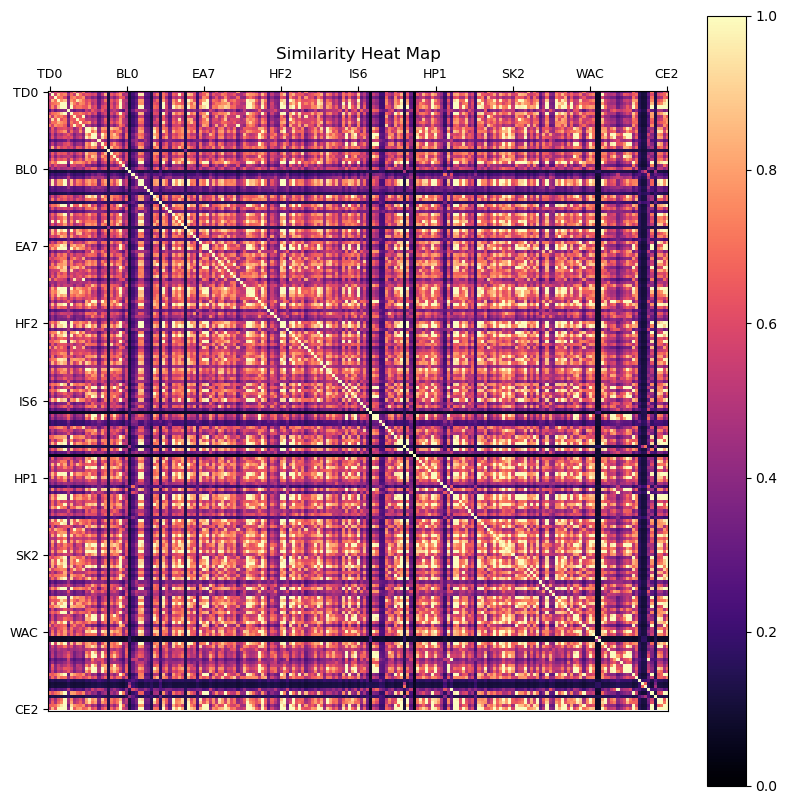

In [45]:
plt.figure(figsize=(10, 10))
sim_heat = np.fill_diagonal(similarity.values, 3)
plt.imshow(similarity/3, cmap='magma', interpolation='nearest', vmin=0, vmax=1)
plt.title('Similarity Heat Map')
plt.xticks(plt.xticks()[0][1:10], labels=vals[:9], fontsize=9)
plt.yticks(plt.yticks()[0][1:10], labels=vals[:9], fontsize=9)
# print(plt.xticks()[0].size)
plt.tick_params(top=True, labeltop=True)
plt.tick_params(bottom=False, labelbottom=False)
plt.colorbar()
plt.show()

## Setup

In [46]:
similarity

,TD0,BG3,BG1,BG2,BN2,BN3,BN1,BX5,BX2,BQ7,...,MY1,WM6,WMZ,WMB,CE1,NB1,WM8,WM9,VS1,CE2
TD0,3.000000,1.290722,1.785777,1.526988,1.725434,1.590650,0.778688,1.615769,2.317718,1.430220,...,0.387649,0.282293,0.294118,0.615510,2.092974,0.345029,1.200366,1.264137,1.974765,1.596211
BG3,1.290722,3.000000,1.702315,2.552255,2.080852,2.246854,1.330836,2.071790,1.610157,2.775149,...,0.491247,0.336050,0.353837,0.915628,1.792361,0.425303,1.791602,1.942179,1.997717,2.540057
BG1,1.785777,1.702315,3.000000,2.079062,2.148671,1.736370,0.894686,2.141925,2.285778,1.933991,...,0.419934,0.300109,0.312708,0.694051,2.073023,0.369593,1.333813,1.417411,2.077439,1.869956
BG2,1.526988,2.552255,2.079062,3.000000,2.327315,2.595863,1.136415,2.301890,2.054073,2.840724,...,0.463897,0.324818,0.340103,0.851050,2.232651,0.408156,1.863948,1.995681,2.497830,2.951407
BN2,1.725434,2.080852,2.148671,2.327315,3.000000,3.067308,1.106318,2.736103,2.191215,1.867142,...,0.461672,0.313942,0.328931,0.804571,2.553463,0.395408,2.115241,2.250553,2.826977,3.173861
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NB1,0.345029,0.425303,0.369593,0.408156,0.395408,0.410131,0.547109,0.407616,0.362268,0.402111,...,0.831176,1.063428,1.396981,0.749587,0.367732,3.000000,0.452464,0.443091,0.379442,0.413795
WM8,1.200366,1.791602,1.333813,1.863948,2.115241,2.974609,1.387349,2.238954,1.365459,1.552483,...,0.521261,0.345894,0.364967,1.079315,1.699810,0.452464,3.000000,4.729884,1.940596,3.123022
WM9,1.264137,1.942179,1.417411,1.995681,2.250553,3.289198,1.356456,2.410986,1.450706,1.672452,...,0.509786,0.339894,0.358842,1.030677,1.847285,0.443091,4.729884,3.000000,2.127212,3.547928
VS1,1.974765,1.997717,2.077439,2.497830,2.826977,3.939794,0.979182,2.769208,2.324538,2.171220,...,0.435006,0.304559,0.318449,0.747488,7.240797,0.379442,1.940596,2.127212,3.000000,4.210776


In [47]:
species = "NO2"
region = "London"
start_date = "1996-01-01"
end_date = "2021-01-01"

In [48]:
# Get LAQN site codes
url_sites = f"http://api.erg.kcl.ac.uk/AirQuality/Information/MonitoringSites/GroupName={region}/Json"
               
london_sites = requests.get(url_sites)
sites_df = pd.DataFrame(london_sites.json()['Sites']['Site'])
site_codes = sites_df["@SiteCode"].tolist()
print(len(site_codes))

252


In [49]:
# Get sites for each local authority
site_map = {} # map between local authority codes and list of sites belonging to that local authority
location_map = {} # map between local authority codes and local authority names
# local_codes = set(sites_df['@LocalAuthorityCode'].unique()) # 1 - 33
for i in range(1, 34):
    code = str(i)
    location_map[code] = sites_df[sites_df['@LocalAuthorityCode'] == code]['@LocalAuthorityName'].unique()[0]
    res = sites_df[sites_df['@LocalAuthorityCode'] == code]['@SiteCode']
    site_map[code] = []
    for j, site in res.items():
        site_map[code].append(site)

In [50]:
propagated_df

,TD0,BG3,BG1,BG2,BN2,BN3,BN1,BX5,BX2,BQ7,...,MY1,WM6,WMZ,WMB,CE1,NB1,WM8,WM9,VS1,CE2
date,,,,,,,,,,,,,,,,,,,,,
1996-01-01,37.507581,52.233017,56.168644,47.731189,43.188308,37.796410,60.934612,55.190789,40.979851,49.284198,...,62.923796,136.822020,134.693071,76.450214,33.796686,116.191098,46.501742,46.344521,36.208572,42.973436
1996-01-02,37.292531,51.977328,55.934184,47.499557,42.958234,37.559611,60.647386,54.962401,40.753224,49.052444,...,62.903320,136.822020,134.693071,76.322768,33.637675,116.181048,46.218659,46.093412,36.043127,42.735083
1996-01-03,37.333302,52.024634,55.989020,47.552799,43.009540,37.620218,60.792011,55.011730,40.799562,49.106129,...,62.922385,136.822020,134.693071,76.453414,33.636444,116.190786,46.341745,46.174366,36.047729,42.796714
1996-01-04,37.054024,51.813521,55.704618,47.240483,42.697558,37.309992,60.473896,54.700447,40.487856,48.794181,...,62.889631,136.822020,134.693071,76.211265,33.413268,116.171000,46.016810,45.844735,35.819647,42.486752
1996-01-05,36.794620,51.693036,55.459205,46.999012,42.456823,37.066789,60.262052,54.459918,40.247479,48.552484,...,62.889739,136.822020,134.693071,76.092315,33.164455,116.168222,45.789006,45.603159,35.572210,42.244118
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-28,26.584611,25.099513,24.366667,27.545833,34.799909,35.724431,43.078017,33.733327,22.212500,20.458333,...,33.345833,39.875000,50.410340,35.991667,27.179515,42.279167,49.093869,47.304713,29.360315,35.054167
2020-12-29,24.340444,23.076929,17.800000,21.562500,32.467785,33.437571,40.751812,31.391597,21.145833,20.295833,...,28.591667,38.141667,49.405880,31.900000,25.038020,35.045833,46.826891,44.984547,27.110286,31.183333
2020-12-30,30.124256,28.398039,43.995833,37.029167,38.657695,39.414724,47.262635,37.465465,38.704167,39.708333,...,51.679167,54.275000,53.496910,45.766667,56.890909,51.512500,52.975002,51.266108,32.840771,44.250000


## Time Series Plots (grouped by day)

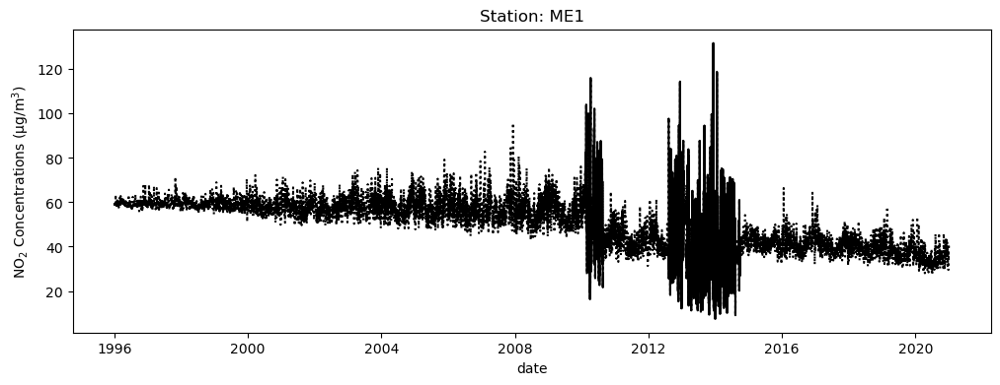

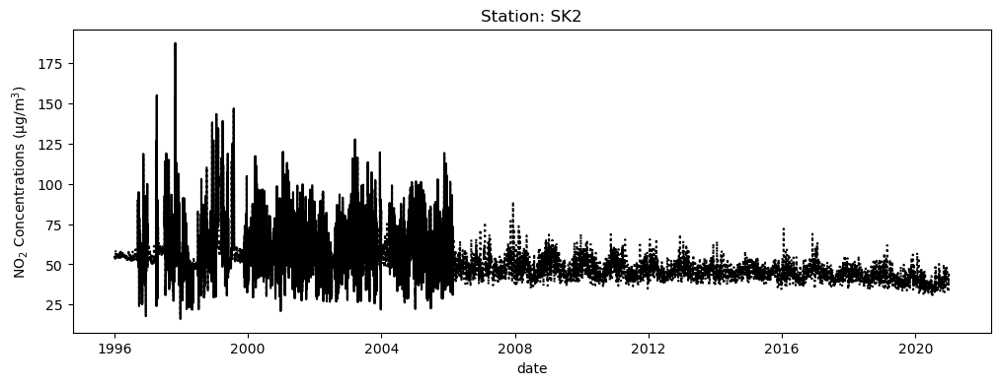

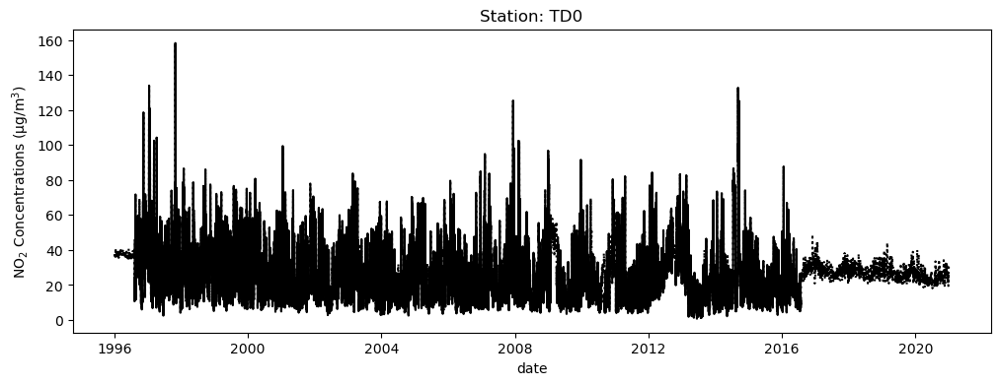

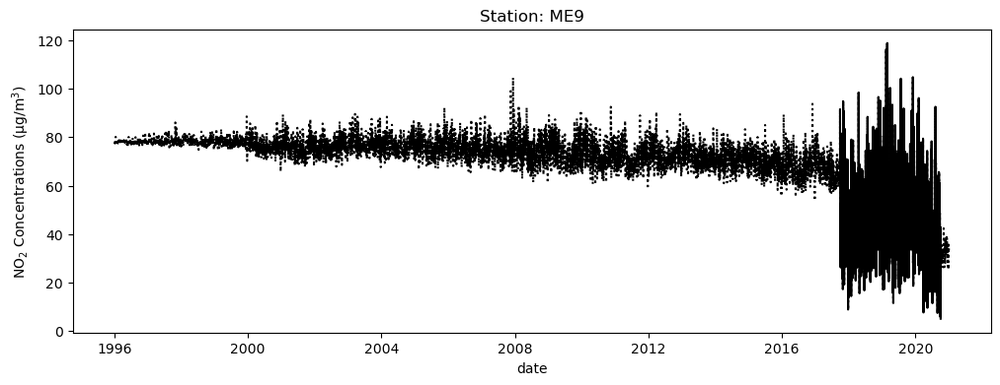

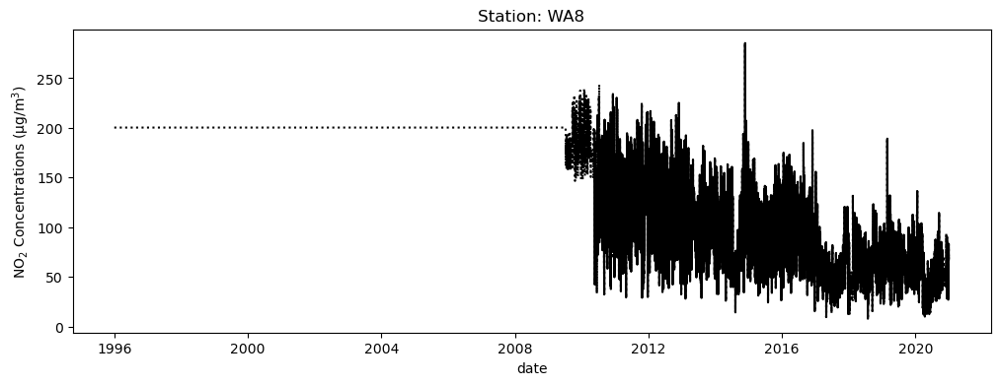

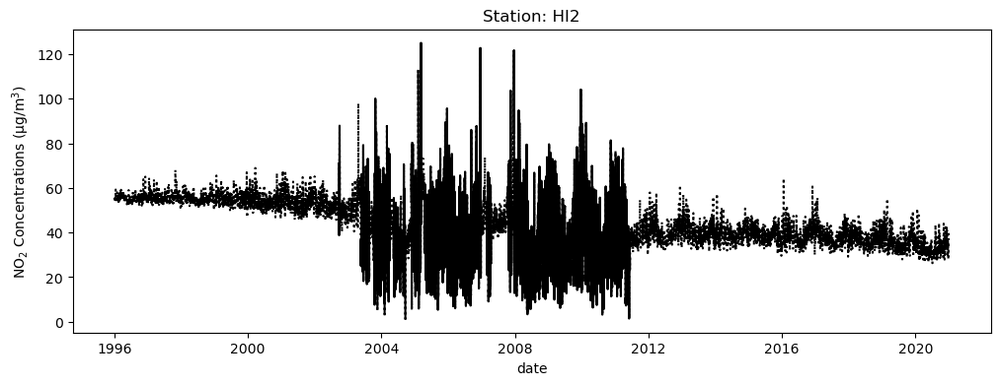

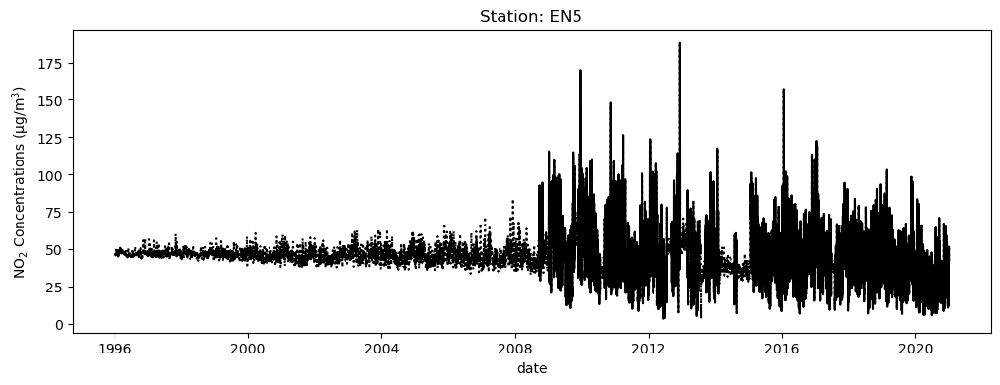

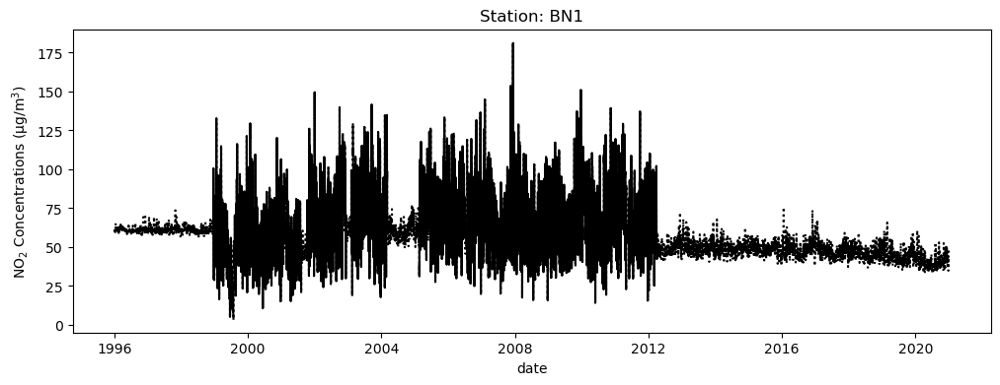

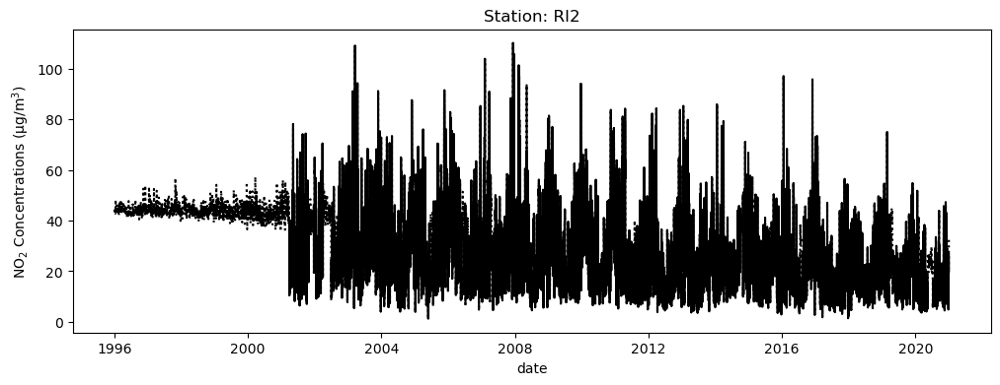

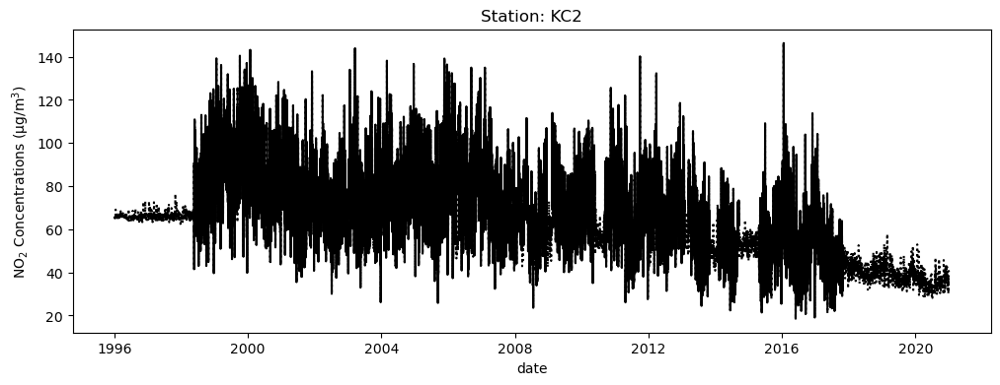

In [51]:
dates = propagated_df.index.values
stations = {'TD0', 'EN5', 'BN1', 'SK2', 'KC2', 'HI2'}
while len(stations) < 10:
    sample = np.random.choice(data.df.columns.values[1:], 1)[0]
    stations.add(sample)
    
for index, station in enumerate(stations):
    plt.figure(index, figsize=(12, 4))
    plt.plot(dates, propagated_df[station].values, color='black', linestyle='dotted')
    plt.plot(dates, grouped[station].values, color='black')
    plt.title(f'Station: {station}')
    plt.xlabel('date', fontsize=10)
    plt.ylabel('NO$_{2}$ Concentrations (µg/m$^3$)', fontsize=10)

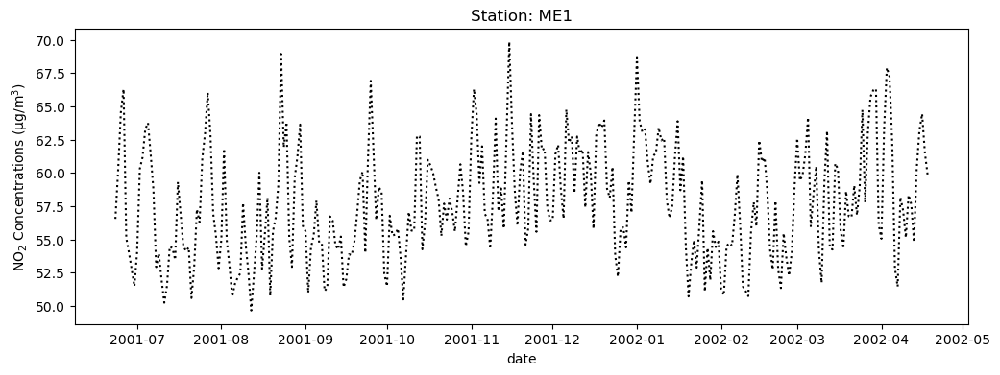

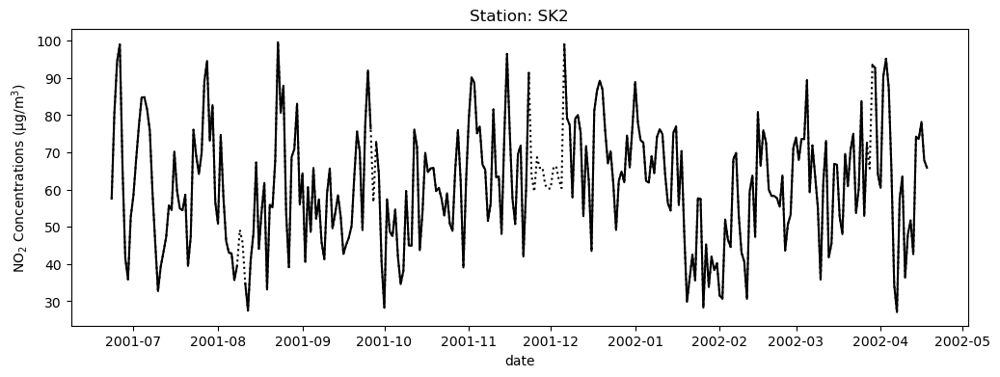

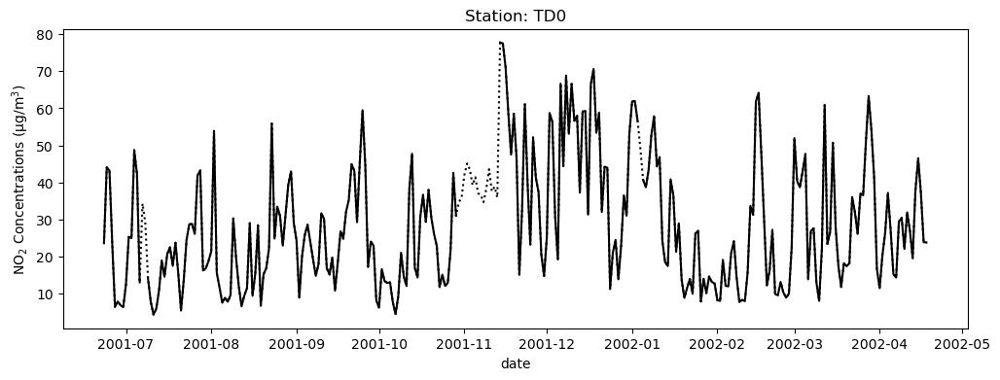

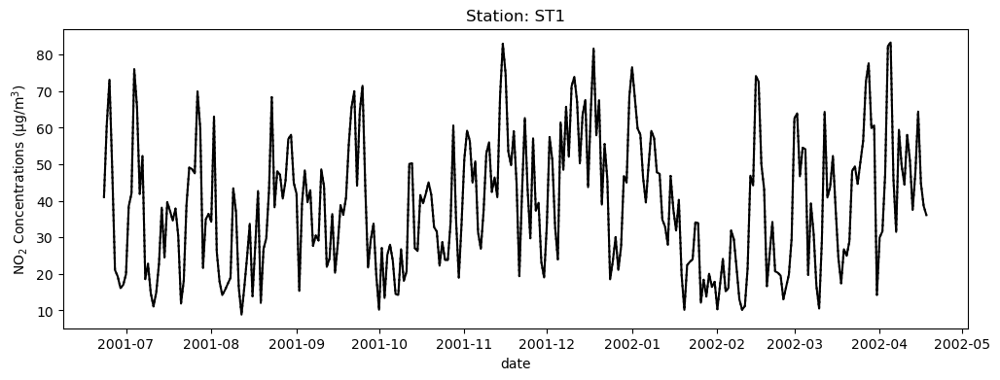

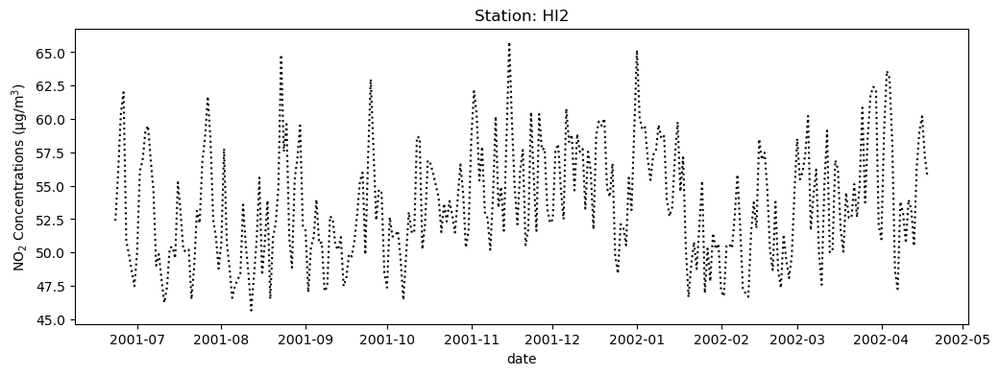

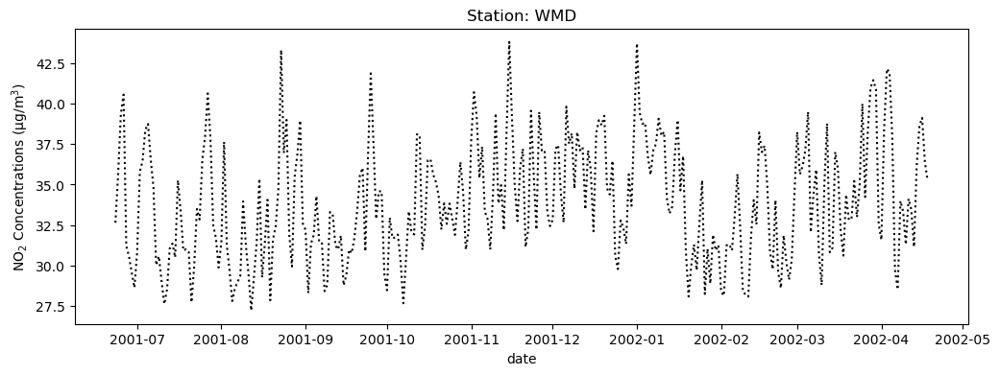

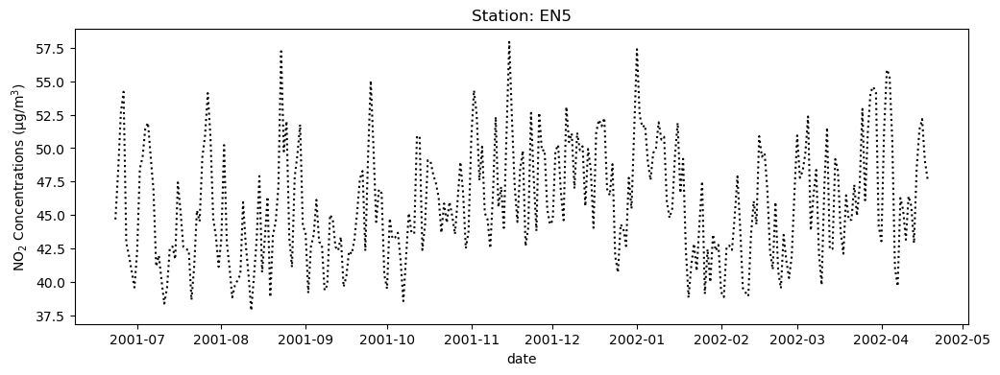

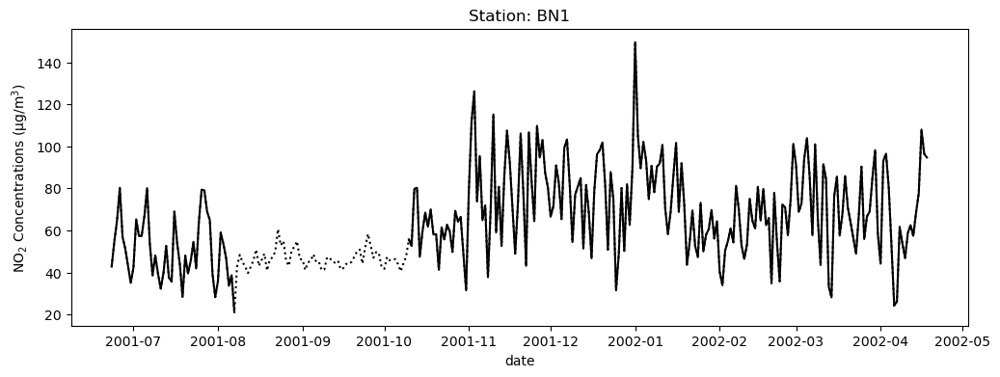

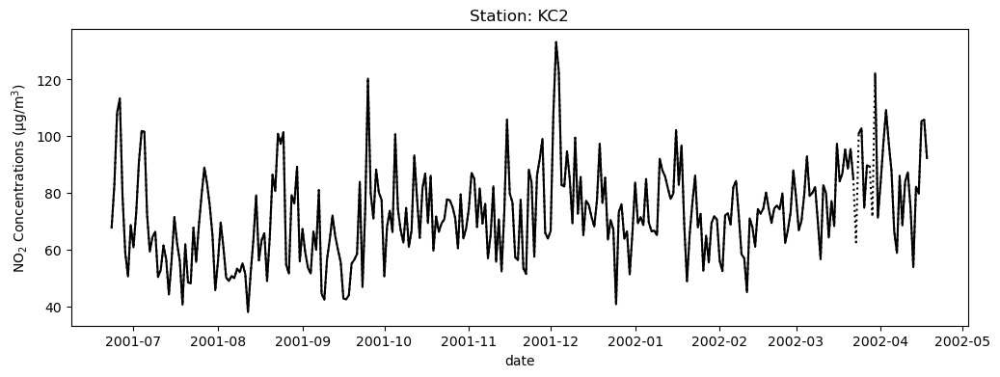

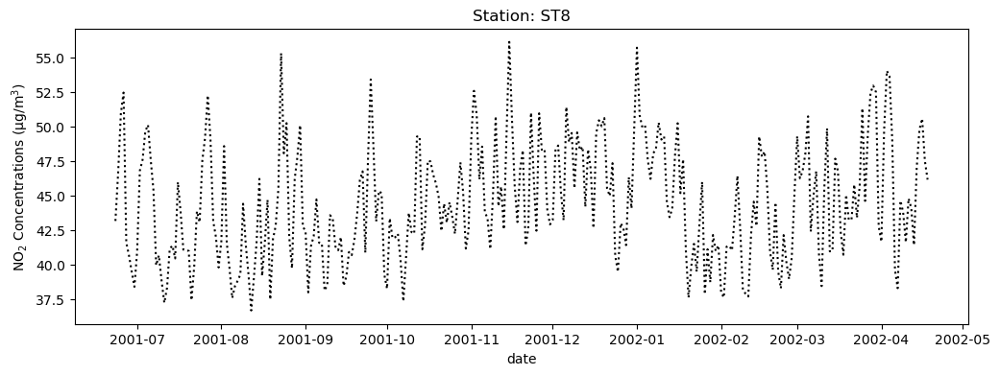

In [52]:
dates = propagated_df.index.values
stations = {'TD0', 'EN5', 'BN1', 'SK2', 'KC2', 'HI2', 'ME1'}
while len(stations) < 10:
    sample = np.random.choice(data.df.columns.values[1:], 1)[0]
    stations.add(sample)

start = 2000
add = 300
for index, station in enumerate(stations):
    plt.figure(index, figsize=(12, 4))
    plt.plot(dates[start:start+add], propagated_df[station].values[start:start+add], color='black', linestyle='dotted')
    plt.plot(dates[start:start+add], grouped[station].values[start:start+add], color='black')
    plt.title(f'Station: {station}')
    plt.xlabel('date', fontsize=10)
    plt.ylabel('NO$_{2}$ Concentrations (µg/m$^3$)', fontsize=10)

## Time Series Plots (grouped by week)

In [53]:
grouped_W = group_dataframe(grouped, 'W')
propagated_df_W = group_dataframe(propagated_df, 'W')
# grouped_W
propagated_df_W

,TD0,BG3,BG1,BG2,BN2,BN3,BN1,BX5,BX2,BQ7,...,MY1,WM6,WMZ,WMB,CE1,NB1,WM8,WM9,VS1,CE2
date,,,,,,,,,,,,,,,,,,,,,
1996-01-07,37.034220,51.813951,55.689237,47.228667,42.685350,37.297789,60.475449,54.688248,40.475330,48.782075,...,62.893531,136.822020,134.693071,76.238372,33.356904,116.174513,46.012814,45.835390,35.765636,42.474768
1996-01-14,36.586141,51.447259,55.239619,46.784052,42.238082,36.860083,60.119777,54.240852,40.023522,48.338054,...,62.881204,136.822020,134.693071,76.117456,32.893361,116.167333,45.597663,45.386415,35.303362,42.037792
1996-01-21,37.954695,52.668862,56.629634,48.282179,43.735040,38.310962,61.615647,55.734745,41.517801,49.836143,...,62.999104,136.822020,134.693071,76.980779,34.152041,116.236542,47.094912,46.953064,36.573205,43.490323
1996-01-28,37.195134,51.948127,55.865011,47.387732,42.844819,37.436545,60.600401,54.848474,40.635677,48.941562,...,62.891408,136.822020,134.693071,76.284569,33.493377,116.177925,46.119573,45.974253,35.901364,42.614157
1996-02-04,38.209600,52.782040,56.889217,48.470016,43.928269,38.482263,61.526050,55.932862,41.722944,50.023567,...,62.945294,136.822020,134.693071,76.657911,34.454385,116.210516,47.037409,46.959561,36.859354,43.660061
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-06,28.253931,26.593870,30.865813,32.738690,36.606563,37.470002,45.101095,35.490528,31.370238,27.619436,...,46.970000,49.773214,52.681580,47.957738,48.281315,48.550569,50.951075,49.182702,31.010760,36.516823
2020-12-13,28.754986,27.109769,32.027976,34.616667,37.175587,38.012606,45.767117,36.041072,33.960714,31.344643,...,54.849892,55.600595,53.968435,50.335119,49.726786,53.279324,51.508458,49.748501,31.504938,37.066461
2020-12-20,23.757735,22.600464,17.845859,16.372024,31.886438,32.837945,40.215501,30.834532,15.281548,11.656548,...,49.238853,36.325129,49.631286,28.614286,37.628571,38.147890,46.190627,44.342769,26.558512,31.846479


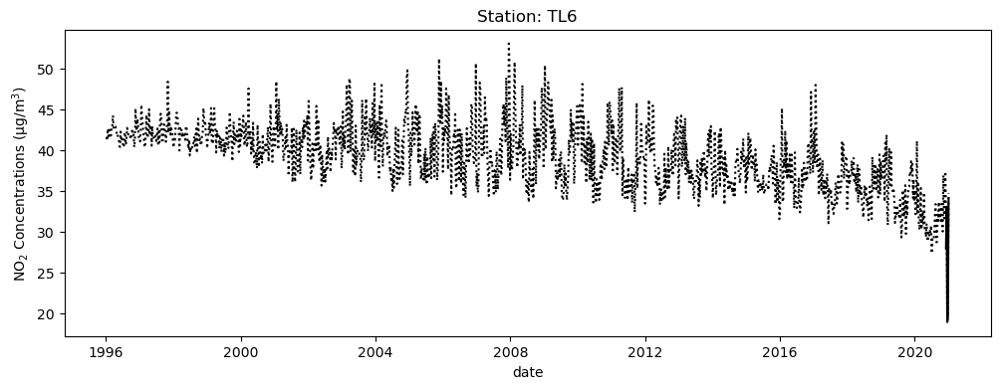

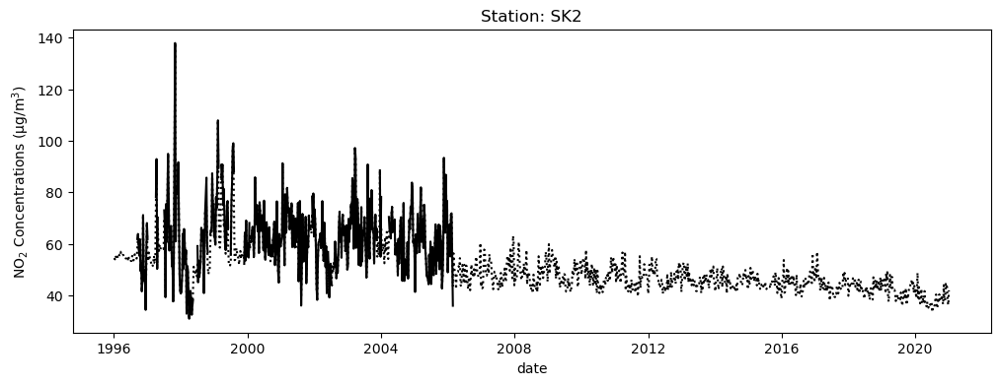

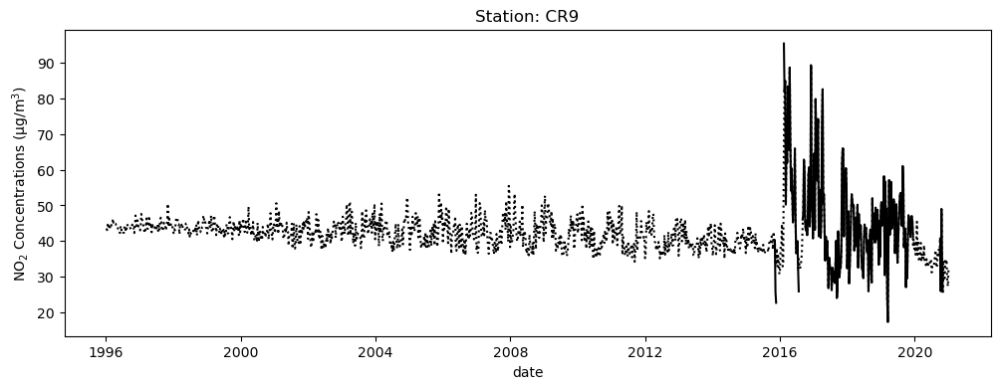

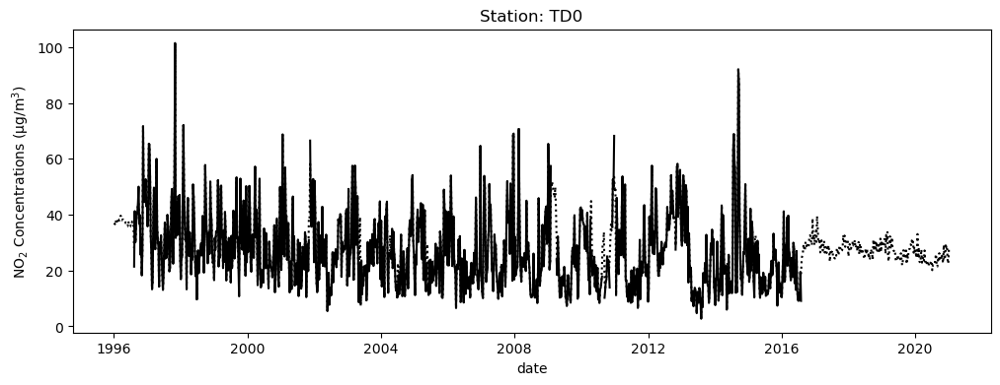

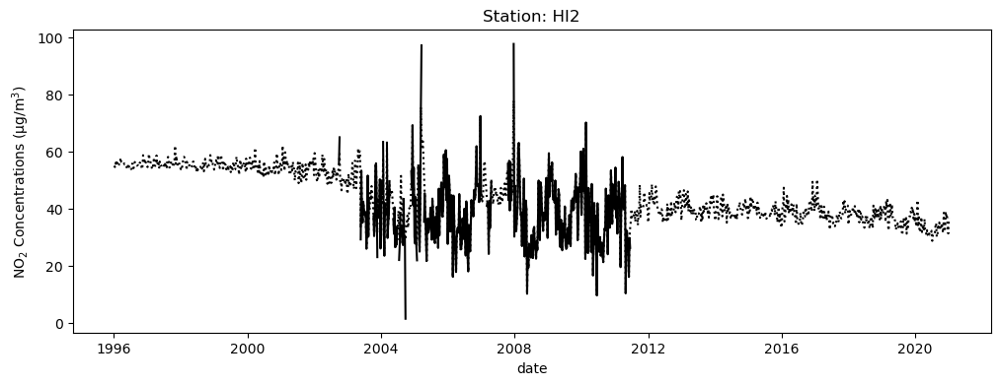

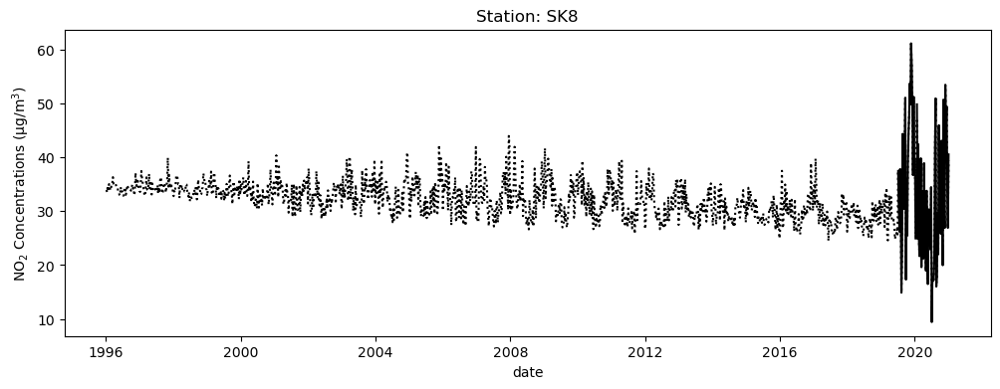

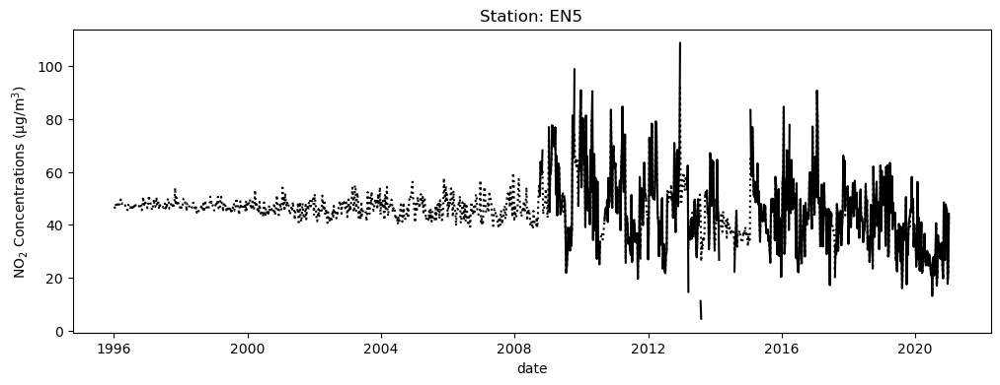

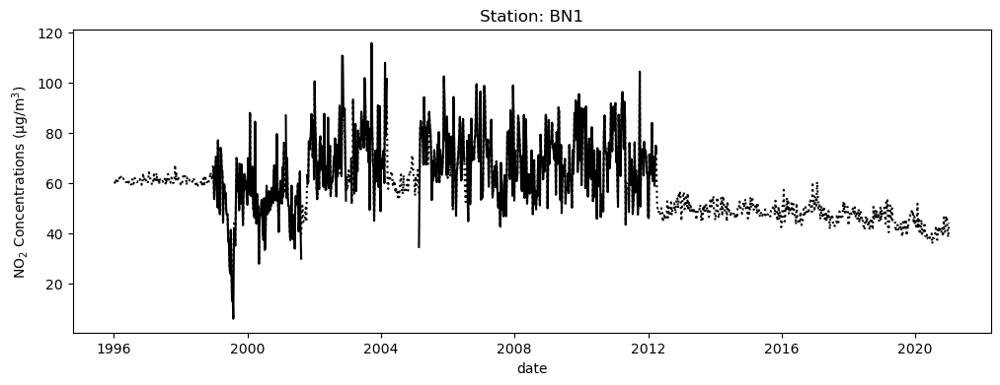

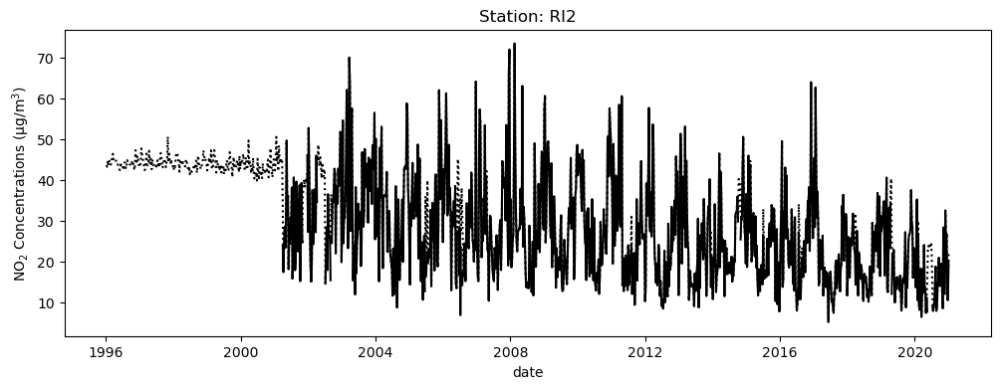

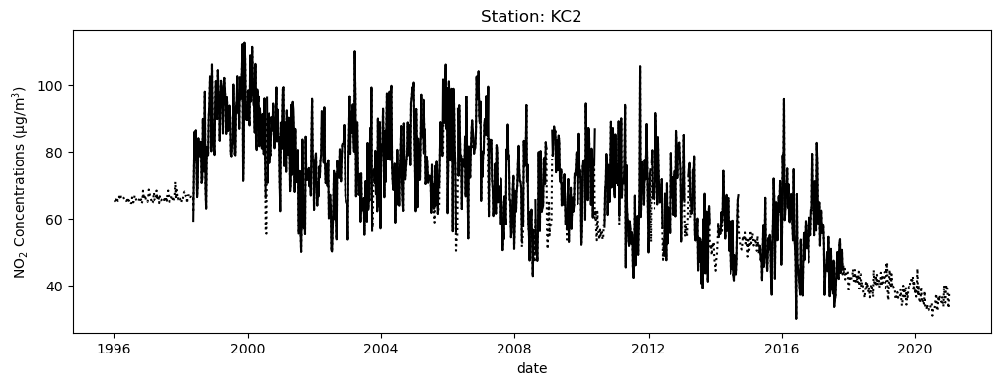

In [54]:
dates = propagated_df_W.index.values
stations = {'TD0', 'EN5', 'BN1', 'SK2', 'KC2', 'HI2'}
while len(stations) < 10:
    sample = np.random.choice(data.df.columns.values[1:], 1)[0]
    stations.add(sample)
    
for index, station in enumerate(stations):
    plt.figure(index, figsize=(12, 4))
    plt.plot(dates, propagated_df_W[station].values, color='black', linestyle='dotted')
    plt.plot(dates, grouped_W[station].values, color='black')
    plt.title(f'Station: {station}')
    plt.xlabel('date', fontsize=10)
    plt.ylabel('NO$_{2}$ Concentrations (µg/m$^3$)', fontsize=10)

## Time Series Plots (grouped by month)

In [55]:
grouped_M = group_dataframe(grouped, 'M')
propagated_df_M = group_dataframe(propagated_df, 'M')
grouped_M

,TD0,BG3,BG1,BG2,BN2,BN3,BN1,BX5,BX2,BQ7,...,MY1,WM6,WMZ,WMB,CE1,NB1,WM8,WM9,VS1,CE2
date,,,,,,,,,,,,,,,,,,,,,
1996-01-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-02-29,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-04-30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-05-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-30,NaN,NaN,15.708678,20.195882,NaN,NaN,NaN,NaN,17.275996,18.152685,...,43.638448,33.208424,NaN,38.059028,37.483254,44.959306,NaN,NaN,NaN,NaN
2020-10-31,NaN,NaN,15.216250,19.637032,NaN,NaN,NaN,NaN,16.037862,15.973358,...,44.516456,34.344477,NaN,35.108602,37.298700,44.596570,NaN,NaN,NaN,NaN
2020-11-30,NaN,NaN,26.637391,25.882917,NaN,NaN,NaN,NaN,25.207283,23.920610,...,45.566235,41.815169,NaN,36.478083,40.239861,45.299768,NaN,NaN,NaN,NaN


In [56]:
dates = propagated_df_M.index.values

### Find dates where months have missing data
missing_dates = grouped.loc[pd.isna(grouped['TD0']), :].index

In [57]:
# GET MISSING DATA PER MONTH

years = np.arange(1996, 2021)
months = np.arange(1, 13)

def missing_data_count(df):
    grouped_M = group_dataframe(df, 'M')
    res = pd.DataFrame(index=grouped_M.index, columns=grouped_M.columns)
    
    stations = df.columns.tolist()
    test = df.reset_index(level=0)
    
    i = 0
    for year in years:
        for month in months:
            sample_df = test[(test['date'].dt.year == year) & (test['date'].dt.month == month)]
            res.iloc[i] = sample_df.isna().sum().tolist()[1:]
            i += 1

    return res

def get_missing_dates(df, station):
    station_data = df[station]
    grouped_missing = station_data[station_data.isnull()]
    grouped_missing.iloc[:] = 1.0
    grouped_M_missing = group_dataframe(grouped_missing, 'M')
    test = grouped_M_missing.reset_index(level=0)
    missing_dates = test[test[station] == 1.0]['date'].tolist()
    return missing_dates

In [58]:
miss_count = missing_data_count(grouped)
# res.to_csv('random.csv')

missing_dates = get_missing_dates(grouped, 'TD0')
propagated_df_M['TD0'][missing_dates].values

array([37.26804739, 37.67320374, 38.4661104 , 37.93807492, 36.62595845,
       36.86137698, 36.58638745, 33.86319169, 42.18106041, 32.01609461,
       36.05225458, 38.73559607, 32.86821219, 21.59122607, 21.8878123 ,
       42.95653372, 29.81815356, 23.84831263, 27.13858832, 14.36199249,
       17.78814638, 20.52073231, 14.63932238, 40.9532907 , 44.13905877,
       45.22607221, 29.42249148, 40.89457097, 49.63750573, 46.89425145,
       31.42017226, 17.31688692, 24.23429259, 19.51679338, 31.40713464,
       48.98215906, 36.53649714, 35.04364809, 22.58824025, 16.85945349,
       25.75901369, 14.22419691, 26.76856215, 28.39090306, 29.92713448,
       31.61224722, 32.95975756, 34.30114028, 29.33016607, 28.89111082,
       28.33431111, 27.54664221, 26.35665278, 25.49460486, 26.17486829,
       27.42654121, 27.54776595, 30.69030815, 29.57922651, 28.20041421,
       29.46804491, 29.28312196, 27.91946604, 28.43980828, 25.42360153,
       26.75882097, 25.48850945, 27.09169722, 28.22615125, 28.74

In [59]:
dates

array(['1996-01-31T00:00:00.000000000', '1996-02-29T00:00:00.000000000',
       '1996-03-31T00:00:00.000000000', '1996-04-30T00:00:00.000000000',
       '1996-05-31T00:00:00.000000000', '1996-06-30T00:00:00.000000000',
       '1996-07-31T00:00:00.000000000', '1996-08-31T00:00:00.000000000',
       '1996-09-30T00:00:00.000000000', '1996-10-31T00:00:00.000000000',
       '1996-11-30T00:00:00.000000000', '1996-12-31T00:00:00.000000000',
       '1997-01-31T00:00:00.000000000', '1997-02-28T00:00:00.000000000',
       '1997-03-31T00:00:00.000000000', '1997-04-30T00:00:00.000000000',
       '1997-05-31T00:00:00.000000000', '1997-06-30T00:00:00.000000000',
       '1997-07-31T00:00:00.000000000', '1997-08-31T00:00:00.000000000',
       '1997-09-30T00:00:00.000000000', '1997-10-31T00:00:00.000000000',
       '1997-11-30T00:00:00.000000000', '1997-12-31T00:00:00.000000000',
       '1998-01-31T00:00:00.000000000', '1998-02-28T00:00:00.000000000',
       '1998-03-31T00:00:00.000000000', '1998-04-30

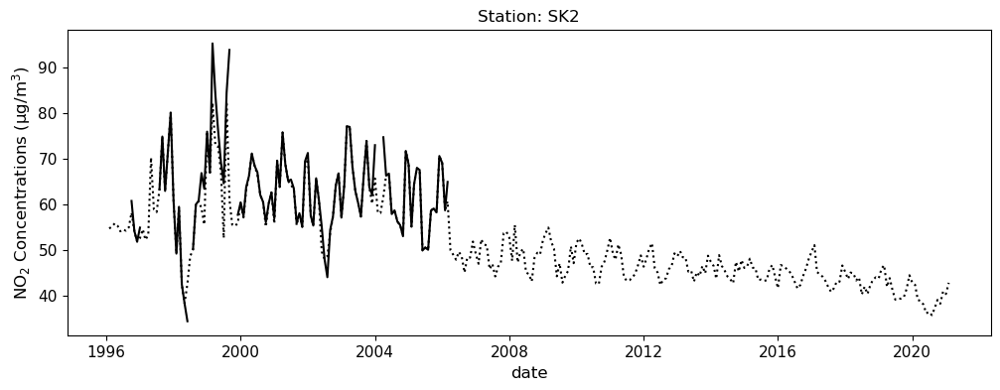

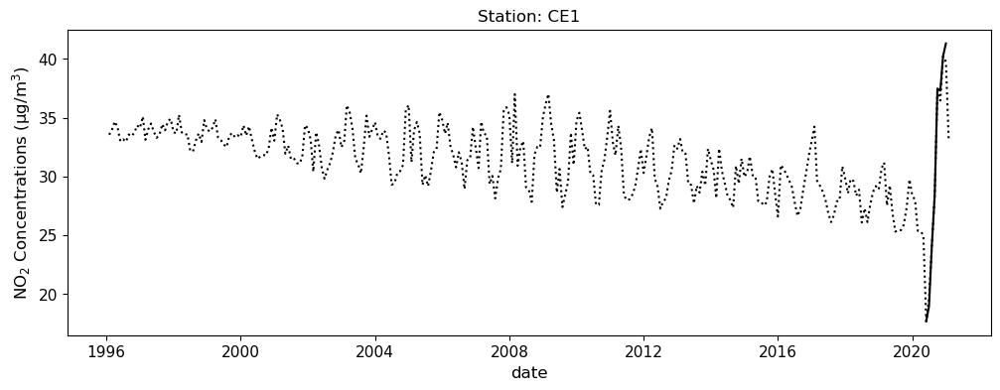

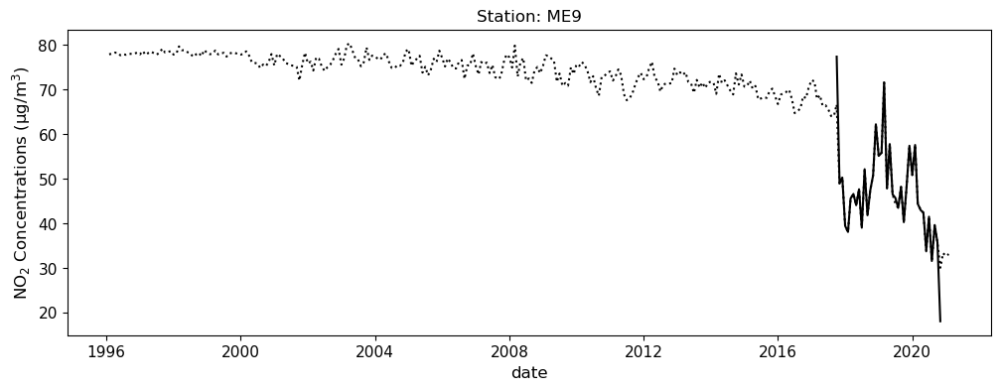

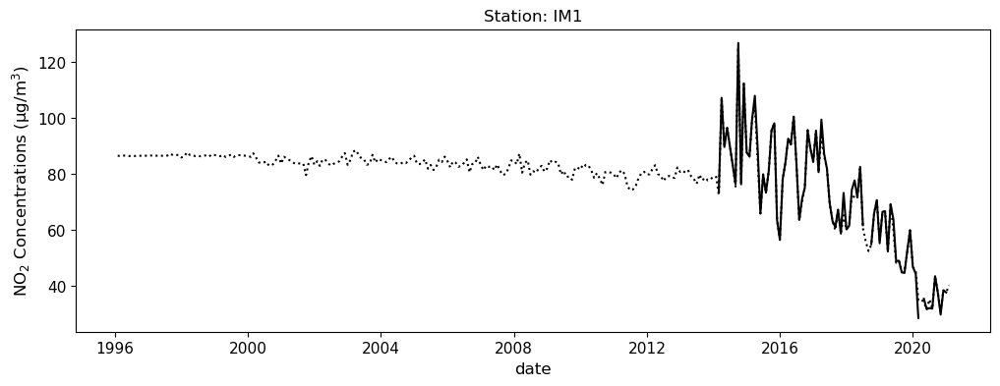

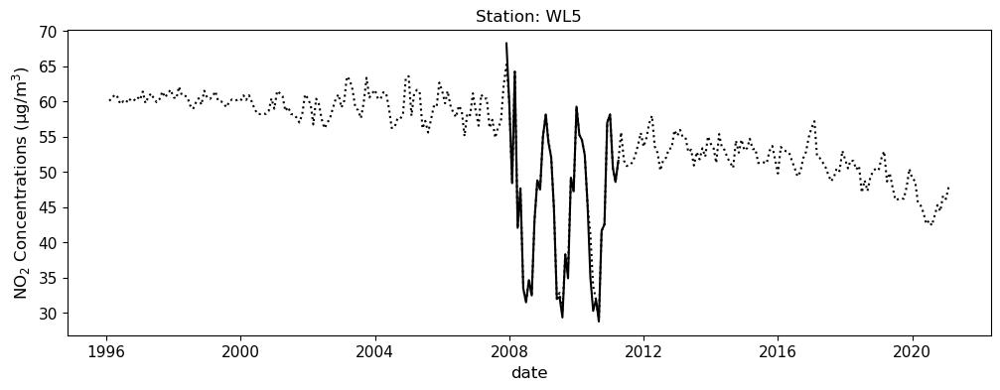

...

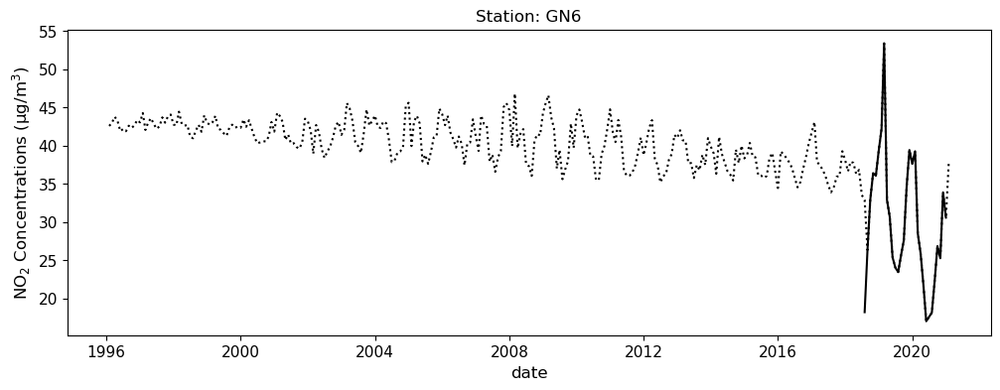

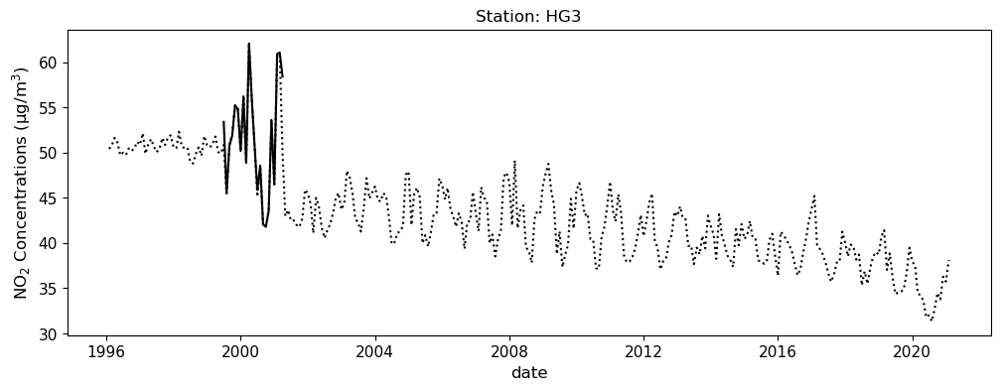

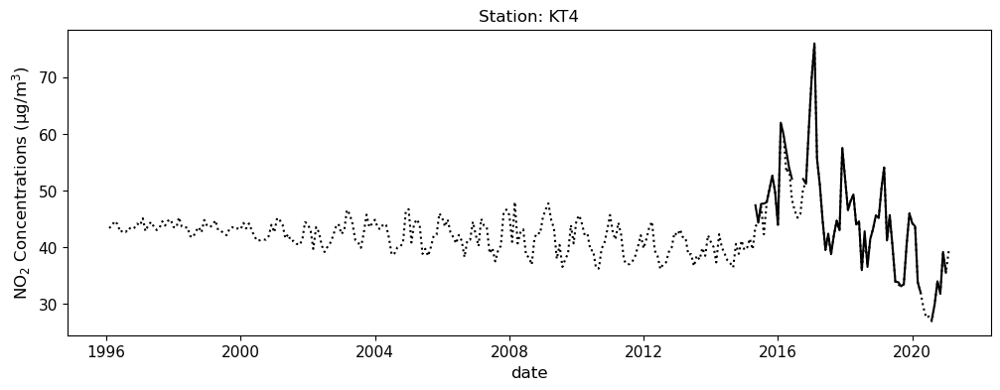

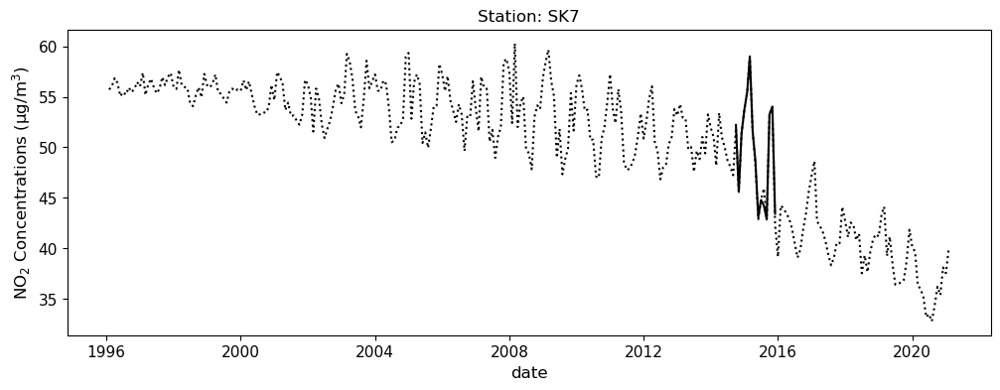

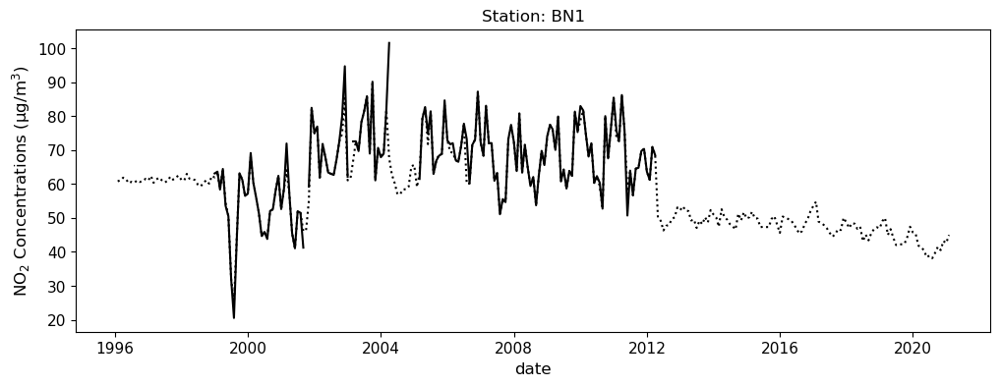

In [60]:
dates = propagated_df_M.index.values
stations = {'TD0', 'EN5', 'BN1', 'SK2', 'KC2', 'HI2', 'RI2', 'WM6', 'EA1'}
while len(stations) < 20:
    sample = np.random.choice(data.df.columns.values[1:], 1)[0]
    stations.add(sample)
    
for index, station in enumerate(stations):
    plt.figure(figsize=(12, 4))
    plt.plot(dates, propagated_df_M[station].values, color='black', linestyle='dotted')
    plt.plot(dates, grouped_M[station].values, color='black')
    plt.title(f'Station: {station}')
    plt.xlabel('date', fontsize=12)
    plt.ylabel('NO$_{2}$ Concentrations (µg/m$^3$)', fontsize=12)
    plt.xticks(fontsize=11)
    plt.yticks(fontsize=11)

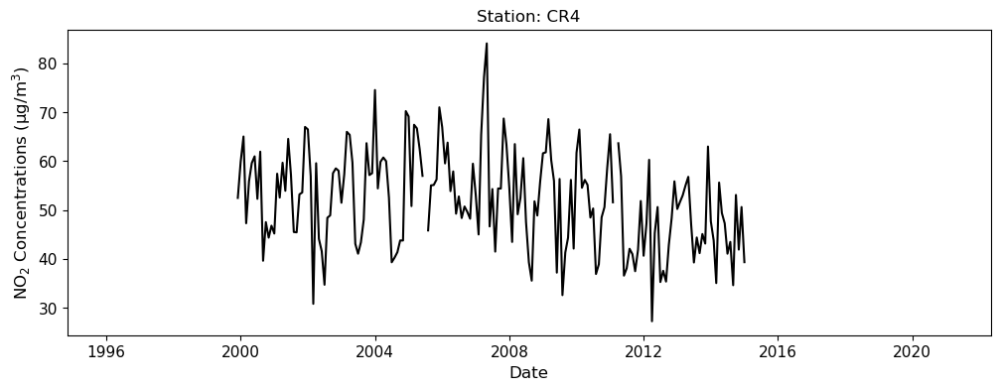

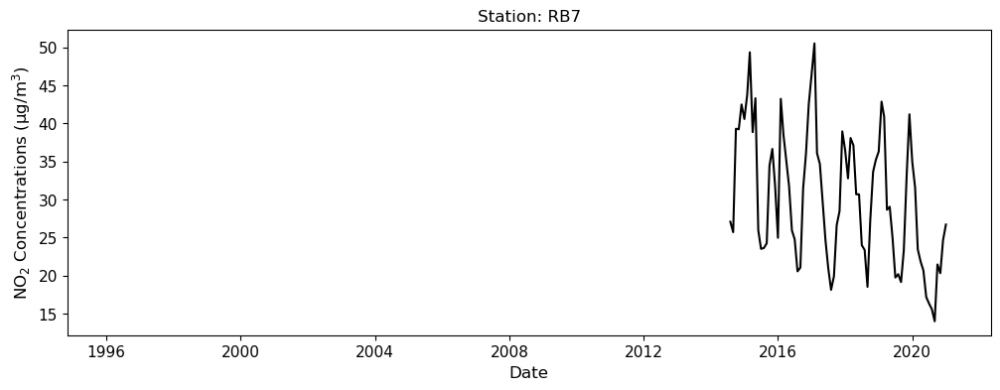

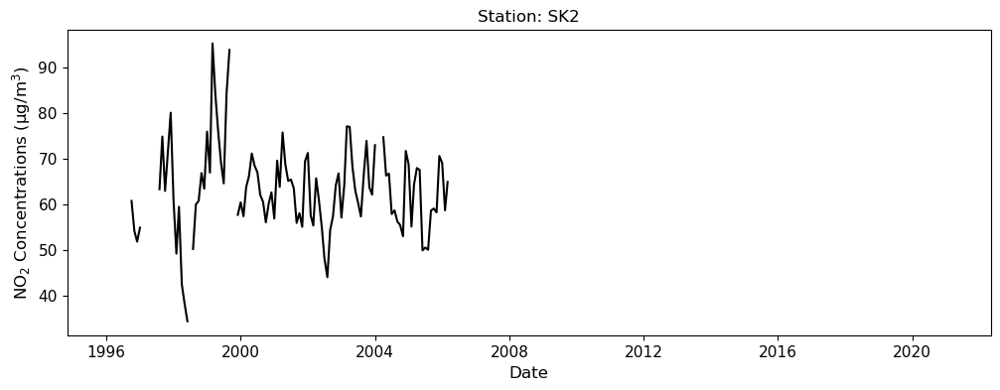

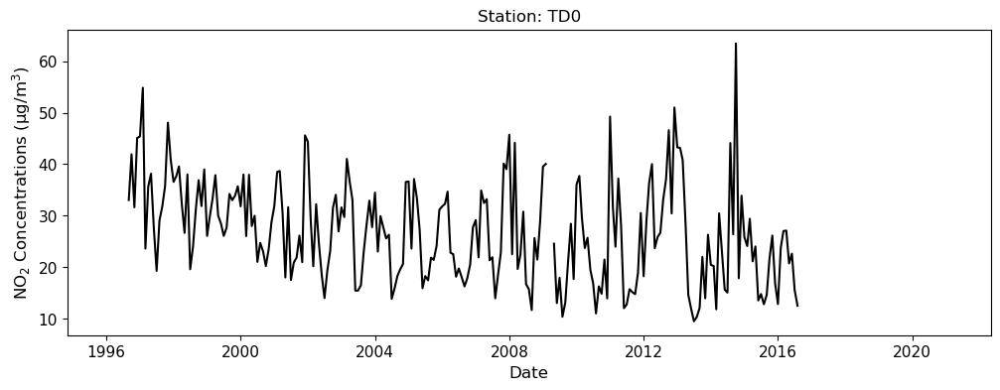

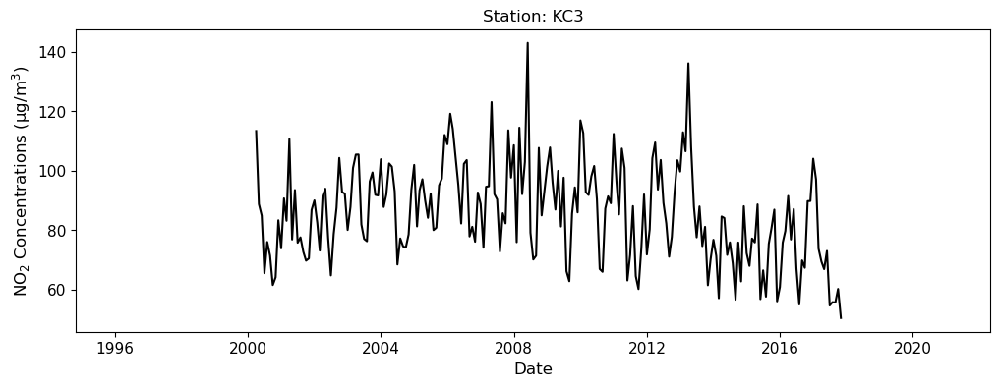

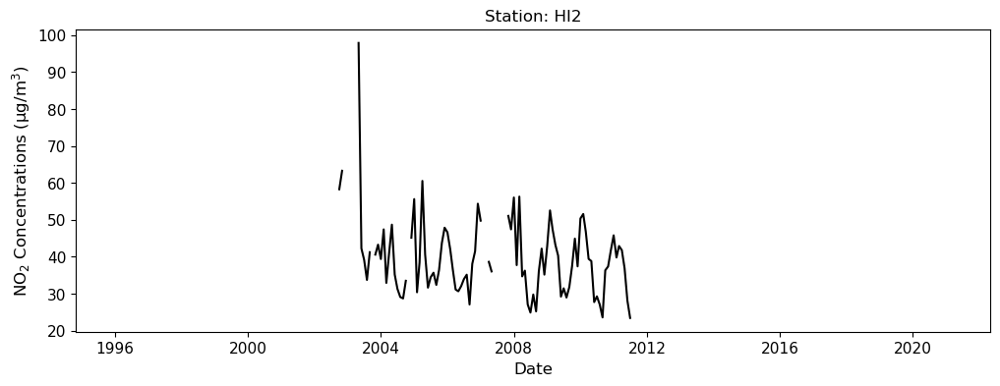

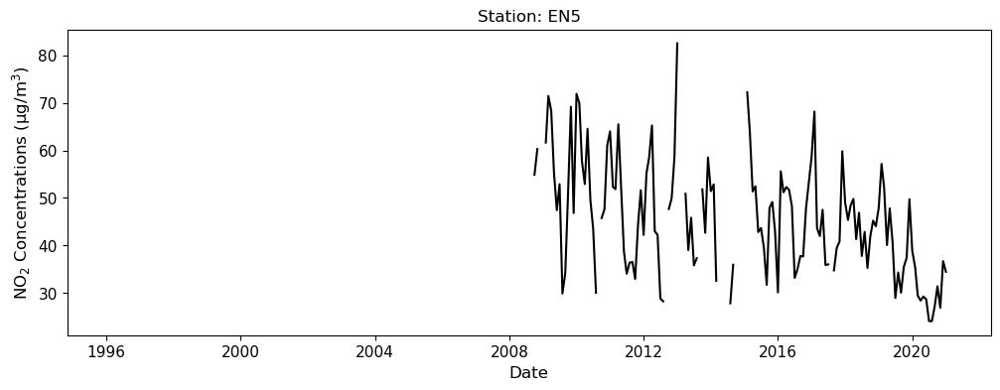

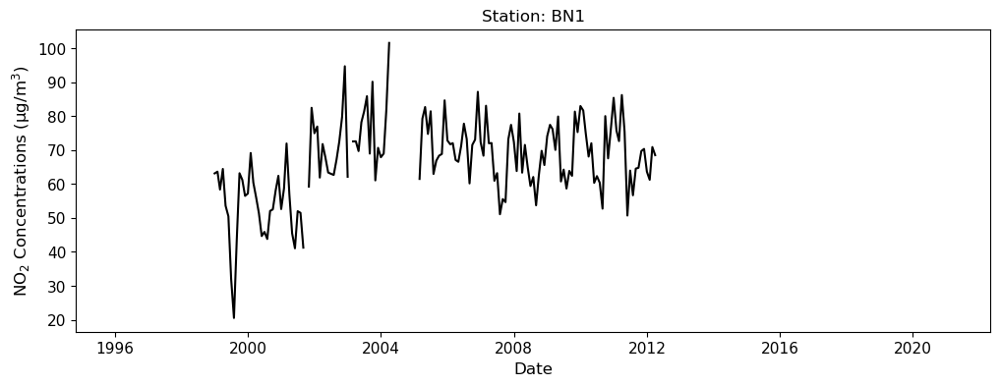

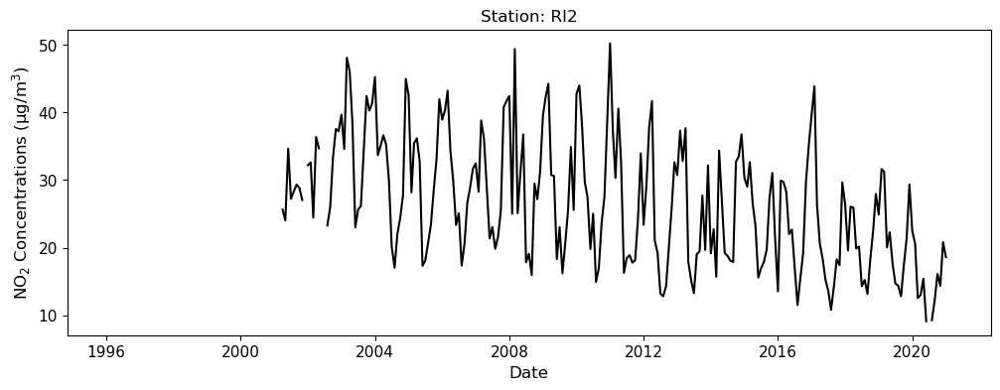

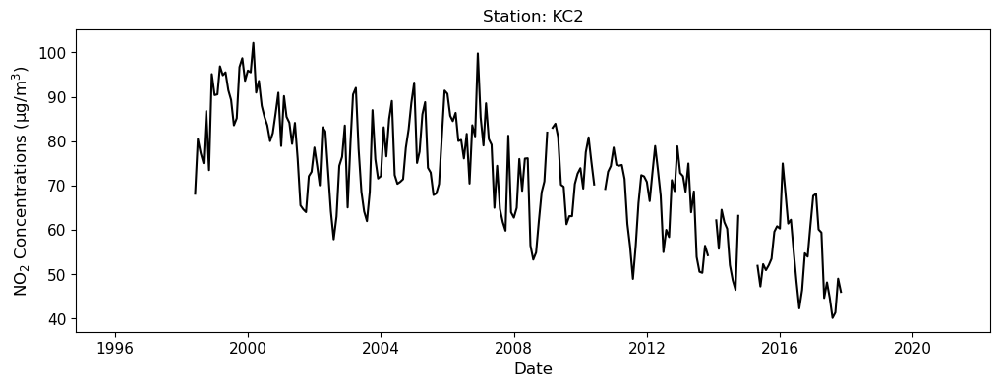

In [61]:
dates = propagated_df_M.index.values
stations = {'TD0', 'EN5', 'BN1', 'SK2', 'KC2', 'HI2', 'RI2'}
while len(stations) < 10:
    sample = np.random.choice(data.df.columns.values[1:], 1)[0]
    stations.add(sample)
    
for index, station in enumerate(stations):
    plt.figure(figsize=(12, 4))
#     plt.plot(dates, propagated_df_M[station].values, color='black', linestyle='dotted')
    plt.plot(dates, grouped_M[station].values, color='black')
    plt.plot(dates, [np.nanmean(grouped_M[station].values)]*301 , color='red', alpha= 0.0)
    plt.title(f'Station: {station}')
    plt.xlabel('Date', fontsize=12)
    plt.ylabel('NO$_{2}$ Concentrations (µg/m$^3$)', fontsize=12)
    plt.xticks(fontsize=11)
    plt.yticks(fontsize=11)
#     plt.xlim(date(1996, 1, 1), date(2021, 1, 1))

/var/folders/vx/67v_mlvx5n7064mfs84dyd900000gn/T/ipykernel_57409/3894908902.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(2*index, figsize=(12, 4))


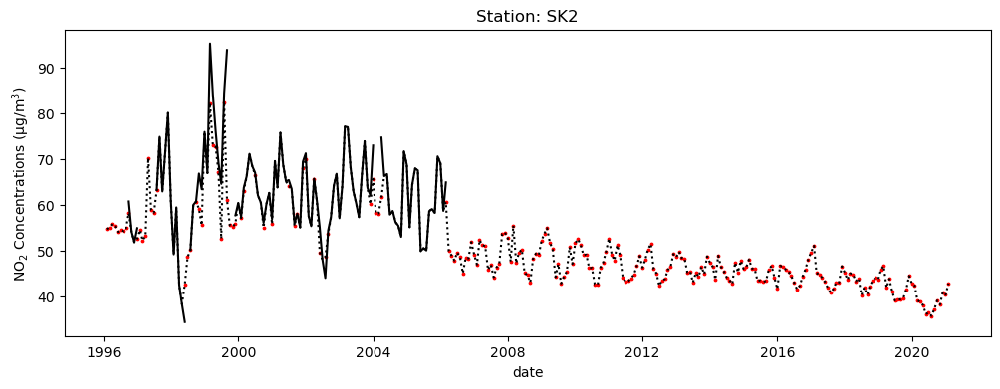

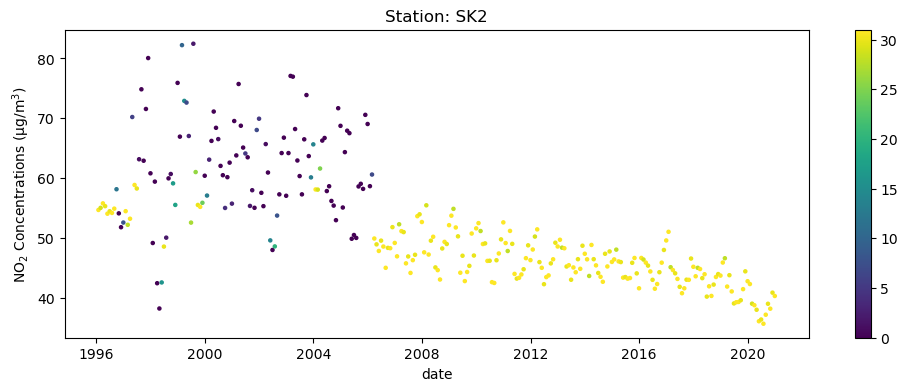

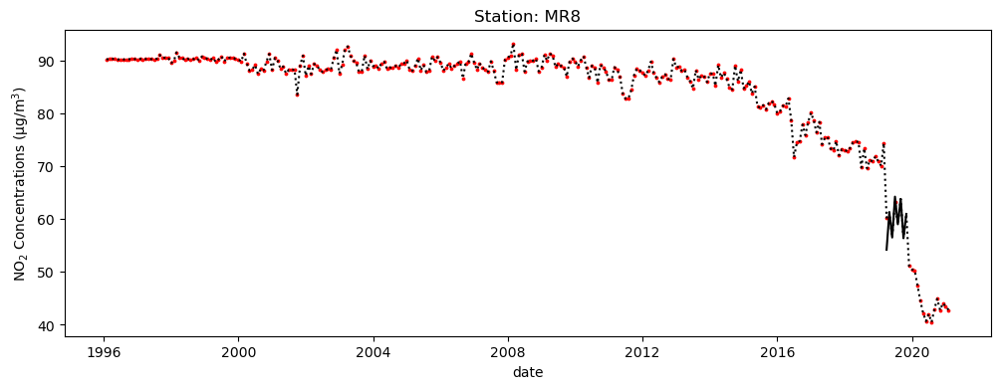

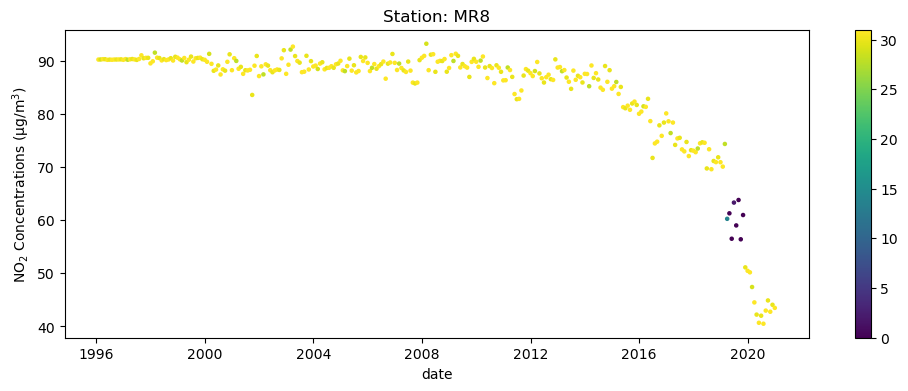

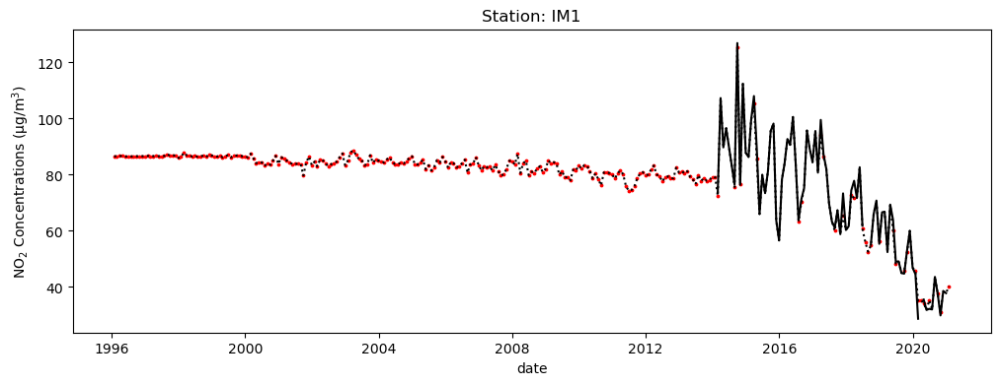

...

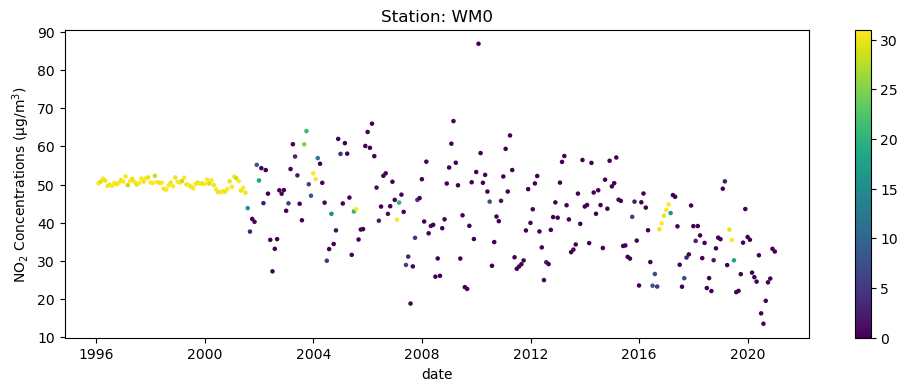

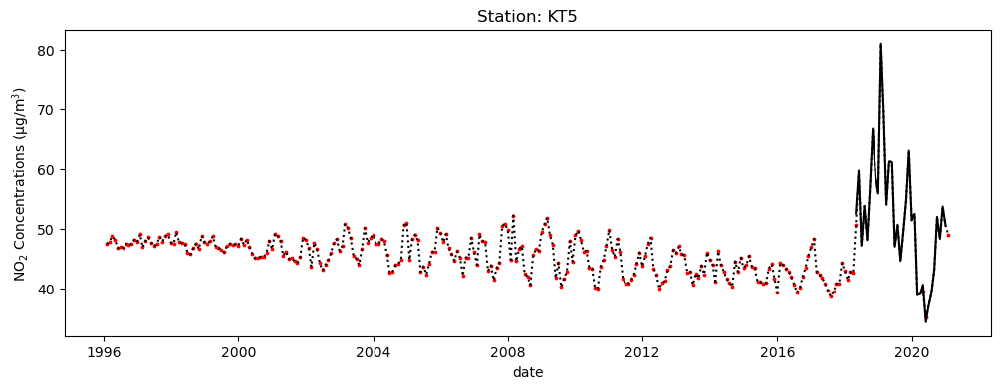

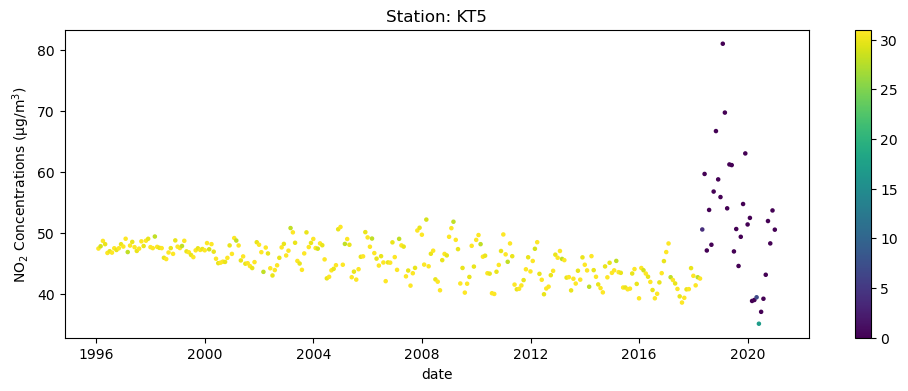

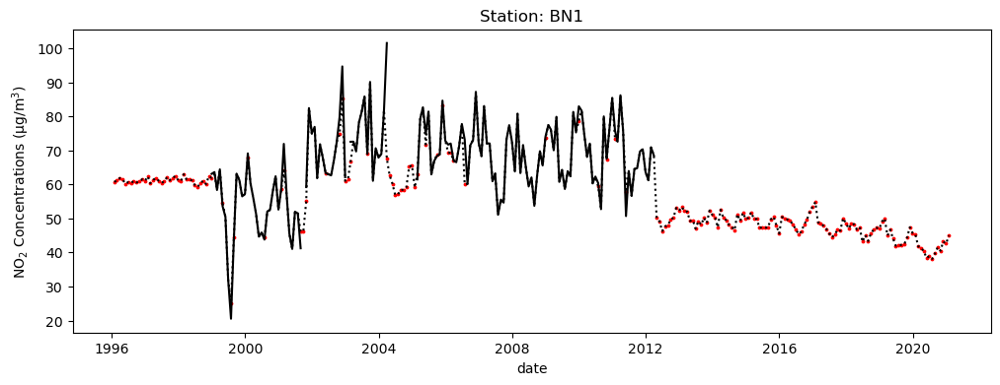

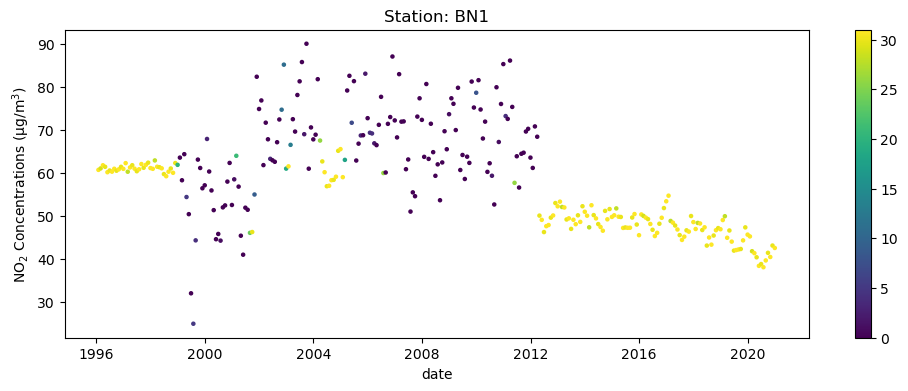

In [62]:
dates = propagated_df_M.index.values
stations = {'TD0', 'EN5', 'BN1', 'SK2', 'KC2', 'HI2'}
while len(stations) < 20:
    sample = np.random.choice(data.df.columns.values[1:], 1)[0]
    stations.add(sample)
    
for index, station in enumerate(stations):
    plt.figure(2*index, figsize=(12, 4))
    plt.plot(dates, propagated_df_M[station].values, color='black', linestyle='dotted')
    plt.plot(dates, grouped_M[station].values, color='black')
    
    missing_dates = get_missing_dates(grouped, station)
    plt.scatter(missing_dates, propagated_df_M[station][missing_dates].values, marker='o', color='r', s = 3.0)
    
    plt.title(f'Station: {station}')
    plt.xlabel('date', fontsize=10)
    plt.ylabel('NO$_{2}$ Concentrations (µg/m$^3$)', fontsize=10)
    
    plt.figure(2*index+1, figsize=(12, 4))
    plt.scatter(dates, propagated_df_M[station].values, c=miss_count[station].values, marker='o', s=5.0, cmap='viridis')
    plt.title(f'Station: {station}')
    plt.xlabel('date', fontsize=10)
    plt.ylabel('NO$_{2}$ Concentrations (µg/m$^3$)', fontsize=10)
    plt.colorbar()

### Borough Plots

In [63]:
grouped

,TD0,BG3,BG1,BG2,BN2,BN3,BN1,BX5,BX2,BQ7,...,MY1,WM6,WMZ,WMB,CE1,NB1,WM8,WM9,VS1,CE2
date,,,,,,,,,,,,,,,,,,,,,
1996-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-01-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-01-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1996-01-05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-28,NaN,NaN,24.366667,27.545833,NaN,NaN,NaN,NaN,22.212500,20.458333,...,33.345833,39.875000,NaN,35.991667,NaN,42.279167,NaN,NaN,NaN,35.054167
2020-12-29,NaN,NaN,17.800000,21.562500,NaN,NaN,NaN,NaN,21.145833,20.295833,...,28.591667,38.141667,NaN,31.900000,NaN,35.045833,NaN,NaN,NaN,31.183333
2020-12-30,NaN,NaN,43.995833,37.029167,NaN,NaN,NaN,NaN,38.704167,39.708333,...,51.679167,54.275000,NaN,45.766667,56.890909,51.512500,NaN,NaN,NaN,44.250000


In [64]:
prop_cycle = [x['color'] for x in plt.rcParams['axes.prop_cycle']]

/var/folders/vx/67v_mlvx5n7064mfs84dyd900000gn/T/ipykernel_57409/240888620.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10, 4))


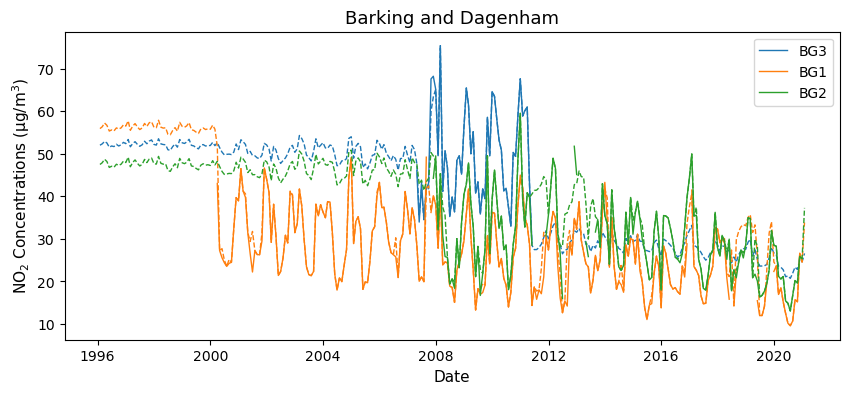

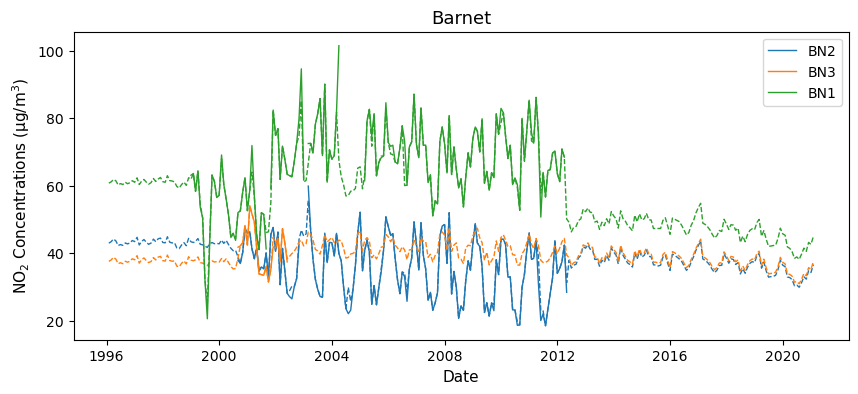

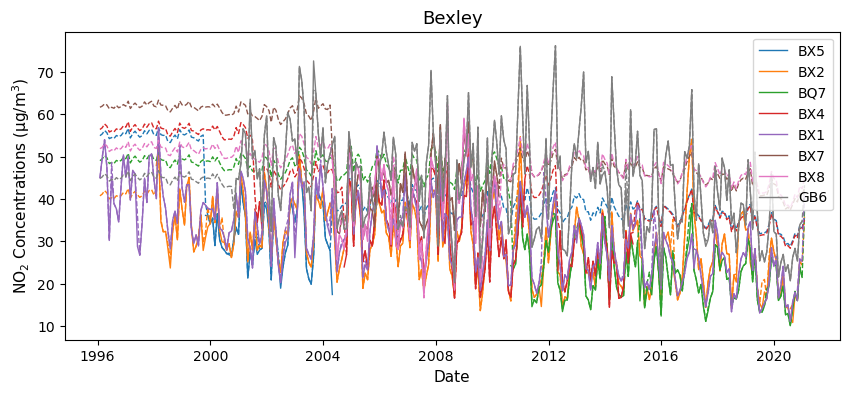

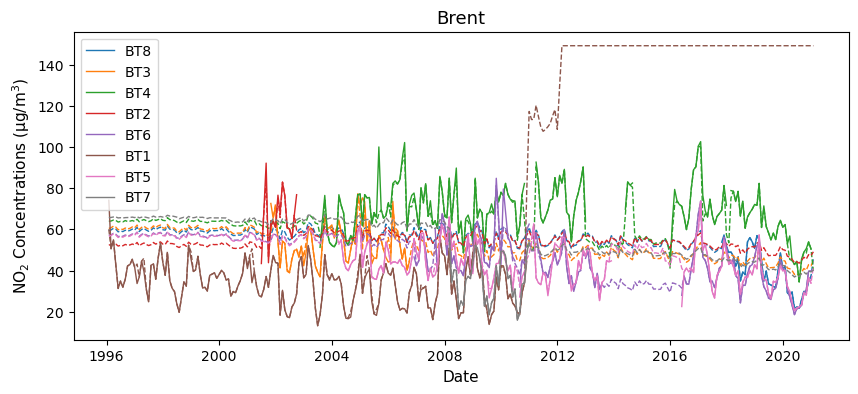

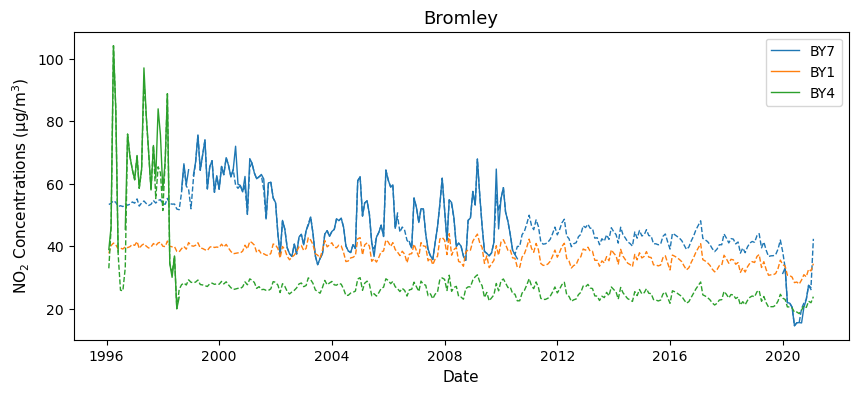

...

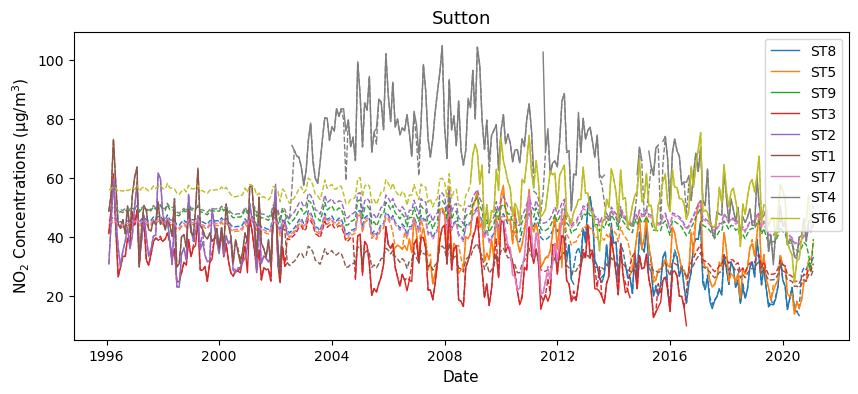

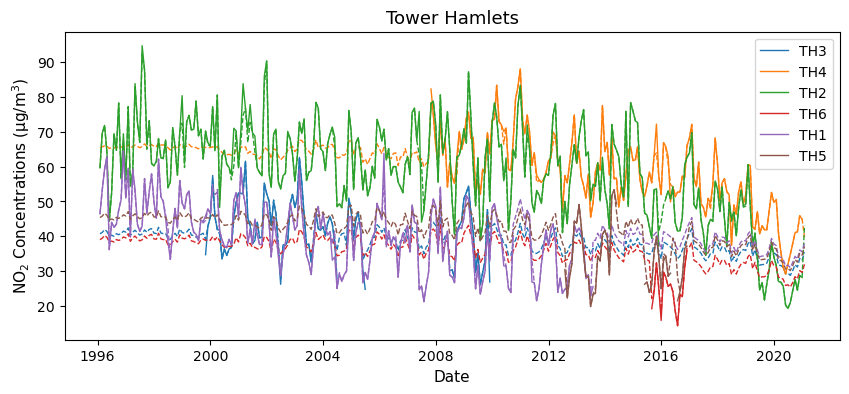

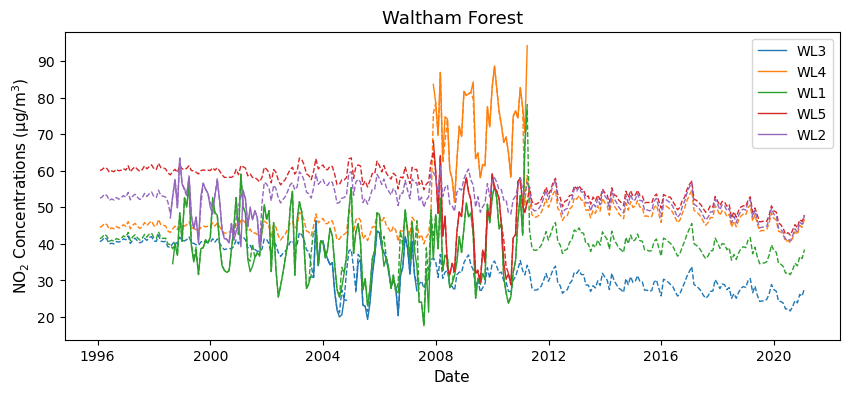

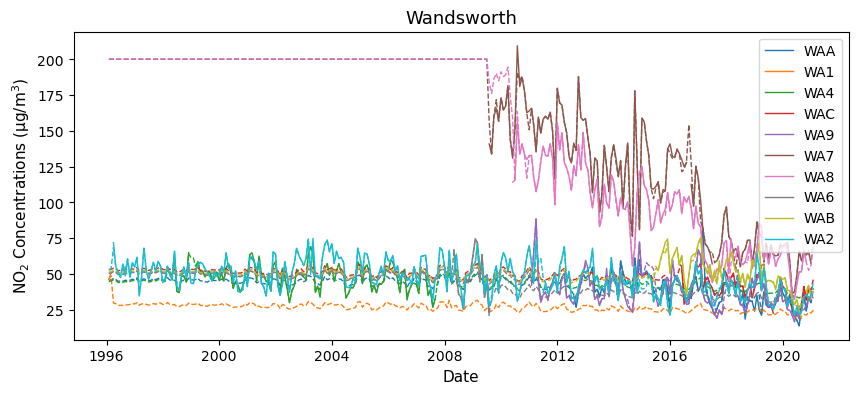

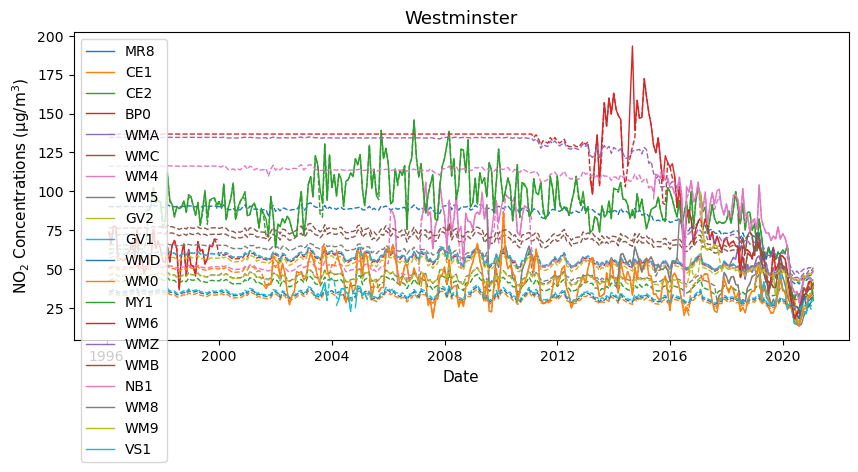

In [65]:
dates = propagated_df_M.index.values
for i in range(1, 34):
    code = str(i)
    cols = [site for site in site_map[code] if site in propagated_df_M.columns]
#     for col in cols
    plt.figure(figsize=(10, 4))
    for j, col in enumerate(cols):
        color = prop_cycle[j % len(prop_cycle)]
        plt.plot(dates, grouped_M[col].values, color=color, label=f'{col}', linewidth=1)
        plt.plot(dates, propagated_df_M[col].values, color=color, linestyle='dashed', linewidth=1)
    plt.title(f'{location_map[code]}', fontsize=13)
    plt.ylabel("NO$_{2}$ Concentrations (µg/m$^3$)", fontsize=11)
    plt.xlabel("Date", fontsize=11)
    plt.legend()
    
    #     ax = propagated_df_M[cols].plot(figsize=(10, 4), title=f'{location_map[code]}', fontsize=5)
#     ax.set_title(f'{location_map[code]}', fontsize=13)
#     ax.set_ylabel("NO$_{2}$ Concentrations (µg/m$^3$)", fontsize=11)
#     ax.set_xlabel("Date", fontsize=11)
#     ax.tick_params(axis='both', which='major', labelsize=9.5)

/var/folders/vx/67v_mlvx5n7064mfs84dyd900000gn/T/ipykernel_57409/1958224028.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10, 4))


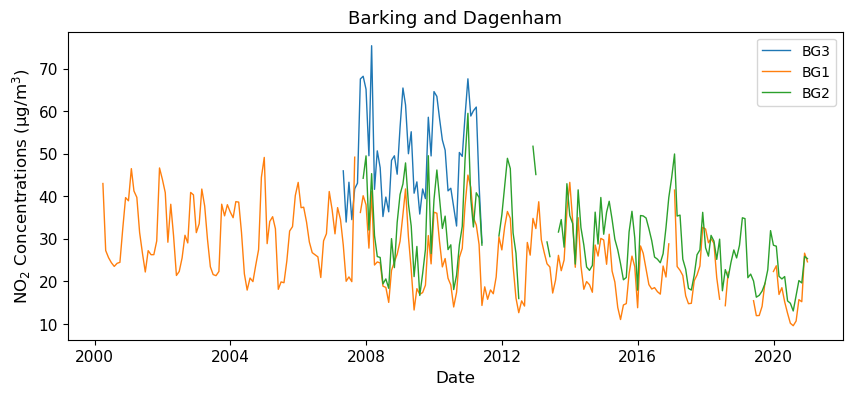

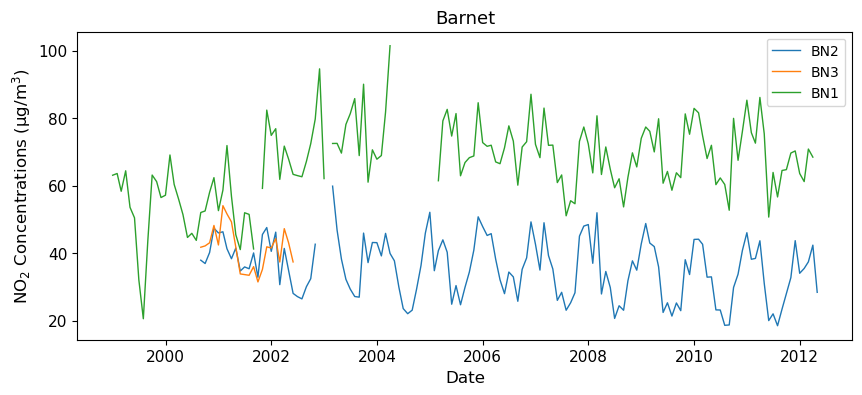

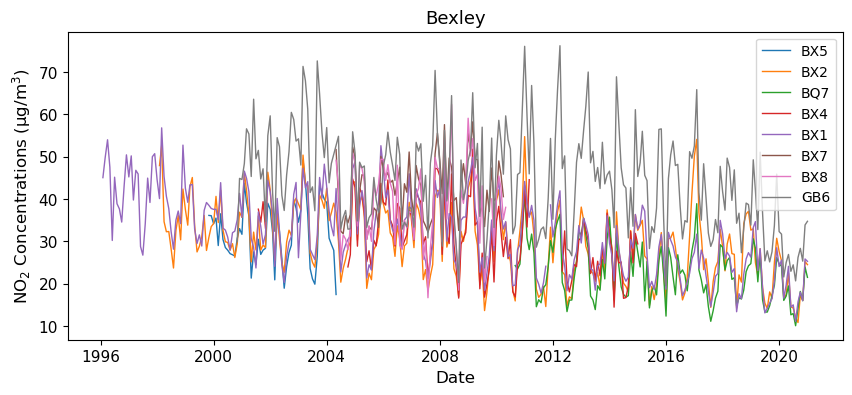

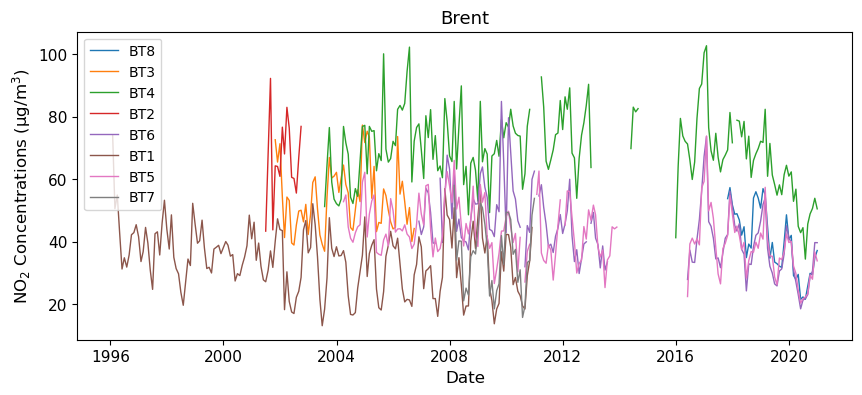

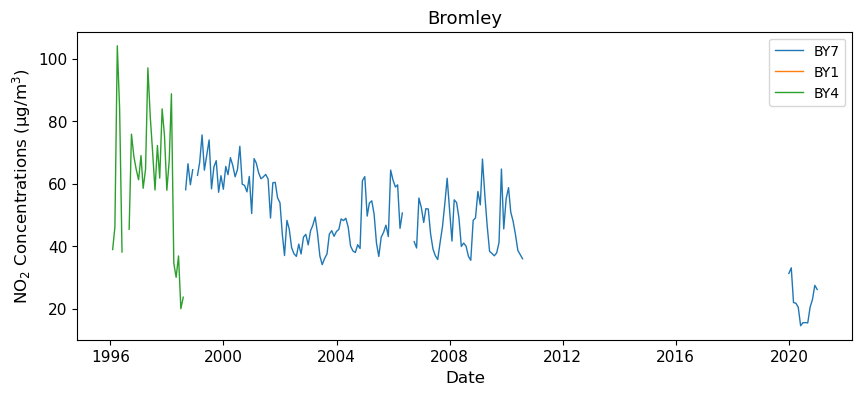

...

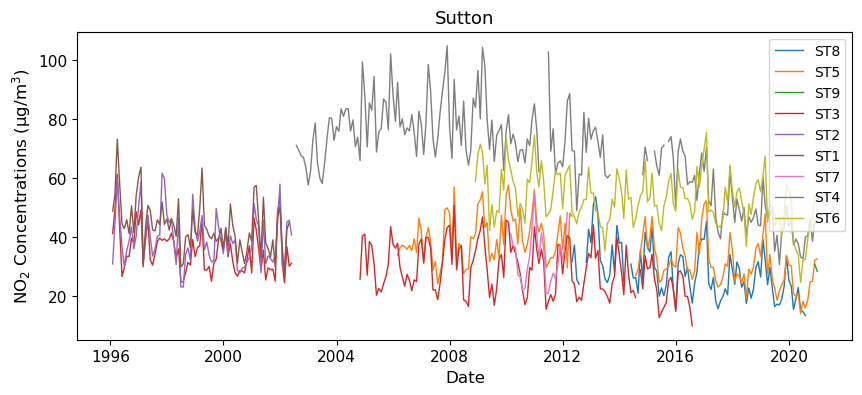

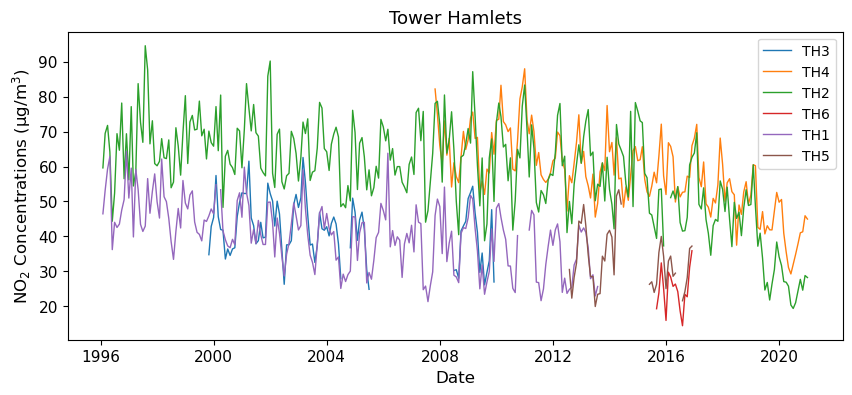

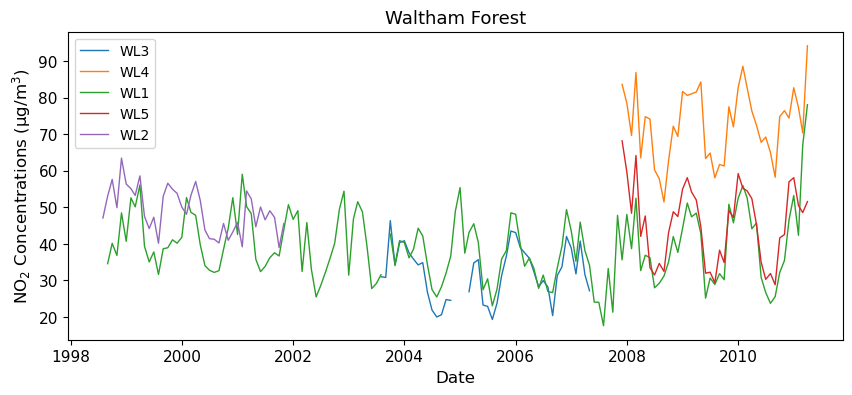

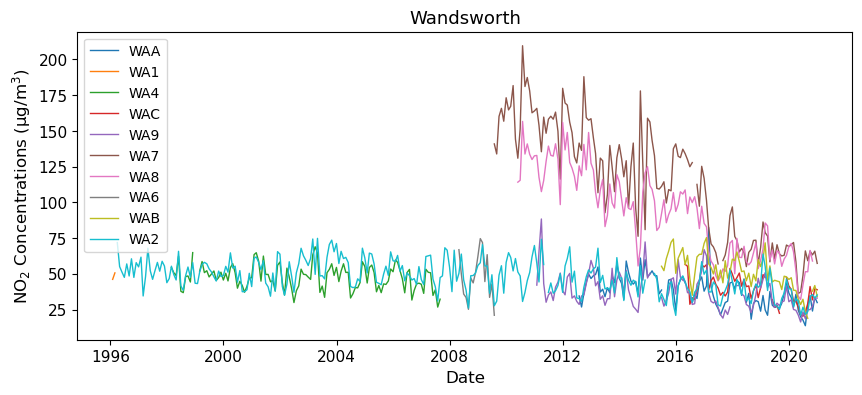

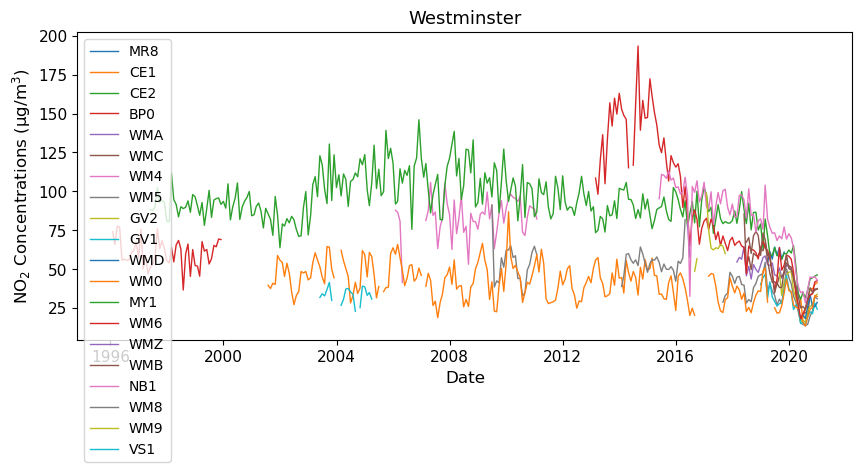

In [66]:
dates = propagated_df_M.index.values
for i in range(1, 34):
    code = str(i)
    cols = [site for site in site_map[code] if site in propagated_df_M.columns]
#     for col in cols
    plt.figure(figsize=(10, 4))
    for j, col in enumerate(cols):
        color = prop_cycle[j % len(prop_cycle)]
        plt.plot(dates, grouped_M[col].values, color=color, label=f'{col}', linewidth=1)
#         plt.plot(dates, propagated_df_M[col].values, color=color, linestyle='dashed', linewidth=1)
    plt.title(f'{location_map[code]}', fontsize=13)
    plt.ylabel("NO$_{2}$ Concentrations (µg/m$^3$)", fontsize=12)
    plt.xlabel("Date", fontsize=12)
    plt.xticks(fontsize=11)
    plt.yticks(fontsize=11)
    plt.legend()

### Similar Station Plots

In [67]:
similar_stations = {}
for station in A.columns:
    similar_stations[station] = similarity[station].sort_values(ascending=False)[:5].index.tolist()

/var/folders/vx/67v_mlvx5n7064mfs84dyd900000gn/T/ipykernel_57409/1018447428.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(i, figsize=(12, 4))


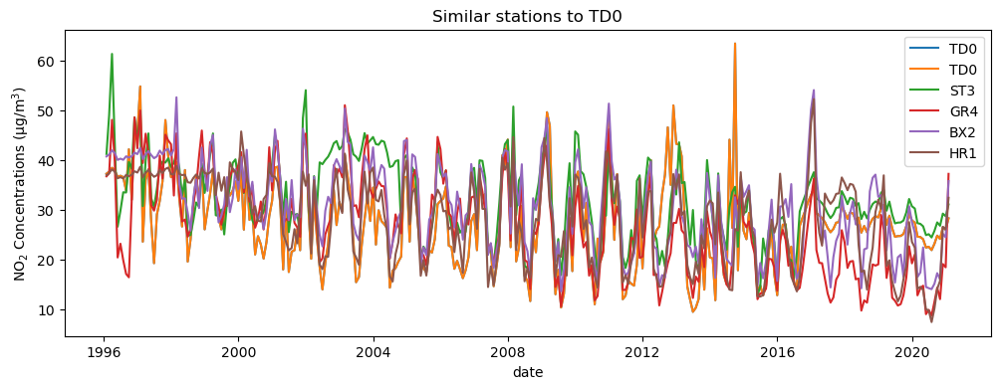

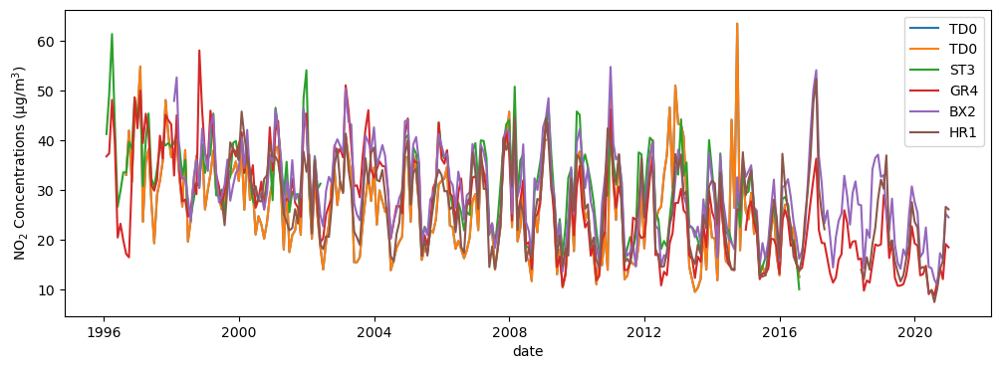

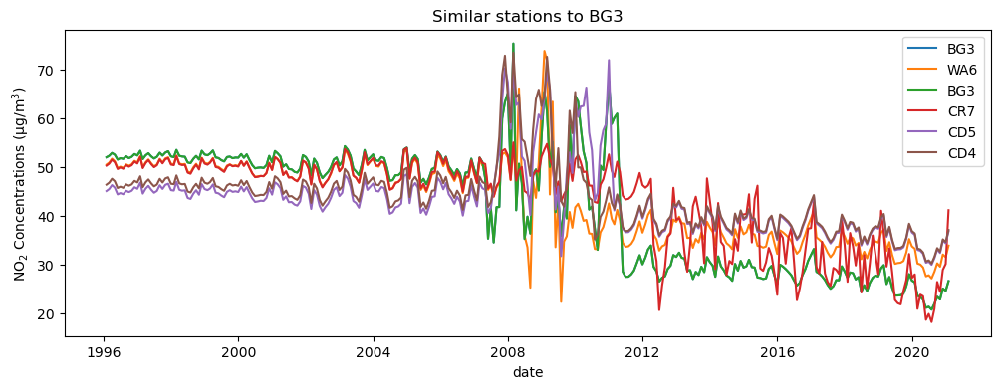

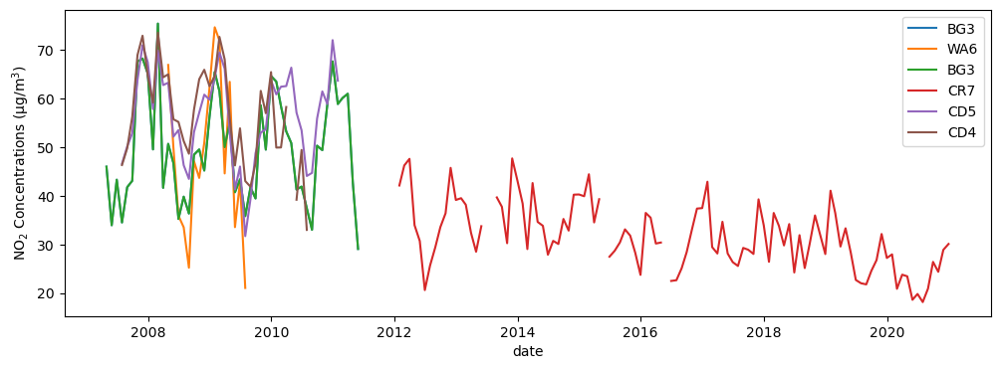

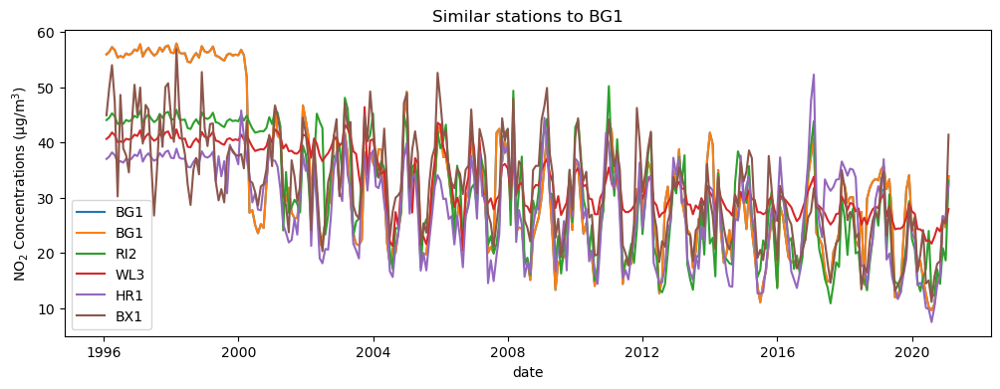

...

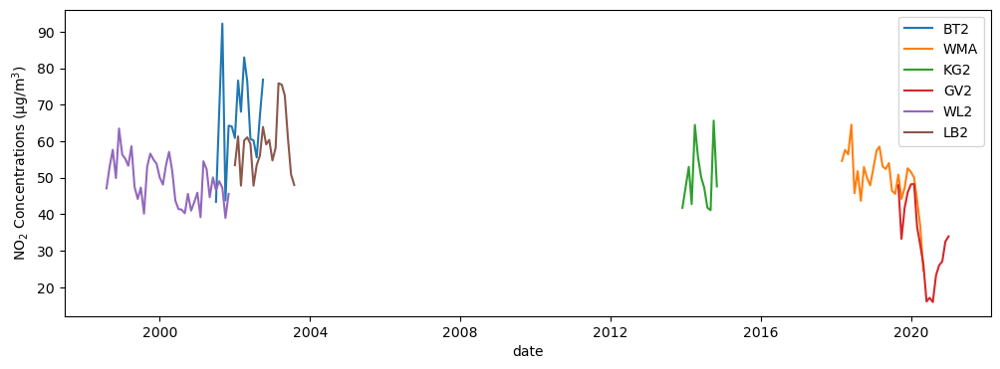

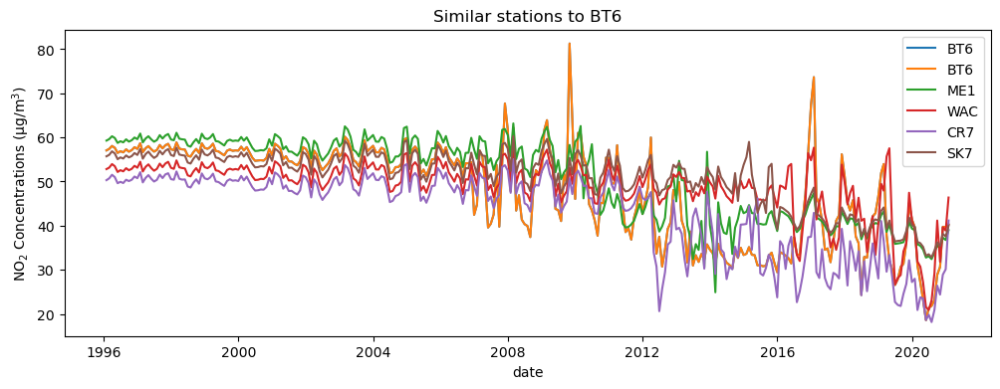

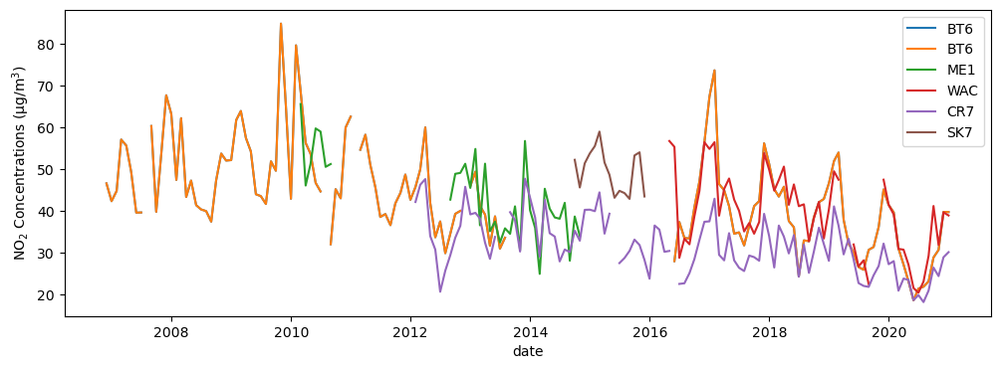

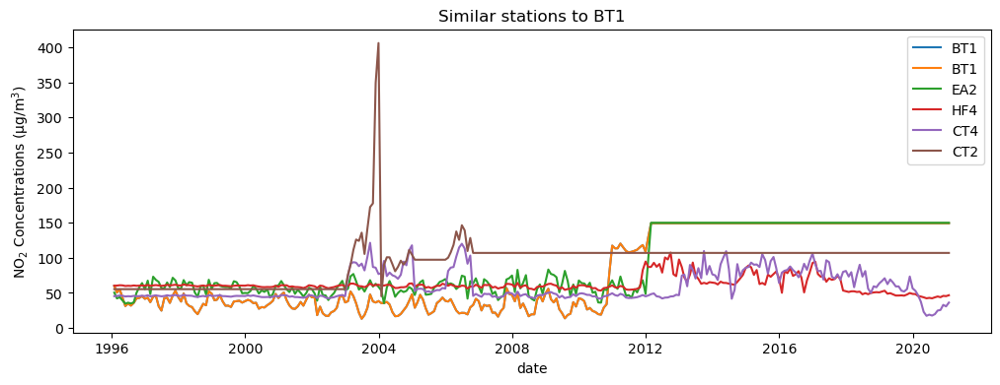

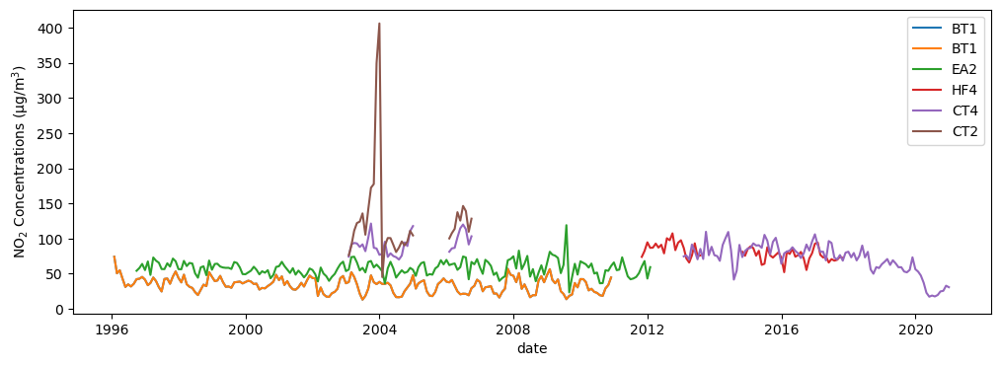

In [68]:
colour_cycle = prop_cycle = [x['color'] for x in plt.rcParams['axes.prop_cycle']]
plotted_stations = set()

i = 0
for station, similars in similar_stations.items():
    plotted_stations.add(station)
    
    plt.figure(i, figsize=(12, 4))
    plt.plot(dates, propagated_df_M[station].values, label=station, color=colour_cycle[0])
    for j, similar in enumerate(similars):
        plt.plot(dates, propagated_df_M[similar].values, label=similar, color=colour_cycle[j+1])
    plt.title(f'Similar stations to {station}')
    plt.xlabel('date', fontsize=10)
    plt.ylabel('NO$_{2}$ Concentrations (µg/m$^3$)', fontsize=10)
    plt.legend()
    
    plt.figure(i+1, figsize=(12, 4))
    plt.plot(dates, grouped_M[station].values, label=station, color=colour_cycle[0])
    for j, similar in enumerate(similars):
        plt.plot(dates, grouped_M[similar].values, label=similar, color=colour_cycle[j+1])
    plt.xlabel('date', fontsize=10)
    plt.ylabel('NO$_{2}$ Concentrations (µg/m$^3$)', fontsize=10)
    plt.legend()
    
    i += 2
    if i == 40:
        break

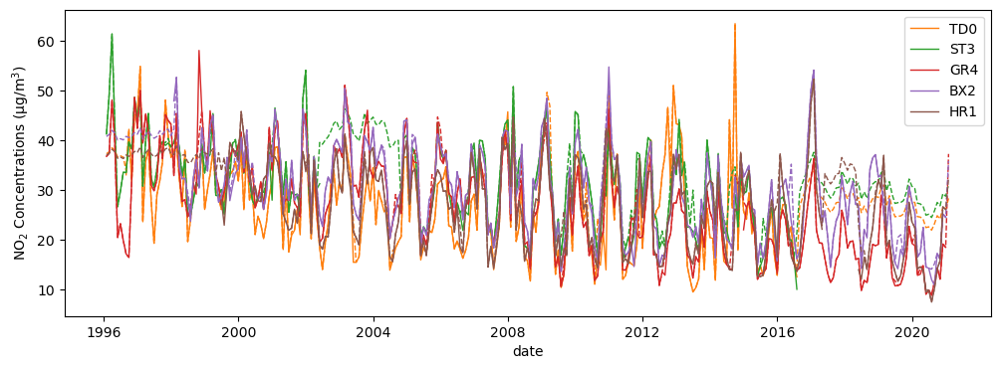

<Figure size 640x480 with 0 Axes>

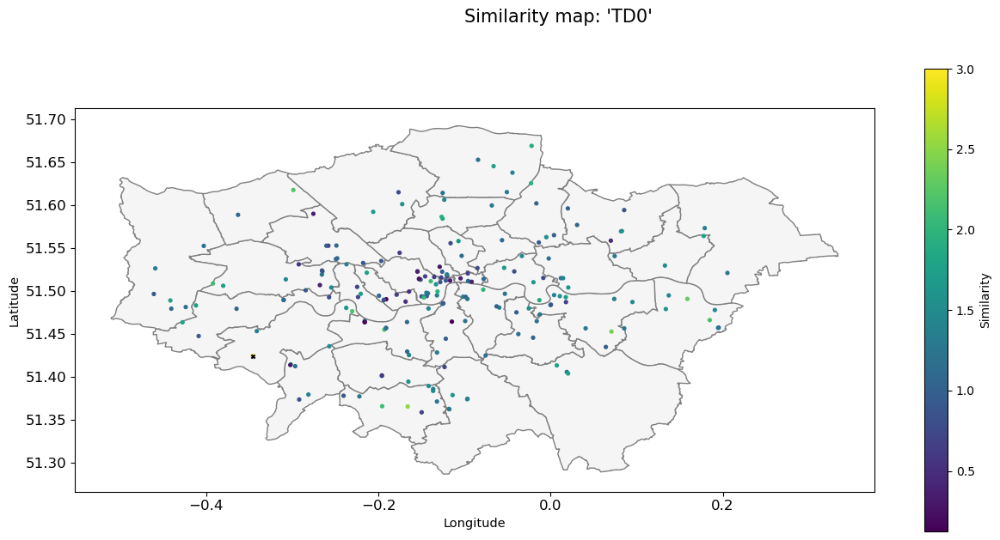

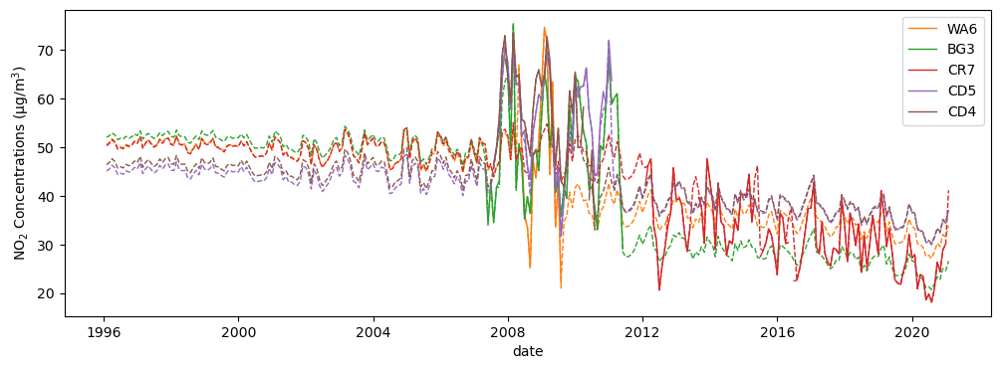

<Figure size 640x480 with 0 Axes>

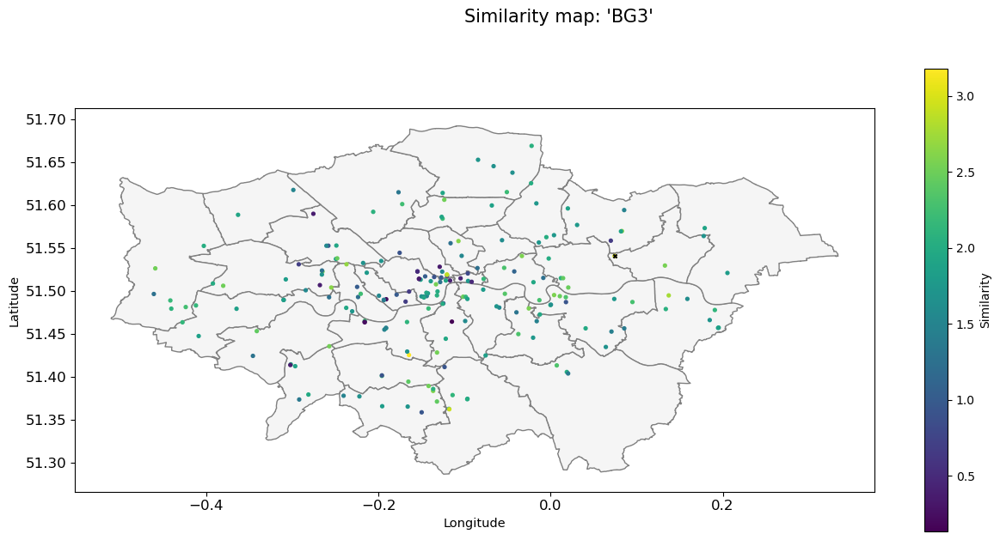

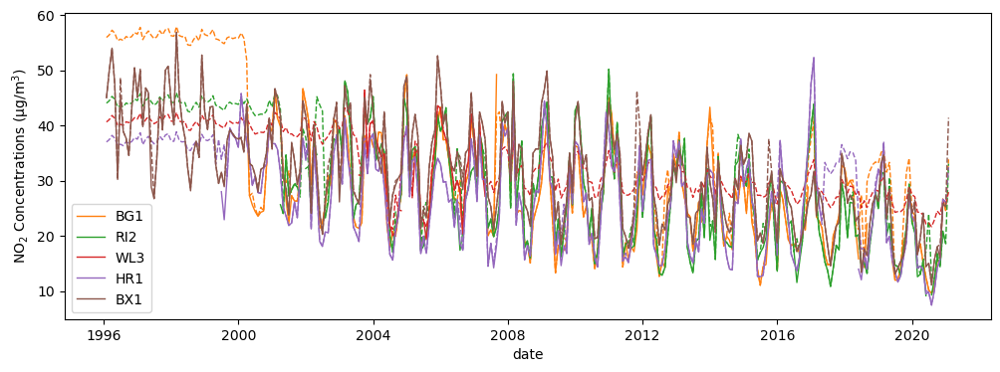

<Figure size 640x480 with 0 Axes>

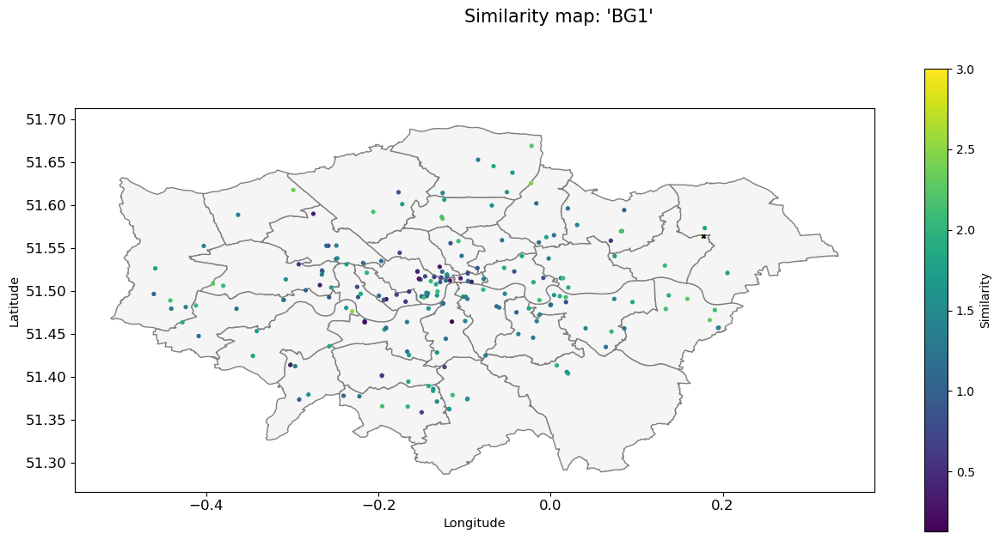

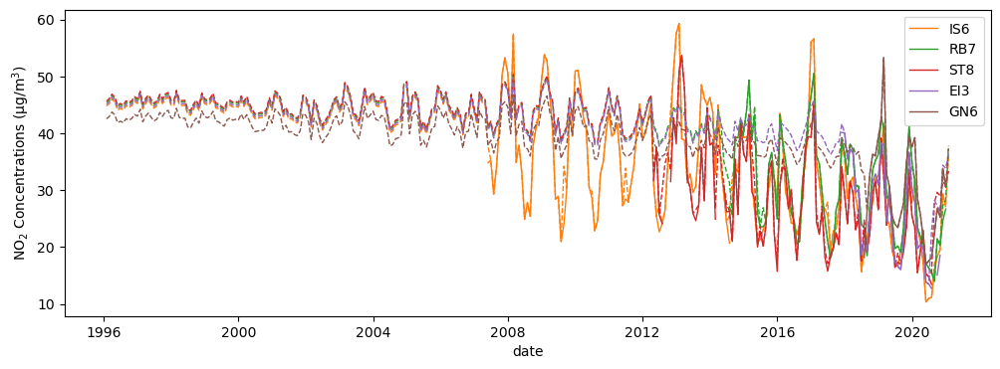

<Figure size 640x480 with 0 Axes>

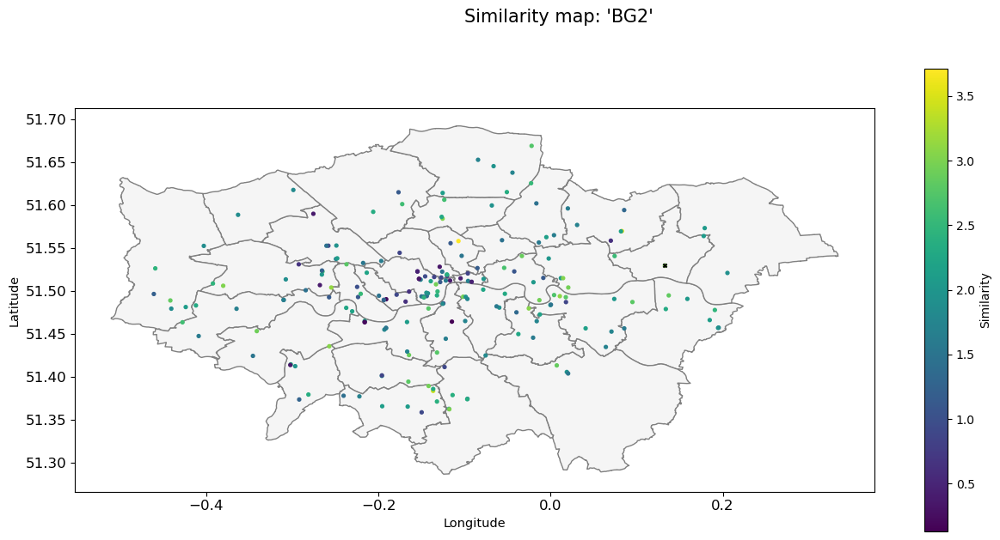

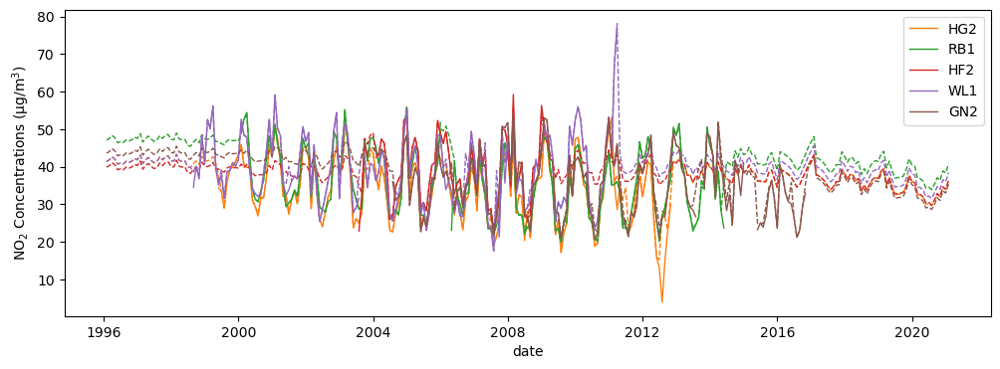

<Figure size 640x480 with 0 Axes>

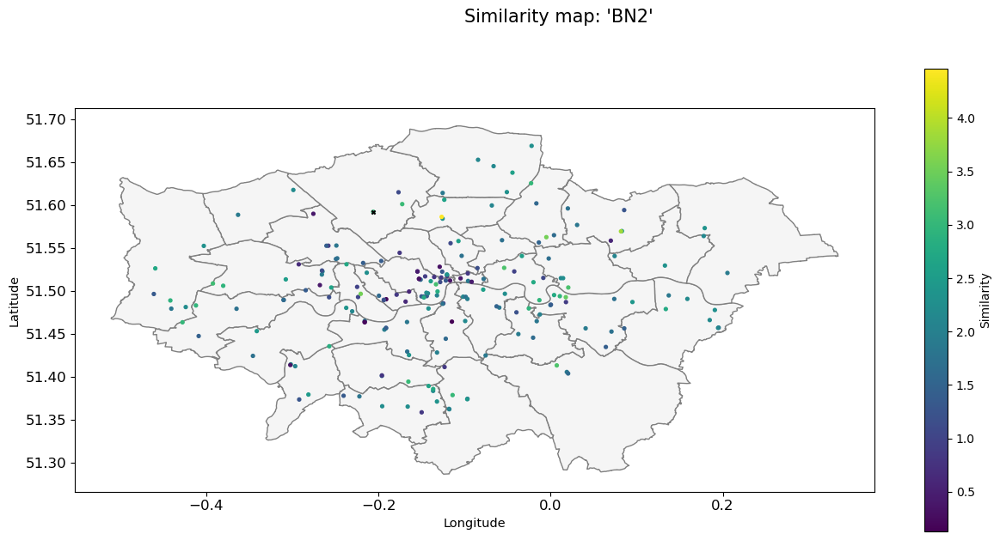

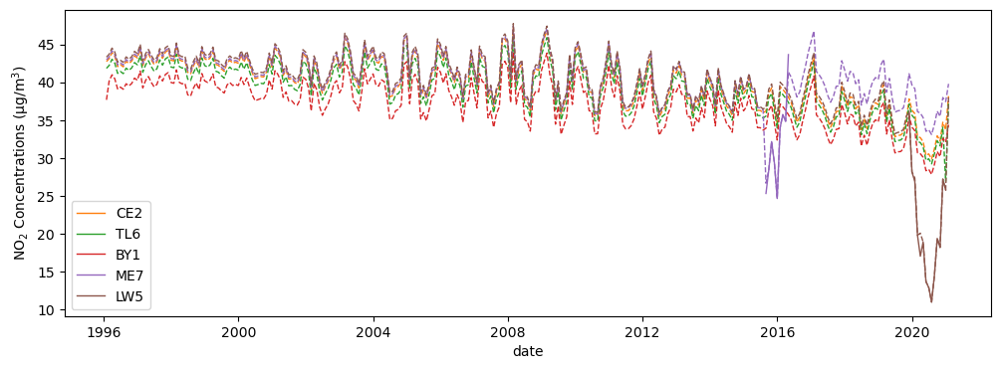

<Figure size 640x480 with 0 Axes>

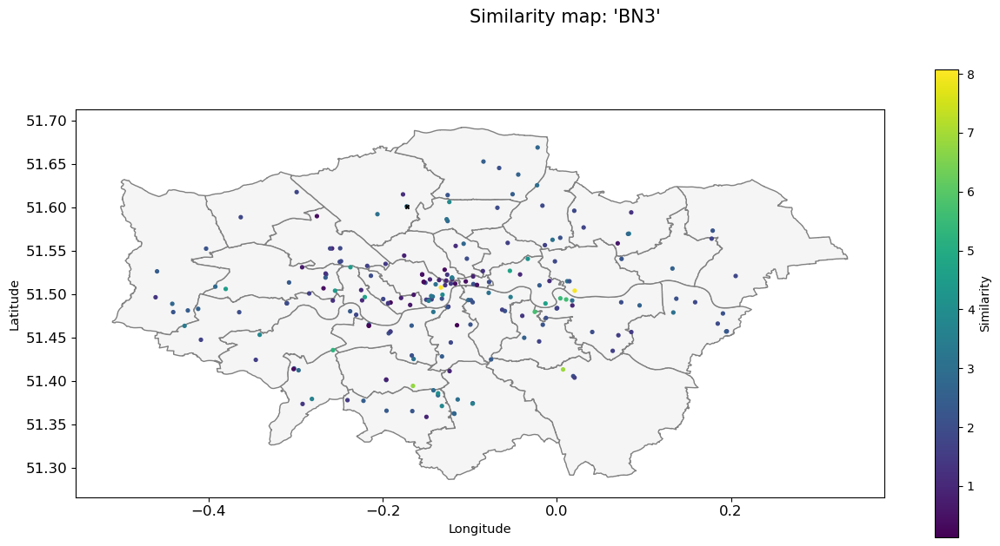

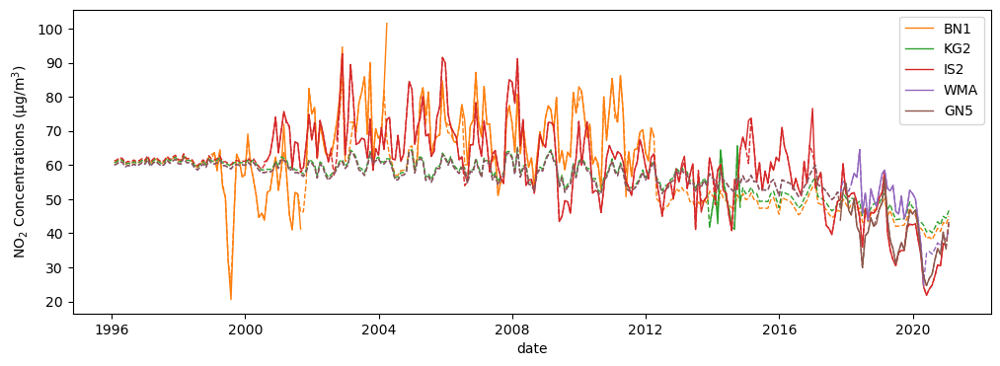

<Figure size 640x480 with 0 Axes>

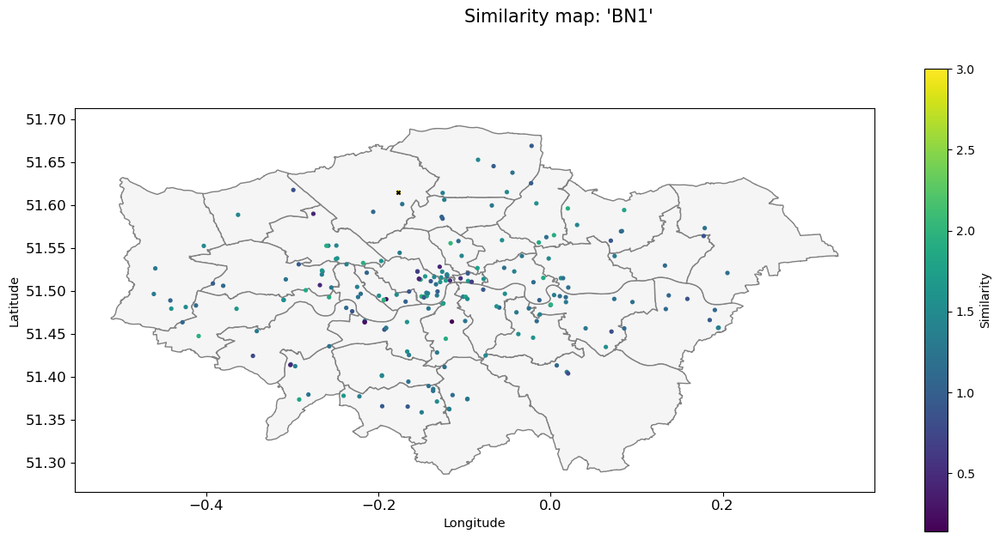

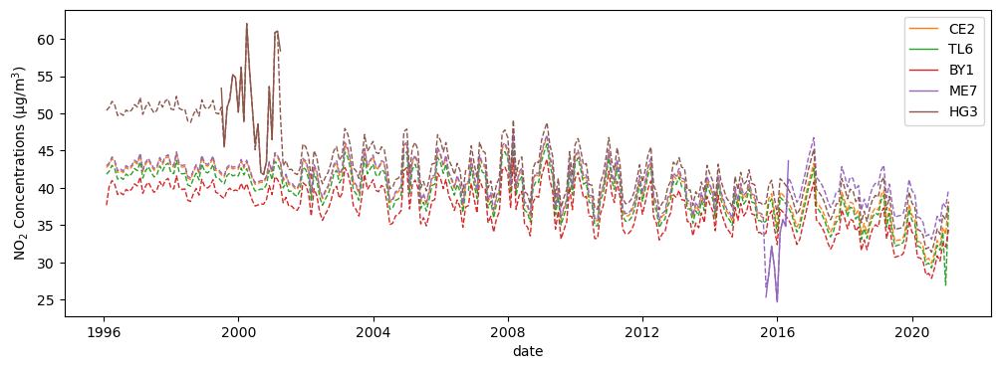

<Figure size 640x480 with 0 Axes>

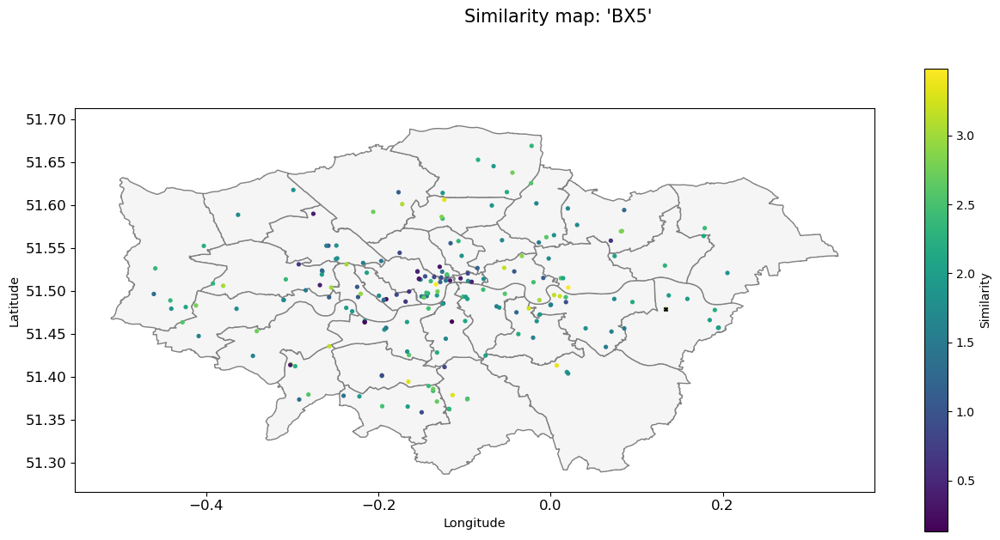

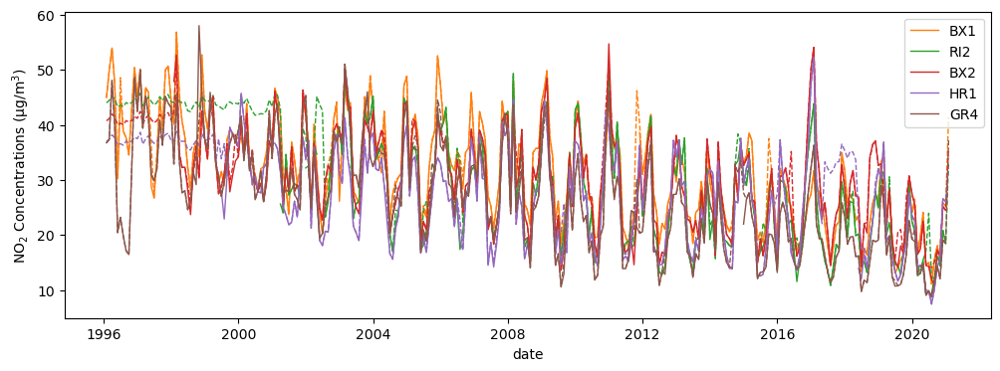

<Figure size 640x480 with 0 Axes>

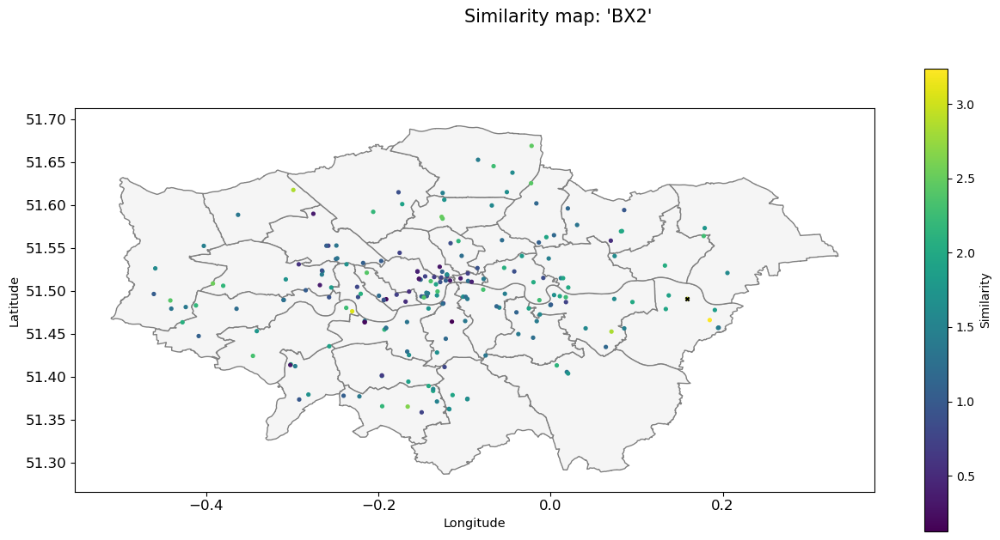

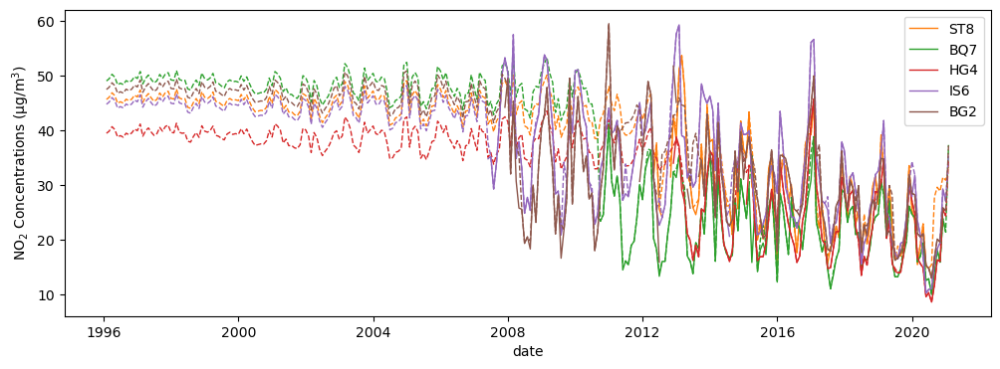

<Figure size 640x480 with 0 Axes>

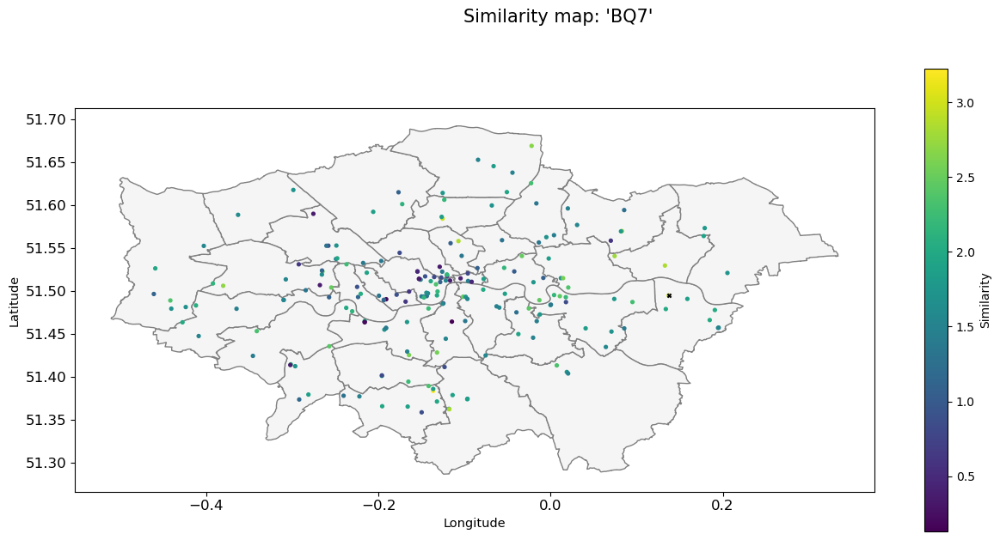

In [74]:
colour_cycle = prop_cycle = [x['color'] for x in plt.rcParams['axes.prop_cycle']]
plotted_stations = set()

i = 0
for station, similars in similar_stations.items():
    plotted_stations.add(station)
    
    plt.figure(i, figsize=(12, 4))
#     plt.plot(dates, grouped_M[station].values, color=colour_cycle[0], label=f'{station}', linewidth=1)
#     plt.plot(dates, propagated_df_M[station].values, color=colour_cycle[0], linestyle='dashed', linewidth=1)
    for j, similar in enumerate(similars):
        plt.plot(dates, grouped_M[similar].values, color=colour_cycle[j+1], label=f'{similar}', linewidth=1)
        plt.plot(dates, propagated_df_M[similar].values, color=colour_cycle[j+1], linestyle='dashed', linewidth=1)
#         plt.plot(dates, propagated_df_M[similar].values, label=similar, color=colour_cycle[j+1])
#     plt.title(f"Stations similar to: '{station}'")
    plt.xlabel('date', fontsize=10)
    plt.ylabel('NO$_{2}$ Concentrations (µg/m$^3$)', fontsize=10)
    plt.legend()
    
    plt.figure(i+1)
    similarity_list = similarity[station]
    london_sites_gdf_sim = london_sites_gdf.copy()
    london_sites_gdf_sim['Similarity'] = np.nan
    for index, sim_val in similarity_list.items():
        london_sites_gdf_sim.loc[london_sites_gdf_sim['@SiteCode'] == index, 'Similarity'] = sim_val
    london_sites_gdf_sim = london_sites_gdf_sim[~london_sites_gdf_sim['Similarity'].isna()]

    plot_on_map(london_sites_gdf_sim, london_boroughs_gdf, data_column='Similarity', colorbar=True,
                title=f"Similarity map: '{station}'", 
                data_markersize_factor=0.5, fontsize=15,
                map_edge_color="gray", figsize=(15,7), axis="on", mark=station)
    
    
    i += 2
    if i == 20:
        break

## Plot similar stations on land use map 

In [75]:
# Load LAQN metadata
london_landuse = gpd.read_file(path.join(folder, "gis_osm_landuse_a_free_1.shp"))
print(london_landuse.shape)

DriverError: /Users/michellewan/Library/CloudStorage/OneDrive-UniversityofCambridge/Documents/PhD/MEng_Kevin/Data and code/Andrea_data/shape_files/london_boroughs/gis_osm_landuse_a_free_1.shp: No such file or directory

In [ ]:
london_landuse

In [ ]:
london_landuse.plot(figsize=(10,10), column='fclass', legend=True, legend_kwds={'loc': 'center right', 'bbox_to_anchor':(1.3,0.5)})
plt.title('Greater London Land-use Map')

In [76]:
land_palette = {
    'allotments': '#002fff',
    'cemetery': 'gray',
    'commercial': 'orange',
    'farmland': '#002fff',
    'farmyard': '#002fff',
    'forest': 'green',
    'grass': 'green',
    'heath': 'green',
    'industrial': '#4B0092',
    'meadow': 'green',
    'military': '#4B0092',
    'nature_reserve': 'green',
    'orchard': 'pink',
    'park': 'green',
    'quarry': 'gray',
    'recreation_ground': 'green',
    'residential': '#E3E3E3',
    'retail': 'orange',
    'scrub': 'green',
}
cmap = matplotlib.colors.ListedColormap([color for key, color in land_palette.items()])

london_landuse.plot(figsize=(10,10), column='fclass', legend=True, cmap=cmap, legend_kwds={'loc': 'center right', 'bbox_to_anchor':(1.3,0.5)})
plt.title('Greater London Land-use Map')

NameError: name 'london_landuse' is not defined

In [77]:
def plot_on_osm_map(data_geodataframe, map_geodataframe, cmap, figsize=(20,10), colorbar=False, data_column='Similarity', title='LAQN Monitoring Station Distribution', mark=None, similars=None):
    
    base = data_geodataframe.plot(ax=map_geodataframe.plot(figsize=figsize, 
                                           column='fclass',
                                           legend=False,
                                           cmap=cmap,
                                           alpha=0.5,
                                           legend_kwds={'loc': 'center right', 'bbox_to_anchor':(1.3,0.5)}),
                    color='black', marker='x', markersize=75, linewidths=3)
    
    if colorbar:
        colorbar_max = data_geodataframe[data_column].max()
        norm = plt.Normalize(data_geodataframe[data_column].min(), colorbar_max)
        plt.colorbar(plt.cm.ScalarMappable(cmap=None, 
        norm=norm)).set_label(data_column)
        
    if mark:
        marked = data_geodataframe[data_geodataframe['@SiteCode'] == mark]
        marked.plot(ax=base, marker='o', color='black', markersize=100);

    if mark and similar:
        title = f'{title}\n Similar stations: {similars}'
    
    plt.suptitle(title, fontsize=20)
    plt.xlabel('Longitude', fontsize=14)
    plt.ylabel('Latitude', fontsize=14)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.axis("on")
    plt.savefig(f'images/{mark}_similarity.png')
    plt.show()
    

In [78]:
similarity.max().max()

28.761103300378036

In [ ]:
# # Get similarity maps

# for station, similars in similar_stations.items():
#     similarity_list = similarity[station]
#     london_sites_gdf_sim = london_sites_gdf.copy()
#     london_sites_gdf_sim['Similarity'] = np.nan
#     for index, sim_val in similarity_list.items():  
#         #ensure current station is most similar
#         if index == station:
#             london_sites_gdf_sim.loc[london_sites_gdf_sim['@SiteCode'] == index, 'Similarity'] = 100
#         else:
#             london_sites_gdf_sim.loc[london_sites_gdf_sim['@SiteCode'] == index, 'Similarity'] = sim_val
        
#     london_sites_gdf_sim = london_sites_gdf_sim[~london_sites_gdf_sim['Similarity'].isna()]
    
#     # MAP N MOST SIMILAR STATIONS
# #     data_count=10
# #     london_sites_gdf_sim = london_sites_gdf_sim.sort_values(by='Similarity', ascending=False)[:data_count]
    
#     # ... OR MAP STATIONS > 0.9*MAX
#     max_similarity = london_sites_gdf_sim.sort_values(by='Similarity', ascending=False).iloc[1]['Similarity']
#     london_sites_gdf_sim = london_sites_gdf_sim.loc[(london_sites_gdf_sim['Similarity'] >= 0.9*max_similarity)]
      
#     similars = london_sites_gdf_sim['@SiteCode'].values
#     similars = np.setdiff1d(similars, station)
#     plot_on_osm_map(london_sites_gdf_sim[:11], london_landuse, cmap, mark=station, title=f'LAQN NO$_2$ Dataset - Station {station}', similars=similars[:10])

### Tests

In [ ]:
# Find stations in common: WA7 == WA8, LB4, KC5, WM6 == WMZ, NB1

stations = ['CD4', 'CD5', 'WA7', 'WA8', 'WM6', 'WMZ', 'CD9', 'KT3', 'NB1']
for i in stations:
    test = london_sites_gdf[london_sites_gdf['@SiteCode'] == i]
    plot_on_osm_map(test, london_landuse, cmap, title = i)

In [ ]:
np.mean(similarity).sort_values(ascending=True)[:20]

In [ ]:
similar_stations

In [ ]:
# count of similar stations over all stations
similar_station_count = {}

for station in A.columns:
    data_count = 10
    similars = similarity[station].sort_values(ascending=False)[:data_count].index.tolist()
    
    if station == 'TD0':
        print(similars)
    
    for i in similars:
        if i not in similar_station_count:
            similar_station_count[i] = 0
        similar_station_count[i] += 1

In [ ]:
similar_station_count

In [ ]:
grouped

In [ ]:
stations = ['CD4', 'CD5']
grouped[stations].to_csv('random.csv')